<a href="https://colab.research.google.com/github/Julian981012/Segundo-Proyecto/blob/main/Proyecto1_corregido_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<p><img alt="udeA logo" height="150px" src="https://github.com/freddyduitama/images/blob/master/logo.png?raw=true" align="left" hspace="50px" vspace="0px" style="width:107px;height:152px;"></p>
<h1><font color='0B5345'> <center>
Bioseñales y Sistemas </center></font></h1>
<h2><font color='0B5345'> <center>
Primer Proyecto Semestral  </center></font></h2>
<h4><font color='0B5345'>
<center></center>
<center>Julian Olaya-Melissa Cadavid</center>
</font></h4>

<font  face="Courier New" size="3">
<p1><center> </center></p1>



<p3><center><b><font color='0B5345' face="Lucida Calligraphy,Comic Sans MS,Lucida Console" size="5">Universidad de Antioquia</font></b> </center></p3>
</font>

Electromiografía: El EMG es un estudio sobre conducción nerviosa que busca medir la actividad eléctrica que hay en los músculos y los nervios, este estudio mide principalmente la rápidez y la eficacia con que las señales eléctricas se transmiten por el nervio, mostrando si hay un daño o problema muscular y/o nervioso.

Se caracteriza por:

Regustrar la actividad eléctrica de los músculos durante contracción y reposo. Se puede realizar de dos formas diferentes, la primera es colocar electrodos sobre el músculo de interes por encima de la piel, la segunda es con electrodos de aguja que se incertan directamente en el músculo, en este caso el procedimiento es invasivo. En algunos estudios de EMG se aplican estímulos eléctricos a los nervios para evaluar que este funcionando de forma correcta o si presenta algún daño.

OPERADOR TKEO El operador de transformadas de Energía de Káiser (TKEO), se utiliza generalmente en el procesamiento de señales para estimar las características de frecuencia de una señal, esta técnica suele utilizarse para señales no estacionarias como lo es la EMG(las señales estudiadas en este proyecto), suele utilizarse para leer este tipo de señales ya que es muy sensible a los cambios bruscos de energía como los que suelen darse por las contracciones musculares, también puede amplificar componentes de alta frecuencia de la señal, lo que suele servir para identificar la fatiga muscular.

El TKEO se calcula con la señal de entrada, a la cual se le hace una diferenciación y suavizado, con el fin de que se pueda resaltar los picos de la actividad muscular.

Para interpretar estos resultados es necesario caracterizar la actividad muscular en diferentes situaciones, para esto se observa los puntos donde la magnitud de la señal es máxima que representan los instantes en los que la actividad muscular es más pronunciada, unos niveles altos de TKEO significa alta actividad muscular, si son bajos, entonces hay menor actividad muscular, cuando hay un aumento repentino, puede significar que hay una contracción muscular, y cuando hay una disminución gradual, significa que hay fatiga muscular.

In [ ]:
import os
import pandas as pd
from google.colab import drive
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import shapiro, levene, mannwhitneyu

In [ ]:

# Montar Google Drive
drive.mount('/content/drive')

# Ruta de la carpeta principal
main_folder = '/content/drive/My Drive/EMG_data_for_gestures-master'

# Función para leer los archivos txt y organizar los datos por gesto
def procesar_archivo(archivo):
    # Leer el archivo txt en un dataframe
    df = pd.read_csv(archivo, delimiter='\t')

    # Eliminar filas con valores NaN en la columna 'class'
    df = df.dropna(subset=['class'])

    # Organizar los datos por gesto
    gestos = {}
    for gesto in df['class'].unique():
        gestos[int(gesto)] = df[df['class'] == gesto].drop(columns=['class'])

    return gestos

# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Buscar archivos txt que empiezan con "1_raw_data"
        archivos = [f for f in os.listdir(sujeto_path) if f.startswith("1_raw_data") and f.endswith(".txt")]

        # Mostrar el sujeto actual
        print(f"\nSujeto {sujeto}:")

        # Procesar cada archivo encontrado
        for archivo in archivos:
            archivo_path = os.path.join(sujeto_path, archivo)
            gestos = procesar_archivo(archivo_path)

            # Mostrar los dataframes por cada gesto en orden numérico
            for gesto in sorted(gestos.keys()):
                print(f"\nGesto {gesto}:")
                display(gestos[gesto])

Mounted at /content/drive

Sujeto 01:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00001,-0.00002,-0.00001,-0.00003,0.00000,-0.00001,0.00000,-0.00001
1,5,0.00001,-0.00002,-0.00001,-0.00003,0.00000,-0.00001,0.00000,-0.00001
2,6,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001
3,7,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001
4,8,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001
...,...,...,...,...,...,...,...,...,...
63191,65657,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004
63192,65658,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004
63193,65659,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004
63194,65660,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2287,2400,-0.00001,0.00000,-0.00001,0.00000,0.00000,-0.00001,-0.00001,0.00001
2288,2401,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002
2289,2402,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002
2290,2403,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002
2291,2404,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002
...,...,...,...,...,...,...,...,...,...
35393,36736,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000
35394,36738,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000
35395,36739,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000
35396,36740,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6424,6662,-0.00011,-0.00002,-0.00007,-0.00008,-0.00016,-0.00018,-0.00036,-0.00001
6425,6663,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006
6426,6664,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006
6427,6665,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006
6428,6666,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006
...,...,...,...,...,...,...,...,...,...
38748,40240,0.00015,-0.00005,0.00002,-0.00010,-0.00018,-0.00015,0.00013,0.00018
38749,40241,-0.00013,0.00001,0.00004,-0.00008,0.00012,0.00014,-0.00018,-0.00004
38750,40242,-0.00003,0.00006,0.00002,0.00002,-0.00001,0.00000,-0.00021,-0.00002
38751,40243,-0.00003,0.00006,0.00002,0.00002,-0.00001,0.00000,-0.00021,-0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12534,12967,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007
12535,12968,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007
12536,12970,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007
12537,12971,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007
12538,12972,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007
...,...,...,...,...,...,...,...,...,...
44572,46280,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023
44573,46281,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023
44574,46282,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023
44575,46283,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17995,18614,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010
17996,18615,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010
17997,18616,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010
17998,18617,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010
17999,18618,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010
...,...,...,...,...,...,...,...,...,...
50026,51905,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004
50027,51906,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004
50028,51907,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004
50029,51908,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23545,24358,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001
23546,24359,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001
23547,24360,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001
23548,24361,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001
23549,24362,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001
...,...,...,...,...,...,...,...,...,...
55613,57696,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002
55614,57697,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002
55615,57698,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002
55616,57699,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28883,29926,0.00005,-0.00013,0.00004,-0.00005,0.00005,0.00009,0.00011,0.00040
28884,29927,0.00009,-0.00014,-0.00019,-0.00029,-0.00050,-0.00038,0.00003,0.00014
28885,29929,-0.00032,-0.00025,-0.00006,0.00013,0.00028,0.00011,-0.00020,0.00009
28886,29930,0.00026,0.00003,-0.00004,-0.00006,-0.00011,-0.00013,-0.00015,0.00006
28887,29931,0.00026,0.00003,-0.00004,-0.00006,-0.00011,-0.00013,-0.00015,0.00006
...,...,...,...,...,...,...,...,...,...
61574,63912,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005
61575,63913,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005
61576,63914,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005
61577,63915,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005



Sujeto 02:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002
1,4,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002
2,5,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002
3,6,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002
4,7,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002
...,...,...,...,...,...,...,...,...,...
72317,74521,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001
72318,74522,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001
72319,74523,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001
72320,74524,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2755,2856,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002
2756,2857,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002
2757,2858,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002
2758,2859,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002
2759,2860,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002
...,...,...,...,...,...,...,...,...,...
44268,45592,-0.00001,-0.00001,0.00000,0.00001,0.00007,-0.00004,-0.00001,-0.00001
44269,45593,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003
44270,45594,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003
44271,45595,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6122,6318,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001
6123,6319,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001
6124,6320,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001
6125,6321,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001
6126,6322,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001
...,...,...,...,...,...,...,...,...,...
47641,49056,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001
47642,49057,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001
47643,49058,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001
47644,49059,0.00004,0.00001,0.00002,0.00004,0.00007,0.00030,-0.00004,0.00003



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12412,12798,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027
12413,12799,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027
12414,12800,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027
12415,12801,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027
12416,12802,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027
...,...,...,...,...,...,...,...,...,...
53480,55081,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032
53481,55082,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032
53482,55083,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032
53483,55084,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19029,19599,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003
19030,19600,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003
19031,19601,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003
19032,19602,0.00013,0.00024,0.00048,0.00041,0.00103,0.00046,0.00022,0.00016
19033,19603,0.00013,0.00024,0.00048,0.00041,0.00103,0.00046,0.00022,0.00016
...,...,...,...,...,...,...,...,...,...
59314,61081,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003
59315,61082,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003
59316,61083,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003
59317,61084,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25152,25910,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004
25153,25911,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004
25154,25912,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004
25155,25913,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004
25156,25914,0.00004,0.00004,0.00007,-0.00068,0.00009,0.00000,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
65105,67080,-0.00005,-0.00012,0.00000,0.00067,0.00010,0.00001,-0.00002,-0.00003
65106,67081,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001
65107,67082,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001
65108,67083,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
37501,38615,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004
37502,38616,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004
37503,38617,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004
37504,38618,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004
37505,38619,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004
...,...,...,...,...,...,...,...,...,...
70733,72873,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020
70734,72874,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020
70735,72875,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020
70736,72876,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020



Sujeto 03:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00005,0.00000,-0.00005,-0.00002,-0.00001,-0.00002,-0.00002
1,5,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001
2,6,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001
3,7,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001
4,8,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001
...,...,...,...,...,...,...,...,...,...
56563,58768,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004
56564,58769,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004
56565,58770,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004
56566,58771,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1668,1783,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001
1669,1784,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001
1670,1785,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001
1671,1787,0.00001,-0.00006,-0.00006,-0.00006,-0.00003,-0.00001,-0.00001,0.00001
1672,1790,0.00001,-0.00006,-0.00006,-0.00006,-0.00003,-0.00001,-0.00001,0.00001
...,...,...,...,...,...,...,...,...,...
32031,33303,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000
32032,33304,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000
32033,33305,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000
32034,33306,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5158,5446,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025
5159,5447,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025
5160,5448,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025
5161,5449,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025
5162,5450,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025
...,...,...,...,...,...,...,...,...,...
35318,36712,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001
35319,36713,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001
35320,36714,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001
35321,36715,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10991,11534,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037
10992,11535,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037
10993,11536,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037
10994,11539,-0.00003,0.00066,0.00020,0.00009,0.00019,-0.00010,-0.00014,-0.00014
10995,11540,-0.00003,0.00066,0.00020,0.00009,0.00019,-0.00010,-0.00014,-0.00014
...,...,...,...,...,...,...,...,...,...
40423,42008,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011
40424,42009,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011
40425,42010,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011
40426,42011,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16364,17094,0.00000,0.00004,0.00010,-0.00011,-0.00008,0.00076,0.00046,0.00010
16365,17095,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027
16366,17096,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027
16367,17097,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027
16368,17098,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027
...,...,...,...,...,...,...,...,...,...
45888,47672,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004
45889,47673,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004
45890,47674,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004
45891,47675,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21670,22583,0.00029,0.00053,0.00011,0.00015,0.00034,0.00030,0.00015,0.00005
21671,22584,-0.00016,-0.00089,-0.00006,0.00010,0.00025,-0.00004,-0.00002,-0.00011
21672,22585,-0.00014,0.00017,-0.00014,-0.00027,0.00044,0.00004,-0.00008,-0.00007
21673,22586,0.00001,0.00007,-0.00002,-0.00023,-0.00039,-0.00019,-0.00011,-0.00007
21674,22588,0.00001,0.00007,-0.00002,-0.00023,-0.00039,-0.00019,-0.00011,-0.00007
...,...,...,...,...,...,...,...,...,...
51053,53040,0.00006,0.00021,0.00003,-0.00019,0.00058,0.00032,0.00006,0.00006
51054,53041,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002
51055,53042,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002
51056,53043,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26348,27422,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002
26349,27423,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002
26350,27424,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002
26351,27425,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002
26352,27426,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002
...,...,...,...,...,...,...,...,...,...
55628,57776,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001
55629,57777,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001
55630,57778,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001
55631,57779,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001



Sujeto 04:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000
1,3,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000
2,4,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000
3,5,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000
4,6,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000
...,...,...,...,...,...,...,...,...,...
59102,61057,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001
59103,61058,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001
59104,61059,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001
59105,61060,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
763,777,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003
764,778,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003
765,779,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003
766,780,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003
767,781,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003
...,...,...,...,...,...,...,...,...,...
32228,33298,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002
32229,33299,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002
32230,33300,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002
32231,33301,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4045,4161,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009
4046,4162,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009
4047,4163,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009
4048,4164,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009
4049,4165,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009
...,...,...,...,...,...,...,...,...,...
35924,37112,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004
35925,37113,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004
35926,37114,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004
35927,37115,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
9070,9338,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034
9071,9339,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034
9072,9340,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034
9073,9341,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034
9074,9342,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034
...,...,...,...,...,...,...,...,...,...
41655,43046,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004
41656,43047,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004
41657,43048,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004
41658,43049,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
14568,15033,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003
14569,15034,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003
14570,15035,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003
14571,15036,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003
14572,15038,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003
...,...,...,...,...,...,...,...,...,...
47543,49119,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033
47544,49120,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033
47545,49121,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033
47546,49122,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19795,20469,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003
19796,20470,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003
19797,20471,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003
19798,20472,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003
19799,20473,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003
...,...,...,...,...,...,...,...,...,...
52747,54495,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017
52748,54496,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017
52749,54497,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017
52750,54498,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25667,26533,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052
25668,26534,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052
25669,26535,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052
25670,26536,0.00058,0.00025,0.00002,0.00016,0.00007,0.00023,0.00022,0.00035
25671,26538,0.00006,-0.00005,-0.00005,0.00007,0.00036,0.00027,0.00015,-0.00002
...,...,...,...,...,...,...,...,...,...
57704,59613,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011
57705,59614,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011
57706,59615,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011
57707,59616,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011



Sujeto 05:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001
1,4,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001
2,6,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001
3,8,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001
4,9,-0.00001,0.00001,0.00000,-0.00002,-0.00001,0.00001,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
57113,59040,-0.00003,0.00000,-0.00003,-0.00003,-0.00002,-0.00001,0.00000,0.00000
57114,59041,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002
57115,59043,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002
57116,59044,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
983,1047,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002
984,1048,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002
985,1049,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002
986,1050,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002
987,1051,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002
...,...,...,...,...,...,...,...,...,...
32181,33257,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000
32182,33258,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000
32183,33259,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000
32184,33260,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4809,5015,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014
4810,5016,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014
4811,5017,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014
4812,5018,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014
4813,5019,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014
...,...,...,...,...,...,...,...,...,...
35528,36721,0.00004,0.00003,0.00003,0.00006,0.00000,-0.00022,-0.00033,-0.00018
35529,36722,0.00004,0.00003,0.00003,0.00006,0.00000,-0.00022,-0.00033,-0.00018
35530,36723,0.00008,0.00004,-0.00002,-0.00002,0.00008,0.00015,0.00014,0.00005
35531,36724,0.00008,0.00004,-0.00002,-0.00002,0.00008,0.00015,0.00014,0.00005



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10785,11183,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002
10786,11184,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002
10787,11185,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002
10788,11186,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002
10789,11188,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002
...,...,...,...,...,...,...,...,...,...
41141,42505,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019
41142,42506,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019
41143,42507,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019
41144,42508,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15979,16543,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004
15980,16544,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004
15981,16545,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004
15982,16546,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004
15983,16547,-0.00003,-0.00012,-0.00021,-0.00030,-0.00012,-0.00001,-0.00014,-0.00002
...,...,...,...,...,...,...,...,...,...
46196,47752,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003
46197,47753,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003
46198,47754,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003
46199,47755,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21478,22223,-0.00008,-0.00013,0.00005,0.00035,0.00012,0.00000,-0.00006,-0.00004
21479,22224,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000
21480,22225,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000
21481,22226,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000
21482,22227,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
51094,52809,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000
51095,52810,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000
51096,52811,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000
51097,52812,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26455,27359,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016
26456,27360,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016
26457,27361,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016
26458,27362,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016
26459,27363,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016
...,...,...,...,...,...,...,...,...,...
56195,58073,0.00015,0.00004,0.00006,0.00007,0.00011,0.00065,0.00027,0.00045
56196,58074,-0.00009,-0.00003,-0.00005,-0.00005,-0.00010,0.00037,-0.00001,-0.00019
56197,58075,-0.00013,-0.00004,-0.00001,-0.00003,-0.00012,-0.00028,-0.00014,0.00009
56198,58076,-0.00030,-0.00005,-0.00003,-0.00003,-0.00028,-0.00059,-0.00026,-0.00006



Sujeto 06:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003
1,5,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003
2,6,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003
3,7,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003
4,8,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003
...,...,...,...,...,...,...,...,...,...
51073,53624,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003
51074,53625,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003
51075,53626,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003
51076,53627,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
901,968,-0.00002,0.00003,0.00001,0.00003,0.00000,-0.00003,-0.00004,-0.00001
902,969,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000
903,970,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000
904,971,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000
905,972,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
29888,31681,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001
29889,31682,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001
29890,31683,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001
29891,31684,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4372,4568,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025
4373,4569,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025
4374,4570,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025
4375,4571,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025
4376,4572,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025
...,...,...,...,...,...,...,...,...,...
33150,35025,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010
33151,35026,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010
33152,35027,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010
33153,35028,-0.00013,-0.00009,-0.00004,0.00016,0.00004,0.00000,-0.00004,-0.00031



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10141,10593,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012
10142,10594,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012
10143,10595,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012
10144,10596,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012
10145,10597,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012
...,...,...,...,...,...,...,...,...,...
38155,40210,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018
38156,40211,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018
38157,40212,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018
38158,40213,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
14336,15246,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014
14337,15247,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014
14338,15248,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014
14339,15249,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014
14340,15250,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014
...,...,...,...,...,...,...,...,...,...
42120,44345,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005
42121,44346,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005
42122,44347,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005
42123,44348,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19071,20271,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010
19072,20272,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010
19073,20273,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010
19074,20274,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010
19075,20275,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010
...,...,...,...,...,...,...,...,...,...
46406,48769,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003
46407,48770,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003
46408,48771,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003
46409,48772,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23963,25295,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054
23964,25296,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054
23965,25297,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054
23966,25298,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054
23967,25299,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054
...,...,...,...,...,...,...,...,...,...
50122,52625,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011
50123,52626,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011
50124,52627,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011
50125,52628,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011



Sujeto 07:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00005,0.00000,-0.00006,-0.00002,0.00000,0.00000,0.00000,0.00001
1,16,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001
2,17,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001
3,18,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001
4,19,0.00003,0.00000,-0.00002,0.00002,-0.00033,-0.00004,-0.00002,-0.00002
...,...,...,...,...,...,...,...,...,...
68692,70632,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001
68693,70633,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001
68694,70634,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001
68695,70635,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1948,2064,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001
1949,2065,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001
1950,2066,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001
1951,2067,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001
1952,2068,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001
...,...,...,...,...,...,...,...,...,...
37409,38465,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002
37410,38466,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002
37411,38467,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002
37412,38468,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6075,6286,-0.00039,-0.00008,-0.00006,-0.00014,-0.00002,-0.00009,-0.00002,-0.00048
6076,6287,-0.00039,-0.00008,-0.00006,-0.00014,-0.00002,-0.00009,-0.00002,-0.00048
6077,6288,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041
6078,6289,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041
6079,6290,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041
...,...,...,...,...,...,...,...,...,...
41680,42848,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007
41681,42849,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007
41682,42850,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007
41683,42851,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13034,13423,0.00000,0.00001,-0.00002,0.00013,0.00037,-0.00007,-0.00005,0.00009
13035,13424,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032
13036,13425,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032
13037,13426,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032
13038,13427,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032
...,...,...,...,...,...,...,...,...,...
47320,48625,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028
47321,48626,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028
47322,48627,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028
47323,48628,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19400,19959,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0
19401,19960,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0
19402,19961,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0
19403,19962,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0
19404,19963,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0
...,...,...,...,...,...,...,...,...,...
54149,55657,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0
54150,55658,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0
54151,55659,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0
54152,55660,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25808,26542,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008
25809,26543,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008
25810,26544,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008
25811,26545,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008
25812,26546,0.00022,-0.00012,-0.00018,-0.00051,-0.00003,0.00002,-0.00001,0.00005
...,...,...,...,...,...,...,...,...,...
60620,62313,-0.00013,-0.00011,-0.00014,-0.00021,0.00014,0.00000,0.00002,0.00033
60621,62314,-0.00013,-0.00011,-0.00014,-0.00021,0.00014,0.00000,0.00002,0.00033
60622,62315,0.00007,0.00002,0.00005,-0.00016,-0.00018,-0.00008,-0.00003,0.00023
60623,62316,0.00007,0.00002,0.00005,-0.00016,-0.00018,-0.00008,-0.00003,0.00023



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
31396,32289,0.00000,0.00000,0.00009,0.00030,-0.00005,0.00021,-0.00005,0.00001
31397,32290,0.00000,0.00000,0.00009,0.00030,-0.00005,0.00021,-0.00005,0.00001
31398,32291,0.00001,-0.00002,-0.00004,-0.00003,0.00060,0.00000,0.00022,0.00001
31399,32292,0.00001,0.00001,-0.00005,0.00040,-0.00110,-0.00022,-0.00002,0.00000
31400,32293,0.00001,0.00001,-0.00005,0.00040,-0.00110,-0.00022,-0.00002,0.00000
...,...,...,...,...,...,...,...,...,...
66614,68465,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002
66615,68466,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002
66616,68467,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002
66617,68468,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002



Sujeto 08:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001
1,4,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001
2,5,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001
3,6,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001
4,7,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
60275,62920,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001
60276,62921,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001
60277,62922,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001
60278,62923,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1898,1984,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0
1899,1985,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0
1900,1986,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0
1901,1988,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0
1902,1990,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0
...,...,...,...,...,...,...,...,...,...
35784,37329,-0.00003,-0.00007,-0.00019,-0.00019,-0.00003,0.00000,-0.00001,0.0
35785,37330,0.00000,0.00001,0.00006,0.00001,0.00001,0.00000,-0.00002,0.0
35786,37331,0.00000,-0.00002,0.00000,-0.00004,-0.00002,0.00002,0.00000,0.0
35787,37332,0.00000,-0.00002,0.00000,-0.00004,-0.00002,0.00002,0.00000,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5288,5519,-0.00007,0.00002,0.00036,0.00103,0.00030,-0.00007,-0.00126,-0.00029
5289,5520,-0.00007,0.00002,0.00036,0.00103,0.00030,-0.00007,-0.00126,-0.00029
5290,5521,0.00032,0.00014,0.00058,0.00058,-0.00003,0.00021,0.00016,-0.00017
5291,5522,0.00004,-0.00019,-0.00012,-0.00039,-0.00047,-0.00059,-0.00040,-0.00010
5292,5523,0.00004,-0.00019,-0.00012,-0.00039,-0.00047,-0.00059,-0.00040,-0.00010
...,...,...,...,...,...,...,...,...,...
39373,41073,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002
39374,41074,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002
39375,41075,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002
39376,41076,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12533,13079,0.00028,0.00007,-0.00003,0.00005,0.00006,-0.00024,-0.00021,-0.00073
12534,13080,0.00028,0.00007,-0.00003,0.00005,0.00006,-0.00024,-0.00021,-0.00073
12535,13081,-0.00057,-0.00008,-0.00006,0.00000,0.00027,0.00008,0.00027,0.00058
12536,13082,-0.00010,0.00000,0.00006,0.00010,0.00036,0.00014,0.00039,0.00041
12537,13083,-0.00010,0.00000,0.00006,0.00010,0.00036,0.00014,0.00039,0.00041
...,...,...,...,...,...,...,...,...,...
44699,46640,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001
44700,46641,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001
44701,46642,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001
44702,46643,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17684,18440,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009
17685,18441,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009
17686,18442,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009
17687,18443,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009
17688,18444,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009
...,...,...,...,...,...,...,...,...,...
49366,51513,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003
49367,51514,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003
49368,51515,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003
49369,51516,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
22652,23630,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022
22653,23631,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022
22654,23632,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022
22655,23633,-0.00009,-0.00047,-0.00115,0.00010,0.00033,-0.00027,0.00003,-0.00001
22656,23634,-0.00009,-0.00047,-0.00115,0.00010,0.00033,-0.00027,0.00003,-0.00001
...,...,...,...,...,...,...,...,...,...
54147,56512,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002
54148,56513,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002
54149,56514,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002
54150,56515,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
30282,31591,0.00002,-0.00001,-0.00002,-0.00006,0.00004,-0.00074,-0.00036,0.00044
30283,31592,0.00002,-0.00001,-0.00002,-0.00006,0.00004,-0.00074,-0.00036,0.00044
30284,31593,0.00027,0.00007,0.00006,0.00002,0.00002,0.00054,0.00011,-0.00034
30285,31594,0.00000,-0.00002,0.00003,0.00014,0.00021,0.00027,-0.00006,0.00045
30286,31595,0.00005,0.00001,-0.00003,-0.00012,-0.00022,-0.00067,0.00018,-0.00019
...,...,...,...,...,...,...,...,...,...
58604,61160,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031
58605,61161,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031
58606,61162,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031
58607,61163,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031



Sujeto 09:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002
1,5,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002
2,6,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002
3,7,-0.00001,-0.00003,-0.00005,0.00000,0.00001,-0.00004,0.00000,-0.00001
4,8,-0.00001,-0.00003,-0.00005,0.00000,0.00001,-0.00004,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
62765,65182,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002
62766,65183,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002
62767,65184,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002
62768,65185,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1155,1223,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002
1156,1224,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002
1157,1225,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002
1158,1226,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.00001,0.0,0.00001
1159,1227,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.00001,0.0,0.00001
...,...,...,...,...,...,...,...,...,...
32975,34401,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002
32976,34402,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002
32977,34403,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002
32978,34404,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4678,4895,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023
4679,4896,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023
4680,4897,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023
4681,4898,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023
4682,4899,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023
...,...,...,...,...,...,...,...,...,...
36351,37880,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004
36352,37881,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004
36353,37882,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004
36354,37883,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10477,10926,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043
10478,10927,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043
10479,10928,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043
10480,10929,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043
10481,10930,-0.00017,0.00010,0.00006,0.00003,0.00004,-0.00003,0.00022,0.00019
...,...,...,...,...,...,...,...,...,...
42385,44104,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037
42386,44105,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037
42387,44106,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037
42388,44107,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15861,16489,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006
15862,16490,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006
15863,16491,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006
15864,16492,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006
15865,16493,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006
...,...,...,...,...,...,...,...,...,...
48094,50008,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001
48095,50009,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001
48096,50010,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001
48097,50011,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21280,22126,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000
21281,22127,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000
21282,22128,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000
21283,22129,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000
21284,22130,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...
53975,56080,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003
53976,56081,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003
53977,56082,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003
53978,56083,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26904,28015,0.00002,0.00001,0.00001,0.00006,0.00015,-0.00038,0.00020,-0.00083
26905,28016,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040
26906,28017,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040
26907,28018,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040
26908,28019,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040
...,...,...,...,...,...,...,...,...,...
60224,62535,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007
60225,62536,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007
60226,62538,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007
60227,62539,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007



Sujeto 10:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2628,2767,-0.00003,0.00000,0.00000,-0.00002,0.00000,0.00000,-0.00002,-0.00002
2629,2768,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
2630,2769,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
2631,2770,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
2632,2771,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
61636,64552,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000
61637,64553,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000
61638,64554,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000
61639,64555,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001
1,5,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001
2,6,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001
3,7,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001
4,8,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001
...,...,...,...,...,...,...,...,...,...
32902,34561,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000
32903,34562,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000
32904,34563,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000
32905,34564,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4787,5014,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016
4788,5015,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016
4789,5016,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016
4790,5017,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016
4791,5018,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016
...,...,...,...,...,...,...,...,...,...
36283,38086,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001
36284,38089,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001
36285,38090,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001
36286,38091,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
9876,10351,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012
9877,10353,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012
9878,10354,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012
9879,10355,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012
9880,10356,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012
...,...,...,...,...,...,...,...,...,...
42017,44134,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001
42018,44135,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001
42019,44136,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001
42020,44139,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16125,16927,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003
16126,16928,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003
16127,16929,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003
16128,16930,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003
16129,16931,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003
...,...,...,...,...,...,...,...,...,...
47706,50113,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001
47707,50114,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001
47708,50115,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001
47709,50116,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21776,22871,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003
21777,22872,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003
21778,22873,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003
21779,22874,-0.00004,0.00014,-0.00003,0.00089,0.00109,0.00013,0.00008,0.00010
21780,22875,-0.00007,-0.00014,-0.00005,0.00025,0.00008,-0.00007,-0.00014,-0.00011
...,...,...,...,...,...,...,...,...,...
53300,55881,0.00005,-0.00004,0.00009,-0.00053,0.00010,-0.00036,0.00015,0.00004
53301,55882,0.00007,0.00004,0.00003,-0.00019,0.00022,0.00007,-0.00007,0.00000
53302,55883,0.00029,0.00002,-0.00003,0.00019,0.00081,0.00027,-0.00002,0.00005
53303,55884,0.00029,0.00002,-0.00003,0.00019,0.00081,0.00027,-0.00002,0.00005



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26931,28290,0.00005,0.00003,0.00003,0.00010,0.00023,0.00055,0.00024,0.00022
26932,28291,0.00000,-0.00001,0.00000,0.00009,0.00024,0.00006,-0.00002,0.00001
26933,28292,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034
26934,28293,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034
26935,28294,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034
...,...,...,...,...,...,...,...,...,...
58841,61625,0.00000,0.00004,0.00003,0.00008,0.00021,-0.00005,0.00002,0.00027
58842,61626,-0.00007,-0.00006,-0.00009,-0.00013,0.00007,0.00013,-0.00008,-0.00017
58843,61627,-0.00002,-0.00003,-0.00005,0.00001,0.00010,0.00025,-0.00004,0.00006
58844,61628,0.00000,-0.00003,-0.00003,-0.00008,-0.00016,0.00002,-0.00013,0.00022



Sujeto 11:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002
1,6,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002
2,7,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002
3,8,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002
4,9,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002
...,...,...,...,...,...,...,...,...,...
74676,77081,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002
74677,77082,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002
74678,77083,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002
74679,77084,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1869,1976,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001
1870,1977,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001
1871,1978,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001
1872,1979,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001
1873,1980,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
39814,41113,-0.00001,-0.00003,0.00001,0.00000,-0.00001,0.00001,-0.00001,0.00000
39815,41114,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000
39816,41115,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000
39817,41116,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5800,6031,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004
5801,6032,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004
5802,6033,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004
5803,6034,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004
5804,6035,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004
...,...,...,...,...,...,...,...,...,...
43441,44849,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001
43442,44850,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001
43443,44851,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001
43444,44852,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11454,11871,-0.00076,0.00046,0.00000,-0.00008,-0.00024,-0.00035,-0.00006,-0.00003
11455,11872,-0.00076,0.00046,0.00000,-0.00008,-0.00024,-0.00035,-0.00006,-0.00003
11456,11873,-0.00003,0.00006,0.00004,0.00001,0.00015,-0.00008,0.00002,0.00030
11457,11874,-0.00033,-0.00076,0.00001,-0.00006,0.00027,0.00071,0.00022,0.00004
11458,11875,-0.00033,-0.00076,0.00001,-0.00006,0.00027,0.00071,0.00022,0.00004
...,...,...,...,...,...,...,...,...,...
49198,50793,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021
49199,50794,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021
49200,50795,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021
49201,50796,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16878,17455,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002
16879,17456,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002
16880,17457,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002
16881,17458,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002
16882,17459,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002
...,...,...,...,...,...,...,...,...,...
55017,56793,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002
55018,56794,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002
55019,56795,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002
55020,56796,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
22382,23135,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001
22383,23138,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001
22384,23139,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001
22385,23140,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001
22386,23141,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001
...,...,...,...,...,...,...,...,...,...
60717,62673,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009
60718,62674,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009
60719,62675,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009
60720,62676,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
27711,28632,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023
27712,28633,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023
27713,28634,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023
27714,28635,-0.00004,-0.00007,-0.00013,-0.00017,-0.00055,-0.00089,0.00007,0.00107
27715,28636,0.00002,0.00006,0.00005,-0.00004,-0.00002,0.00070,0.00024,-0.00085
...,...,...,...,...,...,...,...,...,...
66756,68897,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020
66757,68898,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020
66758,68899,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020
66759,68900,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020



Gesto 7:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
33286,34375,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018
33287,34376,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018
33288,34377,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018
33289,34378,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018
33290,34379,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018
...,...,...,...,...,...,...,...,...,...
71988,74289,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018
71989,74290,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018
71990,74291,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018
71991,74292,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018



Sujeto 12:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001
1,4,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001
2,5,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001
3,6,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001
4,7,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
65915,67784,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003
65916,67785,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003
65917,67786,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003
65918,67788,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1886,1967,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002
1887,1968,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002
1888,1969,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002
1889,1970,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002
1890,1971,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002
...,...,...,...,...,...,...,...,...,...
36507,37538,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003
36508,37539,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003
36509,37540,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003
36510,37541,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5866,6056,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004
5867,6057,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004
5868,6058,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004
5869,6059,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004
5870,6060,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004
...,...,...,...,...,...,...,...,...,...
40167,41290,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003
40168,41291,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003
40169,41292,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003
40170,41293,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11636,11991,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018
11637,11992,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018
11638,11993,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018
11639,11994,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018
11640,11995,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018
...,...,...,...,...,...,...,...,...,...
45706,46993,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038
45707,46994,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038
45708,46995,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038
45709,46996,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17022,17511,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009
17023,17512,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009
17024,17513,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009
17025,17514,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009
17026,17515,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009
...,...,...,...,...,...,...,...,...,...
51238,52665,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003
51239,52666,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003
51240,52667,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003
51241,52668,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
24638,25344,0.00004,0.00011,0.00008,0.00024,0.00004,0.00021,0.00010,0.00006
24639,25345,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006
24640,25346,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006
24641,25347,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006
24642,25348,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006
...,...,...,...,...,...,...,...,...,...
57361,58954,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004
57362,58955,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004
57363,58956,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004
57364,58957,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
30392,31247,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009
30393,31248,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009
30394,31249,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009
30395,31250,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009
30396,31251,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009
...,...,...,...,...,...,...,...,...,...
63674,65432,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005
63675,65433,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005
63676,65434,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005
63677,65435,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005



Sujeto 13:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
3883,4085,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000
3884,4088,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000
3885,4089,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000
3886,4090,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000
3887,4091,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
75671,79119,-0.00001,0.00000,-0.00004,-0.00002,-0.00010,-0.00006,-0.00002,-0.00001
75672,79120,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001
75673,79121,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001
75674,79122,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003
1,6,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003
2,7,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003
3,8,0.00000,-0.00002,-0.00002,0.00004,0.00008,0.00000,0.00000,-0.00002
4,9,0.00000,-0.00002,-0.00002,0.00004,0.00008,0.00000,0.00000,-0.00002
...,...,...,...,...,...,...,...,...,...
41147,42982,-0.00002,-0.00003,-0.00006,-0.00006,0.00005,0.00000,-0.00002,-0.00002
41148,42983,0.00000,-0.00001,0.00003,-0.00007,-0.00011,-0.00001,-0.00001,0.00001
41149,42984,-0.00001,-0.00002,-0.00012,-0.00009,-0.00015,-0.00004,-0.00004,-0.00002
41150,42985,0.00000,-0.00001,-0.00001,-0.00004,-0.00020,-0.00002,0.00001,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6167,6477,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052
6168,6478,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052
6169,6479,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052
6170,6480,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052
6171,6481,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052
...,...,...,...,...,...,...,...,...,...
45588,47576,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004
45589,47577,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004
45590,47578,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004
45591,47579,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12656,13254,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107
12657,13255,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107
12658,13256,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107
12659,13257,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107
12660,13258,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107
...,...,...,...,...,...,...,...,...,...
52044,54303,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007
52045,54304,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007
52046,54305,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007
52047,54306,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
27657,28917,-0.00003,0.00014,0.00061,0.00116,-0.00008,-0.00064,-0.00025,-0.00009
27658,28918,-0.00003,0.00014,0.00061,0.00116,-0.00008,-0.00064,-0.00025,-0.00009
27659,28919,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001
27660,28920,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001
27661,28921,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001
...,...,...,...,...,...,...,...,...,...
59576,62159,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001
59577,62160,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001
59578,62161,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001
59579,62162,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20753,21733,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002
20754,21734,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002
20755,21735,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002
20756,21736,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002
20757,21738,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002
...,...,...,...,...,...,...,...,...,...
66518,69415,0.00012,0.00009,0.00004,-0.00036,0.00006,-0.00005,-0.00003,-0.00001
66519,69416,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001
66520,69417,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001
66521,69418,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
34211,35741,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034
34212,35742,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034
34213,35743,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034
34214,35744,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034
34215,35745,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034
...,...,...,...,...,...,...,...,...,...
73699,76975,0.00006,0.00002,0.00005,0.00009,0.00021,0.00017,0.00000,0.00006
73700,76976,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002
73701,76977,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002
73702,76978,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002



Sujeto 14:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00003,-0.00001,0.00004,-0.00003,0.00000,-0.00001,-0.00003,-0.00002
1,5,-0.00003,-0.00001,0.00004,-0.00003,0.00000,-0.00001,-0.00003,-0.00002
2,6,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001
3,7,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001
4,8,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001
...,...,...,...,...,...,...,...,...,...
52816,54664,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001
52817,54665,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001
52818,54666,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001
52819,54667,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1353,1455,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003
1354,1456,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003
1355,1457,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003
1356,1458,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003
1357,1459,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003
...,...,...,...,...,...,...,...,...,...
31243,32352,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002
31244,32353,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002
31245,32354,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002
31246,32355,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5097,5350,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028
5098,5351,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028
5099,5352,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028
5100,5353,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028
5101,5354,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028
...,...,...,...,...,...,...,...,...,...
34309,35505,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026
34310,35506,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026
34311,35507,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026
34312,35508,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11253,11774,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011
11254,11775,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011
11255,11776,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011
11256,11777,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011
11257,11778,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011
...,...,...,...,...,...,...,...,...,...
39094,40464,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016
39095,40465,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016
39096,40466,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016
39097,40467,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16259,16927,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011
16260,16928,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011
16261,16929,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011
16262,16930,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011
16263,16931,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011
...,...,...,...,...,...,...,...,...,...
44081,45616,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001
44082,45617,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001
44083,45618,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001
44084,45619,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20703,21503,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000
20704,21504,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000
20705,21505,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000
20706,21506,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000
20707,21507,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000
...,...,...,...,...,...,...,...,...,...
48170,49831,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002
48171,49832,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002
48172,49833,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002
48173,49834,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25257,26191,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008
25258,26192,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008
25259,26193,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008
25260,26194,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008
25261,26195,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008
...,...,...,...,...,...,...,...,...,...
52027,53832,-0.00003,-0.00005,-0.00001,0.00002,0.00005,-0.00045,-0.00003,0.00005
52028,53833,0.00000,-0.00001,-0.00001,-0.00001,0.00001,0.00019,0.00005,0.00005
52029,53834,0.00001,0.00002,0.00000,-0.00005,-0.00005,-0.00003,-0.00007,0.00003
52030,53835,0.00001,-0.00001,0.00000,0.00001,-0.00003,-0.00019,0.00023,0.00008



Sujeto 15:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,21,-0.00001,0.00003,-0.00003,0.00001,0.00004,0.00001,-0.00002,-0.00004
1,57,-0.00001,-0.00001,-0.00004,-0.00005,-0.00004,-0.00003,-0.00004,-0.00002
2,58,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000
3,59,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000
4,60,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000
...,...,...,...,...,...,...,...,...,...
53548,55298,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000
53549,55299,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000
53550,55300,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000
53551,55301,-0.00003,0.00000,-0.00002,-0.00003,0.00000,-0.00004,-0.00002,0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
617,710,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001
618,711,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001
619,712,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001
620,713,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001
621,714,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
30500,31609,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001
30501,31610,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001
30502,31611,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001
30503,31612,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
3832,4056,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005
3833,4057,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005
3834,4058,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005
3835,4059,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005
3836,4060,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005
...,...,...,...,...,...,...,...,...,...
33944,35153,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020
33945,35154,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020
33946,35155,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020
33947,35156,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
8747,9231,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012
8748,9232,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012
8749,9233,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012
8750,9234,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012
8751,9235,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012
...,...,...,...,...,...,...,...,...,...
38816,40170,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023
38817,40171,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023
38818,40172,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023
38819,40173,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13954,14620,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024
13955,14621,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024
13956,14622,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024
13957,14623,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024
13958,14624,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024
...,...,...,...,...,...,...,...,...,...
43625,45097,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004
43626,45098,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004
43627,45099,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004
43628,45100,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19230,20040,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005
19231,20041,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005
19232,20042,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005
19233,20043,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005
19234,20044,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005
...,...,...,...,...,...,...,...,...,...
48399,49993,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000
48400,49994,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000
48401,49995,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000
48402,49996,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
24346,25296,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082
24347,25297,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082
24348,25298,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082
24349,25299,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082
24350,25300,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082
...,...,...,...,...,...,...,...,...,...
52512,54218,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002
52513,54219,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002
52514,54220,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002
52515,54221,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002



Sujeto 16:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002
1,4,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002
2,5,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002
3,6,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002
4,7,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002
...,...,...,...,...,...,...,...,...,...
55484,57168,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003
55485,57169,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003
55486,57170,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003
55487,57171,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
999,1056,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002
1000,1058,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002
1001,1059,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002
1002,1060,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002
1003,1061,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002
...,...,...,...,...,...,...,...,...,...
31663,32641,0.00005,-0.00008,-0.00008,-0.00002,0.00001,0.00003,0.00004,0.00000
31664,32642,0.00005,0.00002,0.00004,0.00002,-0.00004,-0.00003,-0.00003,0.00002
31665,32643,0.00005,0.00002,0.00004,0.00002,-0.00004,-0.00003,-0.00003,0.00002
31666,32644,-0.00007,0.00000,0.00000,-0.00001,0.00001,-0.00002,-0.00004,-0.00003



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4303,4462,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003
4304,4463,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003
4305,4464,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003
4306,4465,-0.00002,-0.00005,-0.00001,0.00012,0.00011,0.00081,0.00019,0.00002
4307,4466,-0.00002,-0.00005,-0.00001,0.00012,0.00011,0.00081,0.00019,0.00002
...,...,...,...,...,...,...,...,...,...
35117,36183,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003
35118,36184,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003
35119,36185,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003
35120,36186,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
9407,9728,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005
9408,9729,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005
9409,9730,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005
9410,9731,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005
9411,9732,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005
...,...,...,...,...,...,...,...,...,...
40719,41952,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014
40720,41953,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014
40721,41954,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014
40722,41955,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
14875,15358,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004
14876,15360,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004
14877,15361,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004
14878,15362,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004
14879,15363,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004
...,...,...,...,...,...,...,...,...,...
45066,46425,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002
45067,46426,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002
45068,46427,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002
45069,46428,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20194,20840,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002
20195,20841,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002
20196,20842,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002
20197,20843,0.00000,-0.00003,-0.00003,0.00027,0.00020,0.00009,0.00003,0.00002
20198,20844,0.00000,-0.00003,-0.00003,0.00027,0.00020,0.00009,0.00003,0.00002
...,...,...,...,...,...,...,...,...,...
49626,51121,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010
49627,51122,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010
49628,51123,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010
49629,51124,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25292,26071,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002
25293,26072,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002
25294,26073,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002
25295,26074,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002
25296,26075,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002
...,...,...,...,...,...,...,...,...,...
54247,55880,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032
54248,55881,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032
54249,55882,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032
54250,55883,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032



Sujeto 17:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.00000,-0.00001,-0.00004
1,5,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.00000,-0.00001,-0.00004
2,6,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000
3,7,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000
4,8,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
65222,67703,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002
65223,67704,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002
65224,67705,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002
65225,67706,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2570,2704,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002
2571,2705,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002
2572,2706,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002
2573,2707,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002
2574,2708,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002
...,...,...,...,...,...,...,...,...,...
36372,37680,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002
36373,37681,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002
36374,37682,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002
36375,37683,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6213,6478,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017
6214,6479,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017
6215,6480,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017
6216,6481,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017
6217,6482,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017
...,...,...,...,...,...,...,...,...,...
39914,41431,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007
39915,41432,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007
39916,41433,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007
39917,41434,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12574,13054,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013
12575,13055,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013
12576,13056,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013
12577,13057,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013
12578,13058,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013
...,...,...,...,...,...,...,...,...,...
46373,48182,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001
46374,48183,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001
46375,48184,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001
46376,48185,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
18321,18982,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015
18322,18983,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015
18323,18984,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015
18324,18985,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015
18325,18986,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015
...,...,...,...,...,...,...,...,...,...
52163,54176,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003
52164,54177,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003
52165,54178,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003
52166,54179,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
24080,24942,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003
24081,24943,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003
24082,24944,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003
24083,24945,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003
24084,24946,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003
...,...,...,...,...,...,...,...,...,...
57985,60200,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002
57986,60201,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002
57987,60202,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002
57988,60203,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
29977,31054,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027
29978,31055,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027
29979,31056,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027
29980,31057,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027
29981,31058,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027
...,...,...,...,...,...,...,...,...,...
63745,66152,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013
63746,66153,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013
63747,66154,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013
63748,66155,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013



Sujeto 18:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0
1,4,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0
2,5,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0
3,6,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0
4,7,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0
...,...,...,...,...,...,...,...,...,...
62349,64528,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0
62350,64529,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0
62351,64530,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0
62352,64531,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1896,1992,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001
1897,1993,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001
1898,1994,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001
1899,1995,0.00001,0.00001,0.00001,0.00000,0.00000,-0.00003,0.00001,0.00003
1900,1996,0.00001,0.00001,0.00002,-0.00001,0.00001,-0.00002,-0.00003,0.00001
...,...,...,...,...,...,...,...,...,...
33687,34864,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001
33688,34865,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001
33689,34866,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001
33690,34867,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4894,5102,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022
4895,5103,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022
4896,5104,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022
4897,5105,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022
4898,5106,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022
...,...,...,...,...,...,...,...,...,...
37243,38544,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009
37244,38545,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009
37245,38546,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009
37246,38547,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10415,10798,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065
10416,10799,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065
10417,10800,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065
10418,10801,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065
10419,10802,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065
...,...,...,...,...,...,...,...,...,...
43180,44664,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053
43181,44665,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053
43182,44666,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053
43183,44667,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15920,16493,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002
15921,16494,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002
15922,16495,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002
15923,16496,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002
15924,16497,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002
...,...,...,...,...,...,...,...,...,...
49098,50782,-0.00003,-0.00005,-0.00009,-0.00020,-0.00012,-0.00009,0.00003,0.00002
49099,50783,0.00000,-0.00001,0.00004,0.00021,-0.00039,0.00011,-0.00003,-0.00004
49100,50784,-0.00002,-0.00004,-0.00013,-0.00025,0.00020,-0.00051,0.00000,-0.00001
49101,50785,-0.00002,-0.00004,-0.00013,-0.00025,0.00020,-0.00051,0.00000,-0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21589,22350,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000
21590,22351,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000
21591,22352,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000
21592,22353,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000
21593,22354,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
54744,56640,0.00003,-0.00002,-0.00004,-0.00006,-0.00013,-0.00006,-0.00002,0.00000
54745,56641,0.00008,-0.00003,-0.00002,-0.00003,-0.00012,0.00007,0.00001,0.00001
54746,56642,0.00001,-0.00002,-0.00003,-0.00010,0.00016,0.00002,-0.00001,0.00000
54747,56643,0.00001,-0.00002,-0.00003,-0.00010,0.00016,0.00002,-0.00001,0.00000



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
27205,28142,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015
27206,28143,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015
27207,28144,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015
27208,28145,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015
27209,28146,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015
...,...,...,...,...,...,...,...,...,...
60501,62600,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000
60502,62601,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000
60503,62602,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000
60504,62603,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000



Sujeto 19:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001
1,6,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001
2,7,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001
3,8,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001
4,9,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001
...,...,...,...,...,...,...,...,...,...
58813,61280,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003
58814,61281,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003
58815,61282,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003
58816,61283,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1057,1135,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001
1058,1138,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001
1059,1139,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001
1060,1140,-0.00002,-0.00002,0.00000,0.00000,-0.00004,0.00001,0.00000,-0.00001
1061,1141,-0.00002,-0.00002,0.00000,0.00000,-0.00004,0.00001,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
32796,34208,-0.00003,-0.00004,-0.00001,-0.00008,-0.00002,0.00002,0.00000,-0.00001
32797,34209,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001
32798,34210,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001
32799,34211,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4479,4711,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005
4480,4712,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005
4481,4713,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005
4482,4714,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005
4483,4715,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005
...,...,...,...,...,...,...,...,...,...
36771,38383,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006
36772,38384,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006
36773,38385,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006
36774,38386,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11600,12166,-0.00002,0.00004,0.00004,0.00003,0.00006,0.00007,-0.00001,-0.00021
11601,12167,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012
11602,12169,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012
11603,12170,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012
11604,12171,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012
...,...,...,...,...,...,...,...,...,...
42205,44000,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012
42206,44001,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012
42207,44002,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012
42208,44003,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16093,16847,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009
16094,16848,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009
16095,16849,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009
16096,16850,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009
16097,16851,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009
...,...,...,...,...,...,...,...,...,...
47030,48976,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006
47031,48977,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006
47032,48978,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006
47033,48979,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21191,22094,-0.00014,-0.00005,0.00000,0.00007,0.00007,0.00005,-0.00002,-0.00006
21192,22095,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004
21193,22096,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004
21194,22097,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004
21195,22098,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004
...,...,...,...,...,...,...,...,...,...
52203,54328,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001
52204,54329,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001
52205,54330,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001
52206,54331,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26834,27991,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018
26835,27992,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018
26836,27993,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018
26837,27994,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018
26838,27995,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018
...,...,...,...,...,...,...,...,...,...
57219,59568,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000
57220,59569,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000
57221,59570,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000
57222,59571,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000



Sujeto 20:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002
1,5,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002
2,6,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002
3,7,0.00000,0.00003,0.00002,0.00002,0.00002,-0.00002,0.00001,-0.00001
4,8,0.00000,0.00003,0.00002,0.00002,0.00002,-0.00002,0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
65344,68568,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
65345,68569,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
65346,68570,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001
65347,68571,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2811,2968,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001
2812,2969,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001
2813,2970,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001
2814,2971,-0.00002,0.00000,-0.00004,-0.00002,-0.00001,-0.00001,0.00000,-0.00001
2815,2972,-0.00001,0.00001,0.00000,0.00000,-0.00004,-0.00001,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
37264,39081,-0.00002,0.00002,-0.00003,-0.00010,-0.00007,0.00003,-0.00002,-0.00001
37265,39082,-0.00002,0.00002,-0.00003,-0.00010,-0.00007,0.00003,-0.00002,-0.00001
37266,39083,-0.00001,0.00001,0.00000,-0.00005,-0.00005,-0.00003,-0.00002,0.00001
37267,39084,-0.00001,-0.00001,-0.00002,0.00005,-0.00005,-0.00003,-0.00001,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
7112,7472,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047
7113,7473,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047
7114,7474,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047
7115,7475,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047
7116,7476,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047
...,...,...,...,...,...,...,...,...,...
40671,42680,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050
40672,42681,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050
40673,42682,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050
40674,42683,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13204,13847,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092
13205,13848,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092
13206,13849,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092
13207,13850,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092
13208,13851,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092
...,...,...,...,...,...,...,...,...,...
45982,48305,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004
45983,48306,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004
45984,48307,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004
45985,48308,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19327,20279,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010
19328,20280,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010
19329,20281,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010
19330,20282,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010
19331,20283,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010
...,...,...,...,...,...,...,...,...,...
51762,54417,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006
51763,54418,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006
51764,54419,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006
51765,54420,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25236,26472,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003
25237,26473,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003
25238,26474,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003
25239,26475,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003
25240,26476,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003
...,...,...,...,...,...,...,...,...,...
57754,60617,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003
57755,60618,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003
57756,60619,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003
57757,60620,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
30940,32440,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007
30941,32441,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007
30942,32442,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007
30943,32443,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007
30944,32444,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007
...,...,...,...,...,...,...,...,...,...
63617,66697,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041
63618,66698,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041
63619,66699,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041
63620,66700,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041



Sujeto 21:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001
1,4,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001
2,5,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001
3,6,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001
4,7,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
62360,65408,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001
62361,65409,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001
62362,65410,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001
62363,65411,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1565,1671,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001
1566,1672,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001
1567,1673,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001
1568,1674,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001
1569,1675,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
35608,37340,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003
35609,37341,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003
35610,37342,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003
35611,37343,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4989,5265,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023
4990,5266,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023
4991,5267,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023
4992,5268,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023
4993,5269,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023
...,...,...,...,...,...,...,...,...,...
39620,41542,0.00028,0.00007,0.00009,0.00056,0.00025,-0.00008,-0.00020,-0.00020
39621,41543,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004
39622,41544,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004
39623,41545,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11214,11786,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001
11215,11787,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001
11216,11788,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001
11217,11789,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001
11218,11790,0.00013,-0.00005,-0.00001,-0.00002,-0.00005,0.00045,-0.00002,0.00009
...,...,...,...,...,...,...,...,...,...
45572,47765,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000
45573,47766,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000
45574,47767,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000
45575,47768,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17561,18438,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010
17562,18439,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010
17563,18440,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010
17564,18441,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010
17565,18442,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010
...,...,...,...,...,...,...,...,...,...
50574,53032,-0.00005,-0.00003,-0.00009,-0.00007,0.00018,-0.00029,-0.00007,-0.00007
50575,53033,-0.00005,-0.00003,-0.00009,-0.00007,0.00018,-0.00029,-0.00007,-0.00007
50576,53034,0.00000,0.00006,0.00007,0.00040,0.00039,0.00002,0.00003,0.00002
50577,53035,0.00000,0.00006,0.00007,0.00040,0.00039,0.00002,0.00003,0.00002



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23395,24551,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001
23396,24552,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001
23397,24553,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001
23398,24554,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001
23399,24555,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001
...,...,...,...,...,...,...,...,...,...
55686,58389,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003
55687,58390,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003
55688,58391,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003
55689,58392,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
29598,31054,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021
29599,31055,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021
29600,31056,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021
29601,31057,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021
29602,31058,0.00006,-0.00006,0.00005,-0.00005,-0.00073,-0.00056,-0.00007,-0.00036
...,...,...,...,...,...,...,...,...,...
60804,63746,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010
60805,63747,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010
60806,63748,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010
60807,63749,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010



Sujeto 22:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002
1,4,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002
2,5,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002
3,6,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002
4,7,0.00001,-0.00001,-0.00001,-0.00001,0.00001,-0.00003,0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
61783,63777,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002
61784,63778,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002
61785,63779,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002
61786,63780,0.00000,-0.00001,0.00000,0.00000,-0.00001,-0.00003,-0.00002,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2965,3112,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003
2966,3113,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003
2967,3114,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003
2968,3115,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003
2969,3116,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003
...,...,...,...,...,...,...,...,...,...
35257,36449,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001
35258,36450,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001
35259,36451,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001
35260,36452,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6119,6392,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009
6120,6393,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009
6121,6394,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009
6122,6395,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009
6123,6396,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009
...,...,...,...,...,...,...,...,...,...
38859,40162,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001
38860,40163,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001
38861,40164,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001
38862,40165,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12084,12575,-0.00001,-0.00004,-0.00001,-0.00001,0.00000,0.00002,0.00000,0.00009
12085,12576,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006
12086,12577,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006
12087,12578,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006
12088,12579,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006
...,...,...,...,...,...,...,...,...,...
44125,45593,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000
44126,45594,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000
44127,45595,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000
44128,45596,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17813,18463,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008
17814,18464,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008
17815,18465,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008
17816,18466,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008
17817,18467,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008
...,...,...,...,...,...,...,...,...,...
49977,51609,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012
49978,51610,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012
49979,51611,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012
49980,51612,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23835,24696,-0.00007,-0.00015,-0.00048,-0.00017,-0.00013,-0.00009,-0.00005,-0.00004
23836,24697,-0.00007,-0.00015,-0.00048,-0.00017,-0.00013,-0.00009,-0.00005,-0.00004
23837,24698,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001
23838,24699,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001
23839,24700,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001
...,...,...,...,...,...,...,...,...,...
55383,57178,0.00001,0.00005,0.00002,0.00022,0.00003,-0.00003,-0.00003,0.00004
55384,57179,0.00001,0.00005,0.00002,0.00022,0.00003,-0.00003,-0.00003,0.00004
55385,57180,0.00000,0.00002,0.00023,-0.00001,-0.00005,0.00003,0.00000,-0.00002
55386,57181,0.00002,0.00003,0.00000,0.00001,0.00002,0.00001,-0.00003,-0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
29517,30543,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008
29518,30544,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008
29519,30545,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008
29520,30546,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008
29521,30547,-0.00016,-0.00002,-0.00008,-0.00004,-0.00005,0.00002,-0.00002,-0.00010
...,...,...,...,...,...,...,...,...,...
60514,62450,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002
60515,62451,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002
60516,62452,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002
60517,62453,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002



Sujeto 23:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00000,-0.00001,-0.00001,0.00001,-0.00001,0.00001,-0.00001,-0.00001
1,4,0.00000,-0.00001,-0.00001,0.00001,-0.00001,0.00001,-0.00001,-0.00001
2,5,-0.00002,-0.00002,-0.00002,-0.00003,0.00000,-0.00001,0.00001,-0.00002
3,6,-0.00001,0.00001,0.00000,-0.00001,-0.00001,-0.00001,-0.00002,0.00000
4,7,-0.00001,0.00001,0.00000,-0.00001,-0.00001,-0.00001,-0.00002,0.00000
...,...,...,...,...,...,...,...,...,...
60130,62080,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001
60131,62081,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001
60132,62082,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001
60133,62083,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1323,1424,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001
1324,1425,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001
1325,1426,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001
1326,1427,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001
1327,1428,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001
...,...,...,...,...,...,...,...,...,...
33166,34297,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002
33167,34298,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002
33168,34299,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002
33169,34300,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5159,5414,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054
5160,5415,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054
5161,5416,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054
5162,5417,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054
5163,5418,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054
...,...,...,...,...,...,...,...,...,...
36794,38040,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011
36795,38041,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011
36796,38042,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011
36797,38043,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10612,11054,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043
10613,11055,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043
10614,11056,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043
10615,11057,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043
10616,11058,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043
...,...,...,...,...,...,...,...,...,...
42289,43696,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003
42290,43697,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003
42291,43698,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003
42292,43699,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15556,16151,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004
15557,16152,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004
15558,16153,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004
15559,16154,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004
15560,16155,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004
...,...,...,...,...,...,...,...,...,...
47341,48896,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003
47342,48897,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003
47343,48898,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003
47344,48899,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20998,21766,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001
20999,21767,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001
21000,21768,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001
21001,21769,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001
21002,21770,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001
...,...,...,...,...,...,...,...,...,...
52607,54304,0.00006,-0.00003,-0.00003,-0.00022,0.00024,0.00002,-0.00002,0.00002
52608,54305,-0.00007,0.00000,-0.00004,0.00064,-0.00029,0.00006,-0.00001,-0.00004
52609,54306,-0.00007,0.00000,-0.00004,0.00064,-0.00029,0.00006,-0.00001,-0.00004
52610,54307,0.00009,0.00000,0.00002,-0.00035,-0.00018,-0.00016,-0.00001,0.00004



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
26142,27062,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024
26143,27063,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024
26144,27064,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024
26145,27065,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024
26146,27066,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024
...,...,...,...,...,...,...,...,...,...
58988,60888,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002
58989,60889,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002
58990,60890,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002
58991,60891,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002



Sujeto 24:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00001,0.00002,-0.00001,0.00000,-0.00001,0.00001,-0.00001
1,6,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002
2,7,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002
3,8,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002
4,9,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002
...,...,...,...,...,...,...,...,...,...
61963,63874,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001
61964,63875,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001
61965,63876,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001
61966,63877,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1130,1215,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003
1131,1216,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003
1132,1217,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003
1133,1218,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003
1134,1219,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003
...,...,...,...,...,...,...,...,...,...
34443,35505,-0.00001,-0.00002,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00001
34444,35506,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001
34445,35507,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001
34446,35508,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5164,5375,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008
5165,5376,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008
5166,5377,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008
5167,5378,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008
5168,5379,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008
...,...,...,...,...,...,...,...,...,...
38483,39657,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011
38484,39658,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011
38485,39659,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011
38486,39660,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11837,12247,-0.00004,-0.00008,-0.00009,-0.00004,0.00000,0.00001,-0.00002,-0.00003
11838,12248,-0.00004,-0.00008,-0.00009,-0.00004,0.00000,0.00001,-0.00002,-0.00003
11839,12249,0.00001,-0.00007,-0.00003,-0.00002,-0.00003,-0.00005,0.00003,0.00003
11840,12250,0.00001,-0.00007,-0.00003,-0.00002,-0.00003,-0.00005,0.00003,0.00003
11841,12251,-0.00005,0.00000,0.00004,0.00002,0.00001,-0.00001,-0.00005,-0.00004
...,...,...,...,...,...,...,...,...,...
43765,45097,0.00003,0.00010,0.00001,-0.00001,0.00001,-0.00001,0.00001,0.00000
43766,45098,0.00003,0.00010,0.00001,-0.00001,0.00001,-0.00001,0.00001,0.00000
43767,45099,0.00017,0.00005,0.00001,-0.00003,-0.00003,0.00000,-0.00001,0.00010
43768,45100,0.00017,0.00005,0.00001,-0.00003,-0.00003,0.00000,-0.00001,0.00010



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17105,17679,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000
17106,17680,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000
17107,17681,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000
17108,17682,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000
17109,17683,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000
...,...,...,...,...,...,...,...,...,...
49096,50569,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006
49097,50570,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006
49098,50571,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006
49099,50572,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
22717,23463,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002
22718,23464,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002
22719,23465,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002
22720,23466,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002
22721,23467,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002
...,...,...,...,...,...,...,...,...,...
54131,55753,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002
54132,55754,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002
54133,55755,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002
54134,55756,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28343,29247,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009
28344,29248,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009
28345,29249,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009
28346,29250,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009
28347,29251,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009
...,...,...,...,...,...,...,...,...,...
60947,62800,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039
60948,62801,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039
60949,62802,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039
60950,62803,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039



Sujeto 25:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000
1,3,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000
2,4,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000
3,5,-0.00002,-0.00001,-0.00004,-0.00001,0.00000,-0.00001,0.00001,-0.00001
4,6,-0.00002,-0.00001,-0.00004,-0.00001,0.00000,-0.00001,0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
62676,64721,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001
62677,64722,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001
62678,64723,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001
62679,64724,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1861,1911,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000
1862,1912,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000
1863,1913,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000
1864,1914,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000
1865,1915,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000
...,...,...,...,...,...,...,...,...,...
35439,36683,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002
35440,36684,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002
35441,36685,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002
35442,36686,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5342,5506,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015
5343,5507,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015
5344,5508,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015
5345,5509,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015
5346,5510,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015
...,...,...,...,...,...,...,...,...,...
40116,41513,-0.00012,-0.00031,-0.00051,-0.00102,0.00005,0.00056,-0.00020,-0.00053
40117,41514,-0.00012,-0.00031,-0.00051,-0.00102,0.00005,0.00056,-0.00020,-0.00053
40118,41515,-0.00009,-0.00014,0.00001,0.00072,0.00083,0.00020,0.00002,-0.00037
40119,41516,-0.00009,-0.00014,0.00001,0.00072,0.00083,0.00020,0.00002,-0.00037



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11988,12375,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019
11989,12376,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019
11990,12377,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019
11991,12378,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019
11992,12379,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019
...,...,...,...,...,...,...,...,...,...
45326,46879,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007
45327,46880,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007
45328,46881,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007
45329,46882,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17560,18130,-0.00032,-0.00002,-0.00043,-0.00085,-0.00059,-0.00128,-0.00024,-0.00015
17561,18131,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022
17562,18132,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022
17563,18133,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022
17564,18134,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022
...,...,...,...,...,...,...,...,...,...
50945,52633,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015
50946,52634,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015
50947,52635,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015
50948,52636,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23445,24283,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005
23446,24284,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005
23447,24285,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005
23448,24286,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005
23449,24288,0.00019,-0.00001,0.00002,0.00065,0.00046,-0.00002,0.00004,-0.00003
...,...,...,...,...,...,...,...,...,...
56001,57812,-0.00106,0.00021,-0.00007,0.00023,0.00058,-0.00003,0.00001,0.00001
56002,57813,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004
56003,57814,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004
56004,57815,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28915,29948,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033
28916,29949,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033
28917,29950,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033
28918,29951,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033
28919,29952,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033
...,...,...,...,...,...,...,...,...,...
60814,62800,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031
60815,62801,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031
60816,62802,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031
60817,62803,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031



Sujeto 26:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4280,4598,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001
4281,4600,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001
4282,4601,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001
4283,4602,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001
4284,4603,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
56146,59208,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002
56147,59209,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002
56148,59211,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002
56149,59212,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002
1,4,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002
2,5,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002
3,6,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002
4,7,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002
...,...,...,...,...,...,...,...,...,...
33827,35689,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001
33828,35690,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001
33829,35691,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001
33830,35692,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5721,6119,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014
5722,6120,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014
5723,6121,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014
5724,6122,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014
5725,6123,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014
...,...,...,...,...,...,...,...,...,...
36564,38594,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030
36565,38595,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030
36566,38596,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030
36567,38597,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11436,12095,0.00029,-0.00010,0.00005,-0.00001,0.00006,0.00036,0.00002,0.00004
11437,12096,0.00029,-0.00010,0.00005,-0.00001,0.00006,0.00036,0.00002,0.00004
11438,12097,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031
11439,12098,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031
11440,12099,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031
...,...,...,...,...,...,...,...,...,...
41262,43577,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007
41263,43578,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007
41264,43579,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007
41265,43580,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16632,17545,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012
16633,17546,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012
16634,17547,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012
16635,17548,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012
16636,17549,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012
...,...,...,...,...,...,...,...,...,...
45991,48505,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001
45992,48506,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001
45993,48507,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001
45994,48508,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20714,21847,0.00007,0.00012,0.00037,0.00000,0.00031,-0.00011,-0.00001,0.00003
20715,21848,0.00009,0.00005,0.00027,-0.00065,-0.00045,0.00025,-0.00002,0.00007
20716,21849,0.00007,0.00006,0.00003,0.00001,0.00000,-0.00003,0.00023,0.00003
20717,21850,0.00007,0.00028,0.00086,0.00018,-0.00064,-0.00042,0.00018,0.00004
20718,21851,0.00007,0.00028,0.00086,0.00018,-0.00064,-0.00042,0.00018,0.00004
...,...,...,...,...,...,...,...,...,...
50664,53410,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010
50665,53411,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010
50666,53412,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010
50667,53413,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28231,29767,0.00018,0.00008,-0.00003,-0.00009,0.00017,0.00010,0.00001,-0.00005
28232,29768,0.00025,0.00003,0.00000,0.00009,0.00000,-0.00016,-0.00009,0.00000
28233,29769,0.00025,0.00003,0.00000,0.00009,0.00000,-0.00016,-0.00009,0.00000
28234,29770,-0.00028,-0.00016,-0.00031,-0.00030,-0.00061,-0.00057,-0.00015,-0.00022
28235,29771,-0.00028,-0.00016,-0.00031,-0.00030,-0.00061,-0.00057,-0.00015,-0.00022
...,...,...,...,...,...,...,...,...,...
54936,57913,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035
54937,57914,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035
54938,57915,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035
54939,57916,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035



Sujeto 27:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001
1,5,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001
2,6,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001
3,7,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001
4,8,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
56683,58314,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001
56684,58315,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001
56685,58316,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001
56686,58317,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1896,1985,0.00001,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,0.00000,-0.00002
1897,1988,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001
1898,1989,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001
1899,1990,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001
1900,1991,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
33635,34609,-0.00002,-0.00002,-0.00003,-0.00002,-0.00001,-0.00001,0.00000,0.00000
33636,34610,-0.00001,-0.00001,0.00000,0.00001,0.00000,-0.00002,-0.00002,0.00000
33637,34611,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,0.00002,0.00001,0.00001
33638,34612,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,0.00002,0.00001,0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4987,5152,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016
4988,5153,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016
4989,5154,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016
4990,5155,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016
4991,5156,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016
...,...,...,...,...,...,...,...,...,...
37428,38514,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001
37429,38515,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001
37430,38516,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001
37431,38517,0.00008,0.00004,-0.00004,-0.00019,0.00009,0.00036,0.00065,-0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
9798,10089,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017
9799,10090,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017
9800,10091,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017
9801,10092,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017
9802,10093,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017
...,...,...,...,...,...,...,...,...,...
42297,43520,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003
42298,43521,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003
42299,43522,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003
42300,43523,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
14587,15007,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005
14588,15008,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005
14589,15009,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005
14590,15010,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005
14591,15011,0.00003,0.00001,-0.00012,-0.00041,0.00013,0.00003,0.00006,0.00002
...,...,...,...,...,...,...,...,...,...
47101,48465,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036
47102,48466,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036
47103,48467,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036
47104,48468,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20592,21190,-0.00003,-0.00010,-0.00005,-0.00018,-0.00010,0.00004,-0.00001,-0.00002
20593,21191,0.00003,0.00008,0.00002,0.00055,0.00034,0.00013,0.00003,0.00002
20594,21192,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003
20595,21193,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003
20596,21194,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003
...,...,...,...,...,...,...,...,...,...
51979,53474,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005
51980,53475,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005
51981,53476,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005
51982,53477,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
27218,28014,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062
27219,28015,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062
27220,28016,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062
27221,28017,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062
27222,28018,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062
...,...,...,...,...,...,...,...,...,...
55822,57410,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004
55823,57411,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004
55824,57412,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004
55825,57413,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004



Sujeto 28:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,-0.00001,0.00000,0.00001,-0.00004,-0.00001,-0.00002,-0.00001,-0.00004
1,6,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003
2,7,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003
3,8,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003
4,9,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003
...,...,...,...,...,...,...,...,...,...
50508,52486,-0.00003,-0.00003,-0.00001,0.00003,-0.00003,-0.00006,-0.00001,-0.00001
50509,52489,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001
50510,52491,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001
50511,52492,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
773,817,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002
774,818,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002
775,819,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002
776,820,0.00001,0.00001,0.00000,0.00002,-0.00001,0.00001,-0.00001,0.00001
777,821,0.00000,-0.00003,-0.00003,-0.00001,-0.00003,-0.00002,0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
26514,27641,-0.00003,-0.00004,-0.00009,0.00000,-0.00004,-0.00029,0.00000,-0.00002
26515,27642,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004
26516,27643,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004
26517,27644,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
3763,3935,-0.00003,0.00004,-0.00008,0.00008,0.00010,0.00002,0.00024,0.00006
3764,3938,-0.00003,0.00004,-0.00008,0.00008,0.00010,0.00002,0.00024,0.00006
3765,3940,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015
3766,3941,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015
3767,3942,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015
...,...,...,...,...,...,...,...,...,...
32142,33457,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004
32143,33458,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004
32144,33459,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004
32145,33460,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
8650,9024,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001
8651,9025,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001
8652,9026,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001
8653,9027,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001
8654,9028,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
36810,38265,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001
36811,38266,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001
36812,38267,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001
36813,38268,-0.00001,0.00007,0.00006,0.00001,0.00001,0.00002,-0.00002,-0.00005



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13002,13567,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004
13003,13568,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004
13004,13569,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004
13005,13570,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004
13006,13571,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004
...,...,...,...,...,...,...,...,...,...
41139,42721,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003
41140,42722,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003
41141,42723,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003
41142,42724,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
17384,18127,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003
17385,18128,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003
17386,18129,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003
17387,18130,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003
17388,18131,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003
...,...,...,...,...,...,...,...,...,...
45607,47329,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001
45608,47330,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001
45609,47331,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001
45610,47332,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
21431,22359,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029
21432,22360,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029
21433,22361,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029
21434,22362,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029
21435,22363,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029
...,...,...,...,...,...,...,...,...,...
49670,51569,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060
49671,51570,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060
49672,51571,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060
49673,51572,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060



Sujeto 29:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,2,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001
1,6,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001
2,8,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001
3,9,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001
4,10,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
53899,55880,0.00003,0.00003,0.00011,-0.00005,-0.00005,-0.00001,0.00001,0.00000
53900,55881,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004
53901,55882,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004
53902,55884,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2068,2184,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001
2069,2185,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001
2070,2186,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001
2071,2188,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001
2072,2189,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
30653,31594,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001
30654,31595,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001
30655,31596,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001
30656,31597,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5321,5528,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020
5322,5529,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020
5323,5530,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020
5324,5531,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020
5325,5532,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020
...,...,...,...,...,...,...,...,...,...
33883,34953,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004
33884,34954,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004
33885,34955,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004
33886,34956,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10166,10504,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007
10167,10505,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007
10168,10506,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007
10169,10508,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007
10170,10509,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007
...,...,...,...,...,...,...,...,...,...
38973,40274,0.00001,0.00002,-0.00001,0.00003,-0.00001,0.00002,0.00001,0.00003
38974,40275,0.00005,-0.00001,-0.00001,0.00001,0.00004,0.00001,-0.00002,0.00005
38975,40276,0.00005,-0.00001,-0.00001,0.00001,0.00004,0.00001,-0.00002,0.00005
38976,40277,0.00010,-0.00002,-0.00001,0.00001,-0.00002,-0.00002,0.00000,0.00001



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15719,16215,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001
15720,16216,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001
15721,16217,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001
15722,16218,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001
15723,16219,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001
...,...,...,...,...,...,...,...,...,...
43597,45090,0.00006,0.00009,0.00009,0.00040,0.00018,0.00016,0.00020,0.00009
43598,45091,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011
43599,45092,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011
43600,45093,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20418,21047,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001
20419,21048,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001
20420,21049,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001
20421,21050,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001
20422,21051,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001
...,...,...,...,...,...,...,...,...,...
48455,50153,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002
48456,50154,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002
48457,50155,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002
48458,50156,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
24955,25712,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025
24956,25713,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025
24957,25714,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025
24958,25715,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025
24959,25716,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025
...,...,...,...,...,...,...,...,...,...
52953,54849,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001
52954,54850,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001
52955,54851,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001
52956,54852,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001



Sujeto 30:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,0,-0.00001,-0.00002,-0.00001,-0.00005,-0.00006,-0.00004,-0.00001,-0.00002
1,3,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001
2,4,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001
3,5,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001
4,6,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001
...,...,...,...,...,...,...,...,...,...
77873,80474,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002
77874,80475,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002
77875,80476,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002
77876,80477,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2135,2208,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001
2136,2209,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001
2137,2210,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001
2138,2211,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001
2139,2212,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
42878,44216,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006
42879,44217,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006
42880,44218,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006
42881,44219,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
6286,6470,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016
6287,6471,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016
6288,6472,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016
6289,6473,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016
6290,6474,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016
...,...,...,...,...,...,...,...,...,...
46946,48473,-0.00006,-0.00004,0.00006,-0.00011,0.00046,0.00012,0.00034,-0.00001
46947,48474,-0.00006,-0.00004,0.00006,-0.00011,0.00046,0.00012,0.00034,-0.00001
46948,48475,0.00005,-0.00003,-0.00010,0.00003,-0.00001,0.00005,-0.00007,0.00003
46949,48476,-0.00006,-0.00001,0.00003,0.00006,0.00002,-0.00009,-0.00023,-0.00013



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13365,13759,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032
13366,13760,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032
13367,13761,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032
13368,13762,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032
13369,13763,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032
...,...,...,...,...,...,...,...,...,...
53029,54769,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001
53030,54770,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001
53031,54771,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001
53032,54772,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19589,20159,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007
19590,20160,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007
19591,20161,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007
19592,20162,0.00002,0.00007,0.00006,-0.00004,-0.00047,0.00034,0.00006,0.00005
19593,20163,0.00002,0.00007,0.00006,-0.00004,-0.00047,0.00034,0.00006,0.00005
...,...,...,...,...,...,...,...,...,...
58579,60512,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002
58580,60513,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002
58581,60514,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002
58582,60515,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
25954,26710,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002
25955,26711,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002
25956,26712,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002
25957,26713,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002
25958,26714,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002
...,...,...,...,...,...,...,...,...,...
64059,66169,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003
64060,66170,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003
64061,66171,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003
64062,66172,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
31774,32703,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045
31775,32704,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045
31776,32705,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045
31777,32706,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045
31778,32707,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045
...,...,...,...,...,...,...,...,...,...
70001,72313,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024
70002,72314,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024
70003,72315,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024
70004,72316,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024



Gesto 7:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
37248,38327,0.00001,0.00001,0.00000,0.00025,0.00014,0.00006,-0.00002,-0.00011
37249,38328,0.00001,0.00001,0.00000,0.00025,0.00014,0.00006,-0.00002,-0.00011
37250,38329,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001
37251,38330,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001
37252,38331,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001
...,...,...,...,...,...,...,...,...,...
75688,78176,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010
75689,78177,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010
75690,78178,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010
75691,78179,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010



Sujeto 31:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
2197,2315,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002
2198,2316,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002
2199,2317,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002
2200,2318,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002
2201,2319,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002
...,...,...,...,...,...,...,...,...,...
44922,47443,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001
44923,47444,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001
44924,47445,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001
44925,47446,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000
1,4,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000
2,5,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000
3,6,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000
4,7,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000
...,...,...,...,...,...,...,...,...,...
25839,27325,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001
25840,27326,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001
25841,27327,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001
25842,27328,-0.00002,-0.00002,-0.00003,-0.00005,-0.00010,-0.00004,-0.00001,-0.00002



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
3683,3867,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035
3684,3868,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035
3685,3869,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035
3686,3870,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035
3687,3871,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035
...,...,...,...,...,...,...,...,...,...
28923,30581,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027
28924,30582,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027
28925,30583,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027
28926,30584,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
7808,8189,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073
7809,8191,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073
7810,8192,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073
7811,8193,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073
7812,8194,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073
...,...,...,...,...,...,...,...,...,...
32755,34652,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023
32756,34653,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023
32757,34654,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023
32758,34655,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
11903,12531,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007
11904,12532,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007
11905,12533,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007
11906,12534,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007
11907,12535,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007
...,...,...,...,...,...,...,...,...,...
36419,38541,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018
36420,38542,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018
36421,38543,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018
36422,38544,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16140,17052,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002
16141,17053,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002
16142,17054,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002
16143,17055,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002
16144,17056,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002
...,...,...,...,...,...,...,...,...,...
40170,42461,-0.00027,-0.00015,-0.00029,-0.00072,-0.00034,-0.00021,-0.00004,-0.00009
40171,42462,-0.00027,-0.00015,-0.00029,-0.00072,-0.00034,-0.00021,-0.00004,-0.00009
40172,42463,0.00003,-0.00011,-0.00015,-0.00101,-0.00056,-0.00016,-0.00002,0.00000
40173,42464,-0.00028,-0.00005,0.00005,0.00051,0.00083,0.00021,-0.00011,-0.00003



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20559,21756,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021
20560,21757,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021
20561,21758,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021
20562,21759,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021
20563,21760,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021
...,...,...,...,...,...,...,...,...,...
44027,46483,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013
44028,46484,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013
44029,46485,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013
44030,46486,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013



Sujeto 32:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002
1,5,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002
2,6,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002
3,7,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002
4,8,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002
...,...,...,...,...,...,...,...,...,...
62714,65241,-0.00005,-0.00008,-0.00018,-0.00006,-0.00007,-0.00002,0.00001,-0.00005
62715,65242,-0.00005,-0.00008,-0.00018,-0.00006,-0.00007,-0.00002,0.00001,-0.00005
62716,65243,-0.00003,-0.00001,-0.00020,0.00003,0.00003,0.00000,-0.00001,-0.00001
62717,65244,-0.00003,-0.00001,-0.00020,0.00003,0.00003,0.00000,-0.00001,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
810,872,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004
811,873,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004
812,874,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004
813,875,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004
814,876,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004
...,...,...,...,...,...,...,...,...,...
34653,35969,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001
34654,35970,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001
34655,35971,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001
34656,35972,-0.00003,-0.00003,-0.00002,-0.00007,-0.00003,-0.00001,0.00000,-0.00003



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4493,4719,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003
4494,4720,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003
4495,4721,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003
4496,4722,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003
4497,4723,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003
...,...,...,...,...,...,...,...,...,...
38706,40217,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002
38707,40218,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002
38708,40219,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002
38709,40220,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10399,10889,-0.00012,-0.00002,0.00000,-0.00001,0.00007,-0.00011,0.00005,-0.00001
10400,10890,-0.00012,-0.00002,0.00000,-0.00001,0.00007,-0.00011,0.00005,-0.00001
10401,10891,0.00000,-0.00036,-0.00020,-0.00011,0.00004,0.00000,-0.00006,-0.00003
10402,10892,-0.00019,-0.00035,-0.00013,-0.00007,-0.00001,-0.00018,0.00004,0.00019
10403,10893,-0.00019,-0.00035,-0.00013,-0.00007,-0.00001,-0.00018,0.00004,0.00019
...,...,...,...,...,...,...,...,...,...
43942,45657,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000
43943,45658,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000
43944,45659,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000
43945,45660,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
16655,17391,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007
16656,17392,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007
16657,17393,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007
16658,17394,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007
16659,17395,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007
...,...,...,...,...,...,...,...,...,...
49357,51297,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007
49358,51298,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007
49359,51299,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007
49360,51300,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
22122,23047,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001
22123,23048,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001
22124,23049,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001
22125,23050,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001
22126,23051,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001
...,...,...,...,...,...,...,...,...,...
54560,56713,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005
54561,56714,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005
54562,56715,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005
54563,56716,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28012,29103,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023
28013,29104,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023
28014,29105,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023
28015,29106,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023
28016,29107,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023
...,...,...,...,...,...,...,...,...,...
61837,64289,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007
61838,64290,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007
61839,64291,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007
61840,64292,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007



Sujeto 33:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00000,-0.00002,-0.00008,-0.00017,-0.00001,0.00002,-0.00002,-0.00002
1,6,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000
2,7,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000
3,8,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000
4,9,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...
59012,61240,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003
59013,61241,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003
59014,61242,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003
59015,61243,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
874,936,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001
875,937,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001
876,938,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001
877,939,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001
878,940,-0.00001,-0.00001,0.00000,-0.00002,-0.00002,0.00008,0.00000,-0.00001
...,...,...,...,...,...,...,...,...,...
33602,34857,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001
33603,34858,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001
33604,34859,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001
33605,34860,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
4130,4302,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012
4131,4303,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012
4132,4304,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012
4133,4305,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012
4134,4306,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012
...,...,...,...,...,...,...,...,...,...
37290,38697,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017
37291,38698,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017
37292,38699,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017
37293,38700,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
9089,9447,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013
9090,9448,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013
9091,9449,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013
9092,9450,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013
9093,9451,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013
...,...,...,...,...,...,...,...,...,...
41876,43464,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015
41877,43465,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015
41878,43466,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015
41879,43467,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13704,14231,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012
13705,14232,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012
13706,14233,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012
13707,14234,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012
13708,14235,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012
...,...,...,...,...,...,...,...,...,...
46582,48345,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008
46583,48346,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008
46584,48347,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008
46585,48348,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
20685,21462,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001
20686,21463,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001
20687,21464,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001
20688,21465,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001
20689,21466,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001
...,...,...,...,...,...,...,...,...,...
53609,55592,-0.00011,0.00003,-0.00020,-0.00002,-0.00014,0.00019,0.00003,-0.00011
53610,55593,0.00022,-0.00011,0.00001,0.00006,0.00023,0.00015,0.00007,0.00029
53611,55594,-0.00009,0.00017,0.00046,0.00047,0.00007,-0.00008,-0.00007,-0.00030
53612,55595,-0.00009,0.00017,0.00046,0.00047,0.00007,-0.00008,-0.00007,-0.00030



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
27374,28399,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020
27375,28400,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020
27376,28401,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020
27377,28402,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020
27378,28403,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020
...,...,...,...,...,...,...,...,...,...
58221,60400,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001
58222,60401,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001
58223,60402,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001
58224,60403,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001



Sujeto 34:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,0.00000,0.0,-0.00001
1,5,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002
2,7,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002
3,8,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002
4,9,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002
...,...,...,...,...,...,...,...,...,...
79759,97139,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001
79760,97140,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001
79761,97141,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001
79762,97142,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1981,2079,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002
1982,2080,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002
1983,2081,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002
1984,2082,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002
1985,2083,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002
...,...,...,...,...,...,...,...,...,...
36271,37760,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001
36272,37761,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001
36273,37762,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001
36274,37763,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5752,5958,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000
5753,5959,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000
5754,5960,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000
5755,5961,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000
5756,5962,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000
...,...,...,...,...,...,...,...,...,...
40427,42128,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002
40428,42129,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002
40429,42130,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002
40430,42131,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
12874,13278,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001
12875,13279,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001
12876,13280,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001
12877,13281,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001
12878,13282,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001
...,...,...,...,...,...,...,...,...,...
45338,47257,0.00007,-0.00004,0.00004,0.00008,0.00011,0.00017,0.00006,0.00004
45339,47258,-0.00002,0.00009,-0.00008,-0.00014,-0.00028,-0.00031,-0.00012,-0.00004
45340,47259,-0.00010,-0.00032,0.00002,-0.00003,-0.00007,-0.00004,-0.00004,-0.00002
45341,47260,-0.00010,-0.00032,0.00002,-0.00003,-0.00007,-0.00004,-0.00004,-0.00002



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
18207,18814,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018
18208,18815,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018
18209,18816,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018
18210,18817,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018
18211,18818,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018
...,...,...,...,...,...,...,...,...,...
50178,52328,0.00001,0.00006,0.00004,0.00011,0.00038,-0.00014,0.00003,0.00000
50179,52329,0.00001,0.00006,0.00004,0.00011,0.00038,-0.00014,0.00003,0.00000
50180,52330,-0.00009,-0.00015,-0.00022,-0.00018,0.00015,-0.00008,-0.00016,-0.00007
50181,52331,0.00001,-0.00003,-0.00003,0.00007,0.00020,0.00058,0.00002,0.00002



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23727,24614,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004
23728,24615,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004
23729,24616,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004
23730,24617,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004
23731,24618,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004
...,...,...,...,...,...,...,...,...,...
54965,57328,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000
54966,57329,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000
54967,57330,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000
54968,57331,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
28878,29998,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027
28879,29999,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027
28880,30000,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027
28881,30001,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027
28882,30002,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027
...,...,...,...,...,...,...,...,...,...
59610,62168,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006
59611,62169,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006
59612,62170,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006
59613,62171,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006



Sujeto 35:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002
1,4,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002
2,5,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002
3,6,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002
4,7,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002
...,...,...,...,...,...,...,...,...,...
50412,51983,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002
50413,51984,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002
50414,51985,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002
50415,51986,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
1838,1921,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003
1839,1922,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003
1840,1923,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003
1841,1924,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003
1842,1925,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003
...,...,...,...,...,...,...,...,...,...
30096,30984,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000
30097,30985,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000
30098,30986,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000
30099,30988,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
5456,5631,-0.00072,-0.00006,-0.00003,-0.00093,0.00002,0.00014,0.00034,-0.00008
5457,5632,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015
5458,5633,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015
5459,5634,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015
5460,5635,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015
...,...,...,...,...,...,...,...,...,...
33167,34145,-0.00022,-0.00004,-0.00007,-0.00074,-0.00030,-0.00027,0.00070,0.00010
33168,34146,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002
33169,34147,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002
33170,34148,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
10701,11023,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032
10702,11024,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032
10703,11025,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032
10704,11026,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032
10705,11027,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032
...,...,...,...,...,...,...,...,...,...
37380,38530,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028
37381,38531,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028
37382,38532,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028
37383,38533,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
15351,15815,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010
15352,15816,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010
15353,15817,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010
15354,15818,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010
15355,15819,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010
...,...,...,...,...,...,...,...,...,...
41618,42913,0.00003,0.00004,0.00002,-0.00003,-0.00024,-0.00036,-0.00002,0.00006
41619,42914,-0.00006,-0.00006,-0.00005,-0.00003,0.00020,0.00009,-0.00008,-0.00007
41620,42915,0.00004,0.00006,0.00006,0.00006,-0.00025,-0.00027,0.00002,0.00006
41621,42916,0.00004,0.00006,0.00006,0.00006,-0.00025,-0.00027,0.00002,0.00006



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
19895,20496,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004
19896,20497,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004
19897,20498,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004
19898,20499,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004
19899,20500,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004
...,...,...,...,...,...,...,...,...,...
45795,47209,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000
45796,47210,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000
45797,47211,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000
45798,47212,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
24477,25207,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049
24478,25208,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049
24479,25209,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049
24480,25210,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049
24481,25211,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049
...,...,...,...,...,...,...,...,...,...
49445,50969,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022
49446,50970,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022
49447,50971,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022
49448,50972,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022



Sujeto 36:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
0,1,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001
1,5,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001
2,6,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001
3,7,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001
4,8,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001
...,...,...,...,...,...,...,...,...,...
52385,54832,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001
52386,54833,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001
52387,54834,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001
52388,54835,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
742,784,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001
743,785,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001
744,787,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001
745,789,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001
746,790,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001
...,...,...,...,...,...,...,...,...,...
29519,30890,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001
29520,30891,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001
29521,30892,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001
29522,30893,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
3806,4032,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026
3807,4033,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026
3808,4034,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026
3809,4035,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026
3810,4036,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026
...,...,...,...,...,...,...,...,...,...
33167,34697,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015
33168,34698,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015
33169,34699,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015
33170,34700,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
8937,9376,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004
8938,9377,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004
8939,9378,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004
8940,9379,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004
8941,9380,-0.00005,0.00004,-0.00001,0.00001,0.00000,-0.00004,0.00014,0.00002
...,...,...,...,...,...,...,...,...,...
37958,39697,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015
37959,39698,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015
37960,39699,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015
37961,39700,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
13727,14383,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000
13728,14384,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000
13729,14385,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000
13730,14386,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000
13731,14388,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...
42370,44306,0.00003,0.00004,0.00001,0.00023,0.00019,0.00000,0.00003,0.00002
42371,44307,0.00004,0.00008,0.00006,-0.00021,0.00024,0.00016,0.00011,0.00006
42372,44308,0.00006,0.00009,0.00015,0.00029,0.00090,0.00054,0.00020,0.00009
42373,44309,0.00006,0.00009,0.00015,0.00029,0.00090,0.00054,0.00020,0.00009



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
18839,19719,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002
18840,19720,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002
18841,19721,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002
18842,19722,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002
18843,19723,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002
...,...,...,...,...,...,...,...,...,...
46934,49065,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002
46935,49066,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002
46936,49067,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002
46937,49068,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8
23578,24679,-0.00011,0.00006,0.00002,0.00009,0.00029,-0.00007,-0.00006,-0.00003
23579,24680,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048
23580,24681,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048
23581,24682,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048
23582,24683,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048
...,...,...,...,...,...,...,...,...,...
51222,53577,0.00001,0.00000,-0.00002,0.00002,-0.00010,0.00004,-0.00003,-0.00004
51223,53578,0.00001,0.00000,-0.00002,0.00002,-0.00010,0.00004,-0.00003,-0.00004
51224,53579,0.00005,0.00002,0.00000,0.00000,-0.00005,-0.00005,-0.00004,-0.00001
51225,53580,0.00005,0.00002,0.00000,0.00000,-0.00005,-0.00005,-0.00004,-0.00001


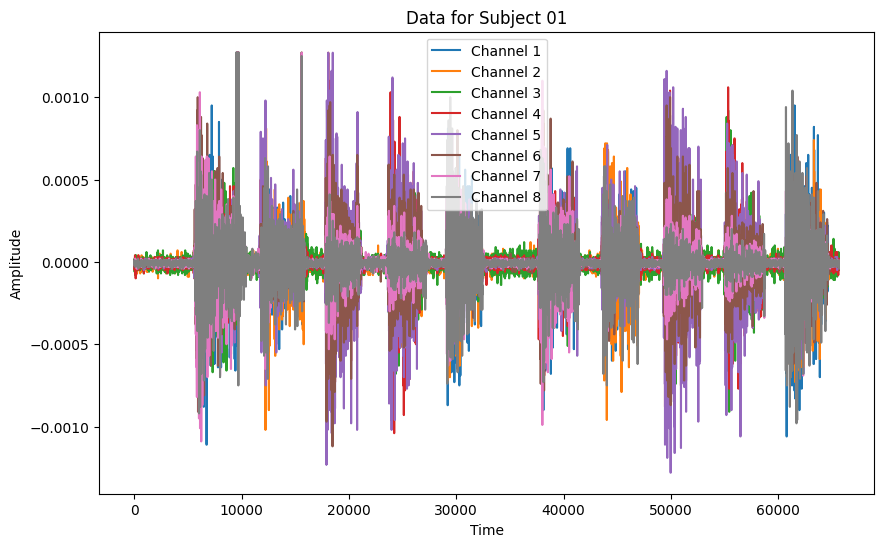

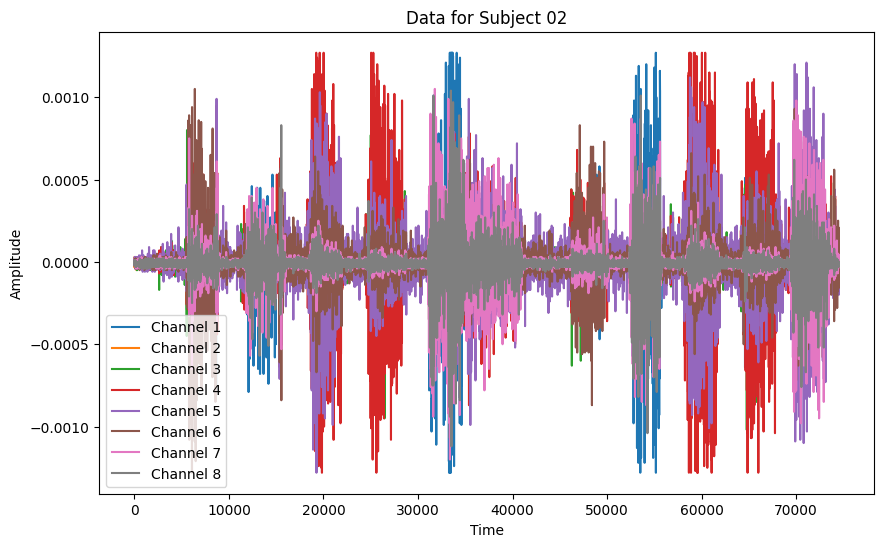

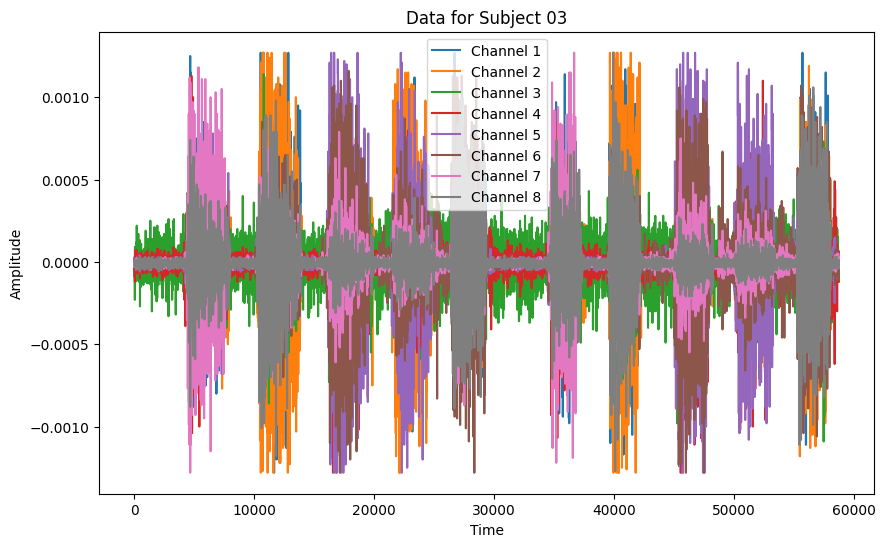

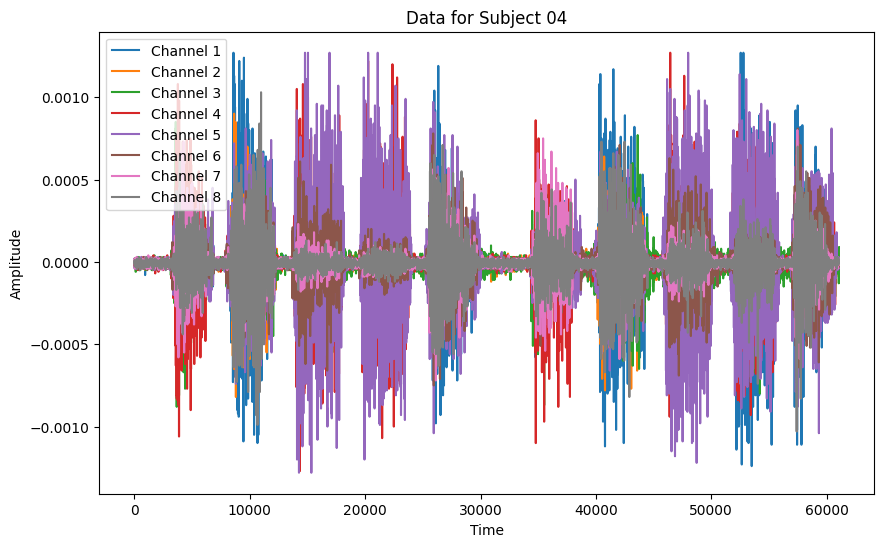

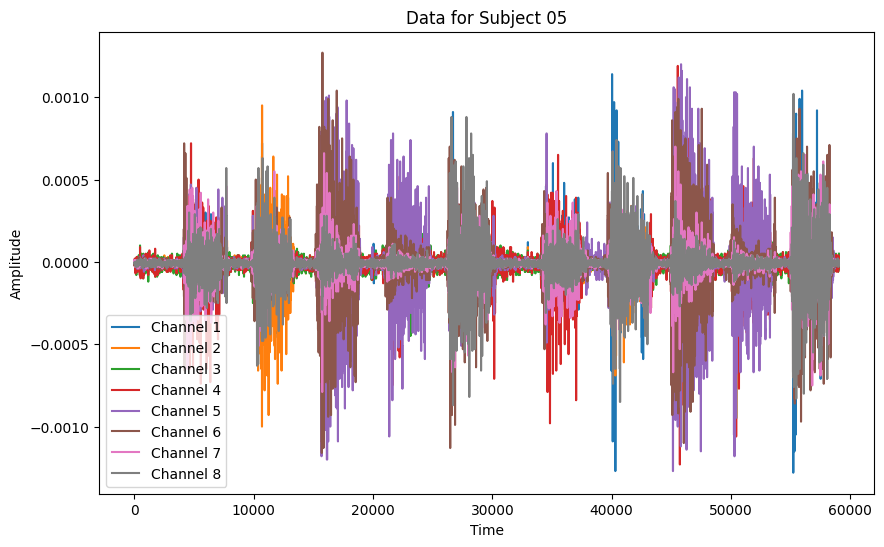

...

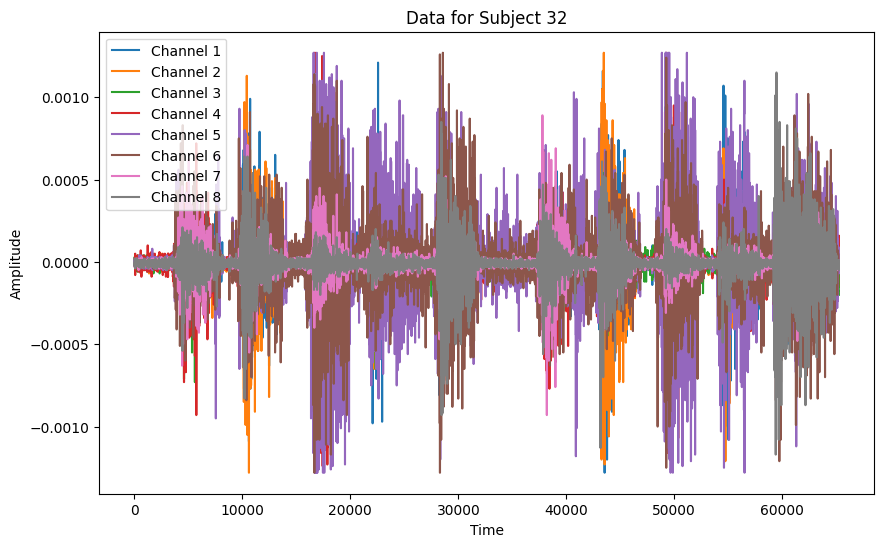

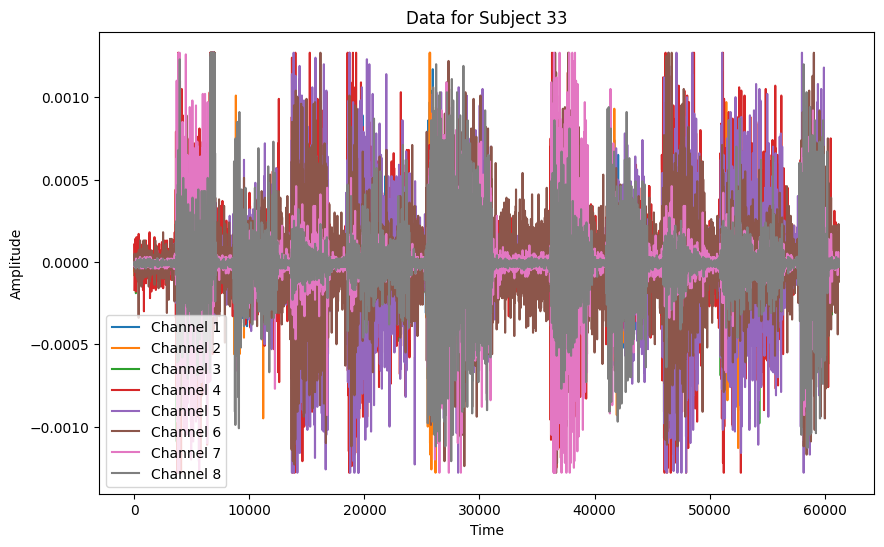

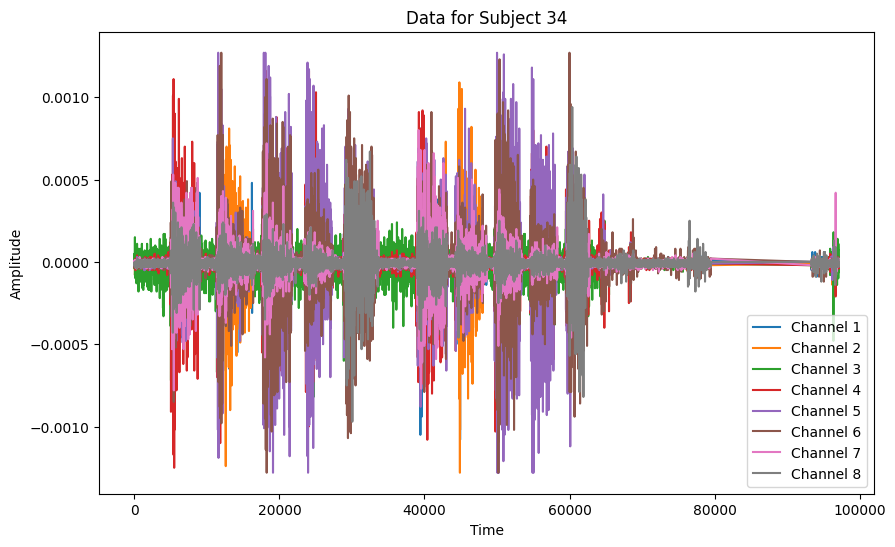

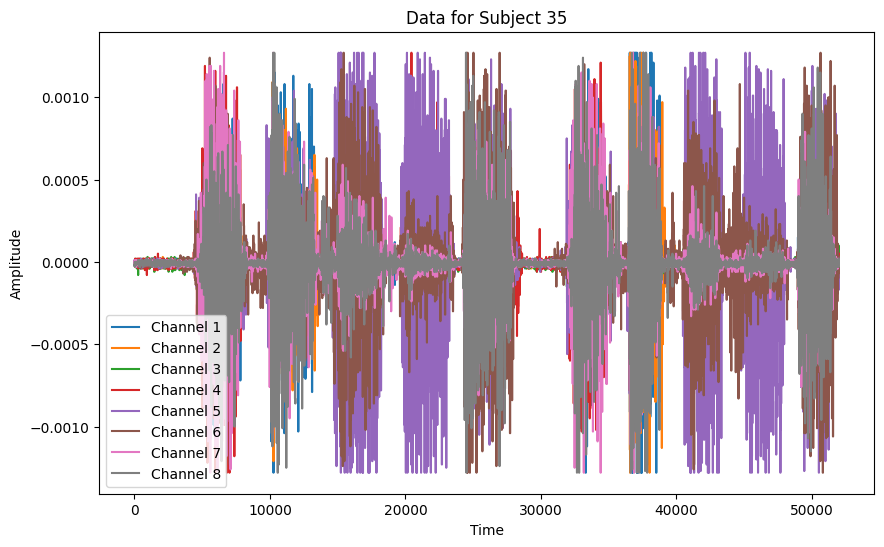

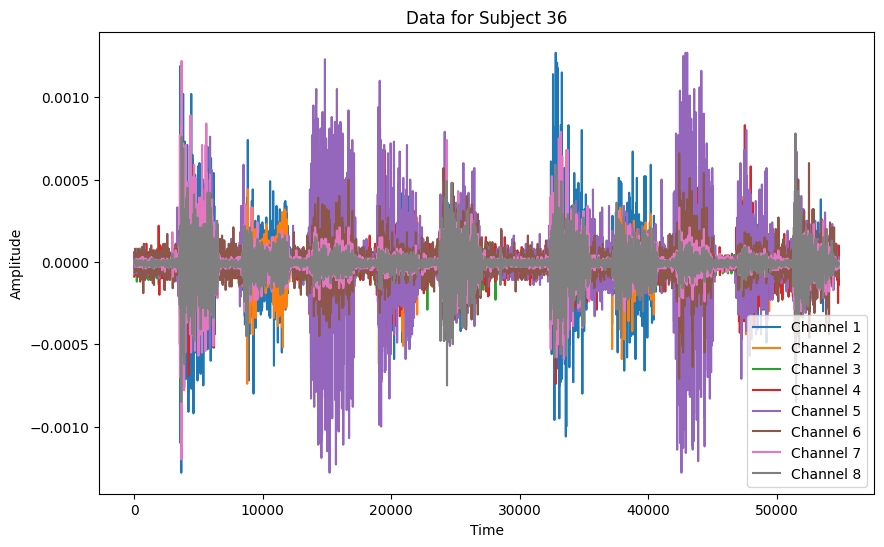

In [ ]:
# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Buscar archivos txt que empiezan con "1_raw_data"
        archivos = [f for f in os.listdir(sujeto_path) if f.startswith("1_raw_data") and f.endswith(".txt")]

        # Crear un dataframe vacío para el sujeto actual
        df_sujeto = pd.DataFrame()

        # Procesar cada archivo encontrado y concatenar los datos en el dataframe del sujeto
        for archivo in archivos:
            archivo_path = os.path.join(sujeto_path, archivo)
            df = pd.read_csv(archivo_path, delimiter='\t')
            df_sujeto = pd.concat([df_sujeto, df], ignore_index=True)

        # Graficar los datos del sujeto
        plt.figure(figsize=(10, 6))
        plt.plot(df_sujeto['time'], df_sujeto['channel1'], label='Channel 1')
        plt.plot(df_sujeto['time'], df_sujeto['channel2'], label='Channel 2')
        plt.plot(df_sujeto['time'], df_sujeto['channel3'], label='Channel 3')
        plt.plot(df_sujeto['time'], df_sujeto['channel4'], label='Channel 4')
        plt.plot(df_sujeto['time'], df_sujeto['channel5'], label='Channel 5')
        plt.plot(df_sujeto['time'], df_sujeto['channel6'], label='Channel 6')
        plt.plot(df_sujeto['time'], df_sujeto['channel7'], label='Channel 7')
        plt.plot(df_sujeto['time'], df_sujeto['channel8'], label='Channel 8')
        plt.xlabel('Time')
        plt.ylabel('Amplitude')
        plt.title(f'Data for Subject {sujeto}')
        plt.legend()
        plt.show()

In [ ]:
# Función para calcular TKEO a los datos de un canal
def calcular_tkeo(datos):
    return datos ** 2 - datos.shift(1) * datos.shift(-1)

# Función para procesar un archivo y aplicar TKEO
def procesar_archivo(archivo):
    # Leer el archivo txt en un dataframe
    df = pd.read_csv(archivo, delimiter='\t')

    # Eliminar filas con valores NaN en la columna 'class'
    df = df.dropna(subset=['class'])

    # Calcular TKEO para cada canal
    for canal in range(1, 9):
        df[f'channel{canal}_tkeo'] = calcular_tkeo(df[f'channel{canal}'])

    # Organizar los datos por gesto
    gestos = {}
    for gesto in df['class'].unique():
        gestos[int(gesto)] = df[df['class'] == gesto].drop(columns=['class'])

    return gestos

# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Buscar archivos txt que empiezan con "1_raw_data"
        archivos = [f for f in os.listdir(sujeto_path) if f.startswith("1_raw_data") and f.endswith(".txt")]

        # Mostrar el sujeto actual
        print(f"\nSujeto {sujeto}:")

        # Procesar cada archivo encontrado
        for archivo in archivos:
            archivo_path = os.path.join(sujeto_path, archivo)
            gestos = procesar_archivo(archivo_path)

            # Mostrar los dataframes por cada gesto en orden numérico
            for gesto in sorted(gestos.keys()):
                print(f"\nGesto {gesto}:")
                display(gestos[gesto])


Sujeto 01:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00001,-0.00002,-0.00001,-0.00003,0.00000,-0.00001,0.00000,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,0.00001,-0.00002,-0.00001,-0.00003,0.00000,-0.00001,0.00000,-0.00001,2.000000e-10,6.000000e-10,3.000000e-10,9.000000e-10,0.000000e+00,-1.000000e-10,0.000000e+00,2.000000e-10
2,6,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001,2.000000e-10,3.000000e-10,6.000000e-10,0.000000e+00,1.000000e-10,2.000000e-10,1.000000e-10,2.000000e-10
3,7,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,8,-0.00001,0.00001,0.00002,0.00000,0.00001,-0.00002,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63191,65657,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
63192,65658,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
63193,65659,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
63194,65660,-0.00001,0.00001,-0.00005,-0.00001,-0.00003,-0.00001,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2287,2400,-0.00001,0.00000,-0.00001,0.00000,0.00000,-0.00001,-0.00001,0.00001,0.0,0.000000e+00,1.000000e-10,0.000000e+00,0.000000e+00,0.0,-2.000000e-10,3.000000e-10
2288,2401,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,0.0,4.000000e-10,0.000000e+00,1.000000e-10,1.000000e-10,0.0,6.000000e-10,6.000000e-10
2289,2402,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
2290,2403,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
2291,2404,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35393,36736,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35394,36738,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35395,36739,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35396,36740,-0.00002,-0.00006,0.00000,0.00000,0.00001,0.00002,0.00000,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6424,6662,-0.00011,-0.00002,-0.00007,-0.00008,-0.00016,-0.00018,-0.00036,-0.00001,-1.900000e-09,1.000000e-10,9.100000e-09,-2.400000e-08,-6.800000e-09,1.299000e-07,2.031000e-07,-5.300000e-09
6425,6663,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006,3.500000e-08,3.000000e-10,5.880000e-08,3.840000e-08,3.360000e-08,1.750000e-08,-3.150000e-08,4.200000e-09
6426,6664,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6427,6665,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6428,6666,0.00014,0.00001,0.00021,0.00016,0.00012,-0.00025,-0.00021,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38748,40240,0.00015,-0.00005,0.00002,-0.00010,-0.00018,-0.00015,0.00013,0.00018,4.200000e-08,3.000000e-09,-4.000000e-10,2.000000e-09,5.400000e-08,4.350000e-08,4.030000e-08,3.960000e-08
38749,40241,-0.00013,0.00001,0.00004,-0.00008,0.00012,0.00014,-0.00018,-0.00004,2.140000e-08,3.100000e-09,1.200000e-09,8.400000e-09,1.260000e-08,1.960000e-08,5.970000e-08,5.200000e-09
38750,40242,-0.00003,0.00006,0.00002,0.00002,-0.00001,0.00000,-0.00021,-0.00002,-3.000000e-09,3.000000e-09,-4.000000e-10,2.000000e-09,1.300000e-09,0.000000e+00,6.300000e-09,-4.000000e-10
38751,40243,-0.00003,0.00006,0.00002,0.00002,-0.00001,0.00000,-0.00021,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12534,12967,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12535,12968,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12536,12970,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12537,12971,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12538,12972,-0.00012,-0.00014,0.00008,0.00005,0.00012,0.00008,0.00006,-0.00007,1.440000e-08,1.120000e-08,9.600000e-09,3.000000e-09,2.640000e-08,1.120000e-08,7.800000e-09,4.200000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44572,46280,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44573,46281,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44574,46282,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44575,46283,0.00001,0.00019,0.00003,-0.00006,-0.00016,-0.00005,0.00011,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17995,18614,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17996,18615,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17997,18616,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17998,18617,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17999,18618,-0.00014,-0.00029,-0.00036,-0.00047,-0.00075,-0.00066,-0.00010,-0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50026,51905,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50027,51906,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50028,51907,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50029,51908,-0.00003,-0.00010,-0.00017,-0.00011,0.00003,0.00003,-0.00004,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23545,24358,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001,-3.000000e-10,0.000000e+00,5.250000e-08,-2.480000e-08,1.890000e-07,4.500000e-08,1.200000e-09,1.000000e-10
23546,24359,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23547,24360,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23548,24361,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23549,24362,-0.00001,0.00000,0.00007,-0.00031,-0.00042,-0.00018,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55613,57696,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002,5.000000e-09,2.520000e-08,1.320000e-08,4.800000e-09,2.500000e-08,8.500000e-09,1.400000e-09,4.000000e-10
55614,57697,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55615,57698,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55616,57699,0.00005,-0.00012,-0.00012,0.00024,0.00025,0.00017,0.00007,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28883,29926,0.00005,-0.00013,0.00004,-0.00005,0.00005,0.00009,0.00011,0.00040,-2.000000e-09,-1.300000e-09,9.200000e-09,-1.200000e-08,2.750000e-08,4.230000e-08,8.800000e-09,1.040000e-07
28884,29927,0.00009,-0.00014,-0.00019,-0.00029,-0.00050,-0.00038,0.00003,0.00014,2.410000e-08,-1.290000e-08,3.850000e-08,9.060000e-08,2.360000e-07,1.345000e-07,2.290000e-08,-1.640000e-08
28885,29929,-0.00032,-0.00025,-0.00006,0.00013,0.00028,0.00011,-0.00020,0.00009,7.900000e-08,6.670000e-08,-4.000000e-09,-5.000000e-10,2.340000e-08,-3.730000e-08,4.450000e-08,-3.000000e-10
28886,29930,0.00026,0.00003,-0.00004,-0.00006,-0.00011,-0.00013,-0.00015,0.00006,1.508000e-07,8.400000e-09,-8.000000e-10,1.140000e-08,4.290000e-08,3.120000e-08,-7.500000e-09,-1.800000e-09
28887,29931,0.00026,0.00003,-0.00004,-0.00006,-0.00011,-0.00013,-0.00015,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61574,63912,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61575,63913,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61576,63914,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61577,63915,-0.00012,-0.00011,0.00004,0.00000,0.00001,0.00011,0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 02:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,5,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,6,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,7,-0.00001,-0.00003,-0.00002,0.00000,-0.00002,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72317,74521,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001,0.0,-9.000000e-10,6.000000e-10,0.0,-2.000000e-10,3.000000e-08,2.000000e-09,1.000000e-10
72318,74522,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
72319,74523,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
72320,74524,-0.00003,-0.00003,0.00002,-0.00001,-0.00002,0.00012,0.00004,-0.00001,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2755,2856,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2756,2857,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2757,2858,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2758,2859,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2759,2860,0.00000,0.00000,0.00002,0.00002,0.00000,-0.00001,-0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44268,45592,-0.00001,-0.00001,0.00000,0.00001,0.00007,-0.00004,-0.00001,-0.00001,0.0,1.000000e-10,0.000000e+00,3.000000e-10,2.800000e-09,1.200000e-09,1.000000e-10,-2.000000e-10
44269,45593,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003,0.0,0.000000e+00,1.600000e-09,6.000000e-10,-1.200000e-09,-3.000000e-10,0.000000e+00,6.000000e-10
44270,45594,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44271,45595,-0.00001,0.00000,-0.00004,-0.00002,0.00003,-0.00001,0.00000,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6122,6318,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001,0.000000e+00,3.000000e-10,5.100000e-08,1.140000e-08,-6.300000e-09,3.720000e-08,1.280000e-08,-2.000000e-10
6123,6319,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6124,6320,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6125,6321,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6126,6322,0.00000,0.00001,0.00017,-0.00019,-0.00007,0.00012,-0.00008,0.00001,0.000000e+00,-1.000000e-10,1.530000e-08,3.800000e-08,1.050000e-08,2.400000e-09,9.600000e-09,4.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47641,49056,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47642,49057,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47643,49058,0.00008,0.00001,0.00006,0.00012,0.00012,0.00028,0.00005,-0.00001,3.200000e-09,0.000000e+00,2.400000e-09,9.600000e-09,6.000000e-09,-5.600000e-09,4.500000e-09,4.000000e-10
47644,49059,0.00004,0.00001,0.00002,0.00004,0.00007,0.00030,-0.00004,0.00003,-1.600000e-09,0.000000e+00,-8.000000e-10,-3.200000e-09,-3.500000e-09,6.000000e-09,3.600000e-09,1.200000e-09



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12412,12798,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12413,12799,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12414,12800,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12415,12801,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12416,12802,0.00017,0.00002,-0.00001,-0.00003,0.00001,0.00014,0.00003,0.00027,7.480000e-08,1.800000e-09,-4.000000e-10,0.0,9.000000e-10,2.240000e-08,-4.200000e-09,8.640000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53480,55081,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53481,55082,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53482,55083,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53483,55084,0.00059,0.00007,0.00002,0.00001,0.00003,-0.00001,0.00013,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19029,19599,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003,1.400000e-09,3.300000e-09,1.890000e-08,2.209800e-06,2.944000e-07,-2.400000e-09,-6.000000e-10,-6.000000e-10
19030,19600,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19031,19601,-0.00007,-0.00011,0.00009,0.00127,0.00046,0.00006,-0.00002,-0.00003,1.400000e-08,3.850000e-08,-3.510000e-08,1.092200e-06,-2.622000e-07,-2.400000e-08,4.800000e-09,5.700000e-09
19032,19602,0.00013,0.00024,0.00048,0.00041,0.00103,0.00046,0.00022,0.00016,2.600000e-08,8.400000e-08,1.872000e-07,-3.526000e-07,5.871000e-07,1.840000e-07,5.280000e-08,3.040000e-08
19033,19603,0.00013,0.00024,0.00048,0.00041,0.00103,0.00046,0.00022,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59314,61081,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59315,61082,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59316,61083,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59317,61084,-0.00006,-0.00009,-0.00012,0.00062,0.00013,-0.00003,0.00000,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25152,25910,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25153,25911,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25154,25912,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25155,25913,-0.00006,-0.00013,-0.00026,-0.00022,0.00018,-0.00005,-0.00006,-0.00004,6.000000e-09,2.210000e-08,8.580000e-08,-1.012000e-07,1.620000e-08,2.500000e-09,3.600000e-09,1.200000e-09
25156,25914,0.00004,0.00004,0.00007,-0.00068,0.00009,0.00000,0.00000,-0.00001,4.000000e-09,6.800000e-09,2.310000e-08,3.128000e-07,-8.100000e-09,0.000000e+00,0.000000e+00,-3.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65105,67080,-0.00005,-0.00012,0.00000,0.00067,0.00010,0.00001,-0.00002,-0.00003,1.500000e-09,1.560000e-08,0.000000e+00,3.015000e-07,1.200000e-08,1.300000e-09,-4.000000e-10,6.000000e-10
65106,67081,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001,-6.000000e-10,1.300000e-09,9.000000e-10,-9.900000e-08,2.400000e-09,1.560000e-08,8.000000e-10,-2.000000e-10
65107,67082,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
65108,67083,-0.00002,0.00001,-0.00003,0.00022,-0.00002,-0.00012,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
37501,38615,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004,8.000000e-10,1.500000e-09,2.000000e-09,1.674000e-07,4.290000e-08,2.100000e-09,-2.700000e-08,4.000000e-10
37502,38616,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37503,38617,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37504,38618,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37505,38619,-0.00002,-0.00003,0.00004,0.00031,0.00013,-0.00007,-0.00015,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70733,72873,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70734,72874,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70735,72875,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70736,72876,0.00004,-0.00001,-0.00006,-0.00009,-0.00024,-0.00019,-0.00014,-0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 03:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00005,0.00000,-0.00005,-0.00002,-0.00001,-0.00002,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001,0.0,2.400000e-09,8.100000e-09,-4.000000e-10,0.0,1.200000e-09,3.000000e-10,-1.000000e-10
2,6,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
3,7,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
4,8,-0.00002,-0.00008,-0.00009,-0.00004,-0.00002,-0.00004,-0.00003,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56563,58768,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
56564,58769,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
56565,58770,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
56566,58771,-0.00003,-0.00001,0.00006,-0.00012,-0.00008,-0.00002,-0.00002,-0.00004,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1668,1783,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1669,1784,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1670,1785,0.00000,-0.00004,-0.00009,-0.00007,-0.00002,-0.00002,-0.00001,-0.00001,0.000000e+00,-8.000000e-10,2.700000e-09,7.000000e-10,-2.000000e-10,2.000000e-10,0.000000e+00,2.000000e-10
1671,1787,0.00001,-0.00006,-0.00006,-0.00006,-0.00003,-0.00001,-0.00001,0.00001,1.000000e-10,1.200000e-09,-1.800000e-09,-6.000000e-10,3.000000e-10,-1.000000e-10,0.000000e+00,2.000000e-10
1672,1790,0.00001,-0.00006,-0.00006,-0.00006,-0.00003,-0.00001,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32031,33303,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32032,33304,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32033,33305,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32034,33306,-0.00001,-0.00003,-0.00005,-0.00004,-0.00002,-0.00001,-0.00002,0.00000,0.000000e+00,3.000000e-10,-5.000000e-10,0.000000e+00,2.000000e-10,1.000000e-10,6.000000e-10,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5158,5446,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5159,5447,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5160,5448,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5161,5449,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5162,5450,0.00016,0.00056,0.00016,0.00024,-0.00028,-0.00016,0.00054,0.00025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35318,36712,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35319,36713,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35320,36714,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35321,36715,-0.00038,-0.00037,0.00009,0.00032,0.00002,0.00005,-0.00012,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10991,11534,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10992,11535,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10993,11536,-0.00034,-0.00072,-0.00006,-0.00002,-0.00014,-0.00013,-0.00008,0.00037,1.054000e-07,9.936000e-07,1.560000e-08,2.200000e-09,4.620000e-08,3.900000e-09,-4.800000e-09,1.887000e-07
10994,11539,-0.00003,0.00066,0.00020,0.00009,0.00019,-0.00010,-0.00014,-0.00014,-9.300000e-09,9.108000e-07,5.200000e-08,9.900000e-09,6.270000e-08,-3.000000e-09,8.400000e-09,7.140000e-08
10995,11540,-0.00003,0.00066,0.00020,0.00009,0.00019,-0.00010,-0.00014,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40423,42008,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40424,42009,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40425,42010,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40426,42011,0.00000,0.00024,0.00001,-0.00011,-0.00019,-0.00043,-0.00011,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16364,17094,0.00000,0.00004,0.00010,-0.00011,-0.00008,0.00076,0.00046,0.00010,0.000000e+00,1.600000e-08,4.700000e-08,2.970000e-08,8.320000e-08,7.372000e-07,4.186000e-07,3.700000e-08
16365,17095,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027,1.369000e-07,1.440000e-07,1.739000e-07,4.320000e-08,9.984000e-07,2.037000e-07,4.095000e-07,9.990000e-08
16366,17096,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16367,17097,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16368,17098,-0.00037,-0.00036,-0.00037,0.00016,0.00096,-0.00021,-0.00045,-0.00027,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45888,47672,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45889,47673,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45890,47674,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45891,47675,-0.00003,-0.00009,-0.00003,0.00029,-0.00061,0.00024,0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21670,22583,0.00029,0.00053,0.00011,0.00015,0.00034,0.00030,0.00015,0.00005,1.305000e-07,7.526000e-07,1.870000e-08,7.500000e-09,3.060000e-08,1.020000e-07,2.550000e-08,8.000000e-09
21671,22584,-0.00016,-0.00089,-0.00006,0.00010,0.00025,-0.00004,-0.00002,-0.00011,6.620000e-08,7.020000e-07,1.900000e-08,5.050000e-08,-8.710000e-08,-1.040000e-08,1.240000e-08,1.560000e-08
21672,22585,-0.00014,0.00017,-0.00014,-0.00027,0.00044,0.00004,-0.00008,-0.00007,2.120000e-08,9.120000e-08,1.840000e-08,9.590000e-08,2.911000e-07,-6.000000e-09,4.200000e-09,-2.800000e-09
21673,22586,0.00001,0.00007,-0.00002,-0.00023,-0.00039,-0.00019,-0.00011,-0.00007,1.500000e-09,-7.000000e-09,-2.400000e-09,-9.200000e-09,3.237000e-07,4.370000e-08,3.300000e-09,0.000000e+00
21674,22588,0.00001,0.00007,-0.00002,-0.00023,-0.00039,-0.00019,-0.00011,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51053,53040,0.00006,0.00021,0.00003,-0.00019,0.00058,0.00032,0.00006,0.00006,7.800000e-09,5.460000e-08,-2.400000e-09,9.120000e-08,1.160000e-07,1.280000e-07,4.200000e-09,4.800000e-09
51054,53041,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002,9.100000e-09,1.300000e-08,8.800000e-09,1.392000e-07,-7.600000e-08,3.200000e-08,7.000000e-10,1.600000e-09
51055,53042,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51056,53043,-0.00007,-0.00005,0.00011,0.00029,0.00038,-0.00008,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26348,27422,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002,6.320000e-08,2.800000e-08,2.970000e-08,-6.000000e-10,-1.140000e-08,-1.104000e-07,8.500000e-08,8.600000e-09
26349,27423,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26350,27424,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26351,27425,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26352,27426,0.00008,0.0001,0.00011,-0.00001,-0.00019,-0.00046,-0.00034,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55628,57776,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55629,57777,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55630,57778,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55631,57779,-0.00025,0.0001,-0.00001,-0.00004,0.00016,0.00011,0.00022,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 04:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,5,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,6,-0.00001,-0.00003,-0.00002,-0.00002,-0.00002,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59102,61057,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59103,61058,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59104,61059,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59105,61060,0.00001,0.00008,0.00009,0.00000,0.00001,0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
763,777,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
764,778,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
765,779,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
766,780,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
767,781,-0.00002,-0.00003,-0.00003,-0.00002,0.00000,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32228,33298,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32229,33299,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32230,33300,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32231,33301,0.00002,-0.00001,0.00000,-0.00002,-0.00003,-0.00002,-0.00002,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4045,4161,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4046,4162,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4047,4163,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4048,4164,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4049,4165,-0.00032,-0.00019,-0.00034,-0.00052,-0.00011,-0.00006,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35924,37112,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35925,37113,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35926,37114,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35927,37115,0.00005,0.00000,0.00015,0.00012,-0.00012,-0.00007,0.00000,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
9070,9338,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9071,9339,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9072,9340,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9073,9341,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9074,9342,-0.00050,-0.0002,0.00010,-0.00013,-0.00050,-0.00013,-0.00006,-0.00034,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41655,43046,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41656,43047,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41657,43048,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41658,43049,0.00076,0.0003,0.00007,0.00012,0.00036,0.00012,0.00000,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
14568,15033,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14569,15034,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14570,15035,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14571,15036,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14572,15038,0.00001,0.00004,0.00028,0.00028,0.00001,-0.00020,-0.00006,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47543,49119,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47544,49120,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47545,49121,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47546,49122,-0.00012,-0.00013,-0.00004,-0.00021,-0.00002,0.00003,-0.00010,-0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19795,20469,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19796,20470,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19797,20471,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19798,20472,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19799,20473,0.00001,-0.00005,-0.00004,0.00015,0.00036,-0.00001,-0.00004,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52747,54495,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52748,54496,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52749,54497,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52750,54498,0.00054,0.00004,-0.00003,0.00050,0.00079,0.00008,0.00001,0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25667,26533,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25668,26534,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25669,26535,-0.00093,-0.00013,-0.00002,0.00004,-0.00006,0.00015,0.00013,-0.00052,1.404300e-06,4.940000e-08,8.000000e-10,-4.800000e-09,7.800000e-09,-1.200000e-08,-1.170000e-08,4.524000e-07
25670,26536,0.00058,0.00025,0.00002,0.00016,0.00007,0.00023,0.00022,0.00035,3.922000e-07,5.600000e-08,-6.000000e-10,2.280000e-08,2.650000e-08,1.240000e-08,2.890000e-08,1.121000e-07
25671,26538,0.00006,-0.00005,-0.00005,0.00007,0.00036,0.00027,0.00015,-0.00002,-3.120000e-08,1.500000e-08,3.500000e-09,-6.300000e-09,1.044000e-07,1.080000e-08,-1.050000e-08,7.400000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57704,59613,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57705,59614,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57706,59615,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57707,59616,0.00009,0.00006,0.00005,0.00007,0.00001,0.00018,-0.00003,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 05:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,6,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,8,-0.00001,-0.00002,0.00001,0.00000,0.00000,-0.00002,0.00001,-0.00001,0.000000e+00,6.000000e-10,1.000000e-10,0.000000e+00,0.000000e+00,6.000000e-10,1.000000e-10,0.000000e+00
4,9,-0.00001,0.00001,0.00000,-0.00002,-0.00001,0.00001,0.00000,-0.00001,0.000000e+00,3.000000e-10,0.000000e+00,4.000000e-10,1.000000e-10,3.000000e-10,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57113,59040,-0.00003,0.00000,-0.00003,-0.00003,-0.00002,-0.00001,0.00000,0.00000,6.000000e-10,0.000000e+00,2.400000e-09,1.800000e-09,4.000000e-10,-2.000000e-10,0.000000e+00,0.000000e+00
57114,59041,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002,-2.000000e-10,4.000000e-10,4.000000e-09,1.800000e-09,0.000000e+00,6.000000e-10,1.000000e-10,4.000000e-10
57115,59043,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57116,59044,-0.00001,0.00002,0.00005,0.00003,0.00000,-0.00003,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
983,1047,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
984,1048,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
985,1049,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
986,1050,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
987,1051,-0.00001,-0.00002,-0.00002,-0.00001,-0.00002,0.00000,0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32181,33257,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32182,33258,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32183,33259,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32184,33260,0.00000,0.00001,-0.00002,0.00001,0.00001,0.00001,0.00001,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4809,5015,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4810,5016,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4811,5017,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4812,5018,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4813,5019,-0.00004,-0.00006,-0.00006,-0.00020,-0.00008,-0.00012,-0.00015,-0.00014,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35528,36721,0.00004,0.00003,0.00003,0.00006,0.00000,-0.00022,-0.00033,-0.00018,-8.800000e-09,-6.000000e-10,-9.000000e-10,1.200000e-09,0.000000e+00,4.620000e-08,1.320000e-07,5.040000e-08
35529,36722,0.00004,0.00003,0.00003,0.00006,0.00000,-0.00022,-0.00033,-0.00018,-1.600000e-09,-3.000000e-10,1.500000e-09,4.800000e-09,0.000000e+00,8.140000e-08,1.551000e-07,4.140000e-08
35530,36723,0.00008,0.00004,-0.00002,-0.00002,0.00008,0.00015,0.00014,0.00005,3.200000e-09,4.000000e-10,1.000000e-09,1.600000e-09,6.400000e-09,5.550000e-08,6.580000e-08,1.150000e-08
35531,36724,0.00008,0.00004,-0.00002,-0.00002,0.00008,0.00015,0.00014,0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10785,11183,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002,4.200000e-09,1.210000e-08,0.0,-2.000000e-10,0.0,0.0,1.350000e-08,0.0
10786,11184,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
10787,11185,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
10788,11186,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
10789,11188,0.00006,0.00011,0.00000,-0.00002,0.00000,-0.00008,0.00009,-0.00002,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41141,42505,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
41142,42506,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
41143,42507,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0
41144,42508,0.00004,-0.00003,-0.00005,-0.00005,-0.00005,-0.00004,0.00015,0.00019,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.000000e+00,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15979,16543,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15980,16544,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15981,16545,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15982,16546,-0.00005,-0.00007,-0.00012,-0.00033,0.00001,-0.00003,-0.00004,-0.00004,1.000000e-09,-3.500000e-09,-1.080000e-08,9.900000e-09,1.300000e-09,6.000000e-10,-4.000000e-09,8.000000e-10
15983,16547,-0.00003,-0.00012,-0.00021,-0.00030,-0.00012,-0.00001,-0.00014,-0.00002,-6.000000e-10,6.000000e-09,1.890000e-08,-9.000000e-09,1.560000e-08,-2.000000e-10,1.400000e-08,-4.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46196,47752,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
46197,47753,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
46198,47754,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
46199,47755,-0.00003,-0.00003,-0.00001,0.00012,-0.00008,-0.00003,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21478,22223,-0.00008,-0.00013,0.00005,0.00035,0.00012,0.00000,-0.00006,-0.00004,1.600000e-09,1.300000e-08,2.500000e-09,1.435000e-07,3.240000e-08,0.0,4.200000e-09,1.600000e-09
21479,22224,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000,-1.200000e-09,-3.000000e-09,0.000000e+00,2.460000e-08,4.050000e-08,0.0,7.000000e-10,0.000000e+00
21480,22225,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
21481,22226,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
21482,22227,-0.00006,-0.00003,0.00000,-0.00006,-0.00015,0.00000,0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51094,52809,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
51095,52810,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
51096,52811,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
51097,52812,0.00003,0.00001,0.00010,0.00014,-0.00003,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26455,27359,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26456,27360,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26457,27361,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26458,27362,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26459,27363,0.00002,-0.00002,-0.00002,-0.00003,-0.00005,0.00004,-0.00007,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56195,58073,0.00015,0.00004,0.00006,0.00007,0.00011,0.00065,0.00027,0.00045,3.600000e-08,2.800000e-09,6.600000e-09,8.400000e-09,2.310000e-08,1.820000e-07,7.560000e-08,2.880000e-07
56196,58074,-0.00009,-0.00003,-0.00005,-0.00005,-0.00010,0.00037,-0.00001,-0.00019,2.760000e-08,2.500000e-09,3.100000e-09,4.600000e-09,2.320000e-08,3.189000e-07,3.790000e-08,-4.400000e-09
56197,58075,-0.00013,-0.00004,-0.00001,-0.00003,-0.00012,-0.00028,-0.00014,0.00009,-1.010000e-08,1.000000e-10,-1.400000e-09,-6.000000e-10,-1.360000e-08,2.967000e-07,1.700000e-08,-3.300000e-09
56198,58076,-0.00030,-0.00005,-0.00003,-0.00003,-0.00028,-0.00059,-0.00026,-0.00006,5.100000e-08,5.000000e-10,6.000000e-10,0.000000e+00,4.480000e-08,1.829000e-07,3.120000e-08,9.000000e-09



Sujeto 06:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,7,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,8,-0.00001,-0.00004,-0.00002,0.00001,0.00000,-0.00001,0.00000,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51073,53624,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51074,53625,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51075,53626,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51076,53627,0.00000,0.00001,-0.00003,-0.00003,-0.00002,-0.00001,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
901,968,-0.00002,0.00003,0.00001,0.00003,0.00000,-0.00003,-0.00004,-0.00001,6.000000e-10,0.0,0.0,9.000000e-10,0.000000e+00,3.000000e-10,1.200000e-09,1.000000e-10
902,969,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000,3.000000e-10,0.0,0.0,0.000000e+00,1.000000e-10,-2.000000e-10,-3.000000e-10,0.000000e+00
903,970,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
904,971,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
905,972,0.00001,0.00003,0.00001,0.00000,-0.00001,-0.00002,-0.00001,0.00000,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29888,31681,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29889,31682,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29890,31683,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29891,31684,-0.00002,0.00002,-0.00001,-0.00001,-0.00003,-0.00001,-0.00004,-0.00001,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4372,4568,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
4373,4569,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
4374,4570,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
4375,4571,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
4376,4572,-0.00020,-0.00007,0.00016,0.00006,-0.00002,-0.00028,-0.00006,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33150,35025,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
33151,35026,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00
33152,35027,-0.00018,-0.00002,0.00006,0.00015,0.00004,-0.00009,-0.00004,0.00010,9.000000e-09,-1.400000e-09,6.000000e-09,-1.500000e-09,0.0,8.100000e-09,0.0,4.100000e-08
33153,35028,-0.00013,-0.00009,-0.00004,0.00016,0.00004,0.00000,-0.00004,-0.00031,-6.500000e-09,6.300000e-09,4.000000e-09,1.600000e-09,0.0,0.000000e+00,0.0,1.271000e-07



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10141,10593,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10142,10594,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10143,10595,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10144,10596,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10145,10597,0.00024,0.00006,-0.00003,0.00002,0.00006,-0.00010,-0.00028,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38155,40210,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38156,40211,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38157,40212,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38158,40213,0.00004,-0.00005,-0.00005,-0.00006,0.00000,-0.00008,0.00010,0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
14336,15246,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14337,15247,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14338,15248,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14339,15249,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14340,15250,-0.00006,-0.00022,-0.00019,-0.00051,-0.00062,-0.00028,-0.00019,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42120,44345,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42121,44346,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42122,44347,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42123,44348,0.00001,-0.00010,-0.00001,0.00002,-0.00005,0.00033,0.00012,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19071,20271,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19072,20272,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19073,20273,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19074,20274,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19075,20275,0.00005,-0.00011,-0.00009,-0.00011,0.0001,0.00024,0.00004,0.00010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46406,48769,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46407,48770,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46408,48771,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46409,48772,0.00004,0.00006,0.00028,0.00039,0.0000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23963,25295,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23964,25296,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23965,25297,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23966,25298,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23967,25299,-0.00027,-0.00003,-0.00003,-0.0001,-0.00025,-0.00020,-0.00021,-0.00054,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50122,52625,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50123,52626,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50124,52627,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50125,52628,0.00001,0.00009,-0.00002,0.0000,0.00008,-0.00003,0.00004,0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 07:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00005,0.00000,-0.00006,-0.00002,0.00000,0.00000,0.00000,0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001,2.400000e-09,2.500000e-09,-5.000000e-10,3.500000e-09,9.610000e-08,9.000000e-10,0.000000e+00,2.000000e-10
2,17,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,18,-0.00003,-0.00005,-0.00001,-0.00007,-0.00031,-0.00003,0.00000,-0.00001,1.800000e-09,2.500000e-09,-1.000000e-10,6.300000e-09,-6.200000e-09,-3.000000e-10,0.000000e+00,-1.000000e-10
4,19,0.00003,0.00000,-0.00002,0.00002,-0.00033,-0.00004,-0.00002,-0.00002,1.800000e-09,0.000000e+00,2.000000e-10,1.800000e-09,6.600000e-09,4.000000e-10,4.000000e-10,2.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68692,70632,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
68693,70633,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
68694,70634,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
68695,70635,0.00005,-0.00001,-0.00003,-0.00019,-0.00013,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1948,2064,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1949,2065,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1950,2066,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1951,2067,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1952,2068,0.00006,0.00002,-0.00002,-0.00006,-0.00010,-0.00001,0.00002,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37409,38465,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37410,38466,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37411,38467,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37412,38468,-0.00006,-0.00003,-0.00003,0.00000,-0.00055,0.00004,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6075,6286,-0.00039,-0.00008,-0.00006,-0.00014,-0.00002,-0.00009,-0.00002,-0.00048,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6076,6287,-0.00039,-0.00008,-0.00006,-0.00014,-0.00002,-0.00009,-0.00002,-0.00048,1.209000e-07,-2.400000e-09,-1.080000e-08,1.680000e-08,2.800000e-09,9.900000e-09,3.800000e-09,4.272000e-07
6077,6288,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041,-2.480000e-08,3.300000e-09,4.320000e-08,-2.400000e-09,1.680000e-08,2.200000e-09,3.230000e-08,3.649000e-07
6078,6289,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6079,6290,-0.00008,-0.00011,-0.00024,-0.00002,0.00012,0.00002,0.00017,0.00041,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41680,42848,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41681,42849,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41682,42850,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41683,42851,0.00000,0.00001,0.00003,0.00008,-0.00005,0.00018,-0.00004,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13034,13423,0.00000,0.00001,-0.00002,0.00013,0.00037,-0.00007,-0.00005,0.00009,-1.000000e-09,1.300000e-09,4.000000e-10,2.050000e-08,1.054000e-07,6.300000e-09,-5.000000e-10,4.970000e-08
13035,13424,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032,4.000000e-10,2.000000e-09,0.000000e+00,4.800000e-09,-3.360000e-08,1.800000e-09,5.000000e-09,1.312000e-07
13036,13425,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13037,13426,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13038,13427,-0.00002,-0.00004,0.00000,-0.00003,0.00021,0.00002,-0.00010,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47320,48625,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47321,48626,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47322,48627,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47323,48628,0.00010,0.00003,0.00002,-0.00013,0.00006,0.00008,0.00007,0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19400,19959,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19401,19960,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19402,19961,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19403,19962,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19404,19963,0.00008,0.00011,0.00040,-0.00039,-0.00001,0.00015,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54149,55657,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54150,55658,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54151,55659,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54152,55660,-0.00002,-0.00001,0.00013,0.00055,0.00025,-0.00002,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25808,26542,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25809,26543,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25810,26544,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25811,26545,0.00005,-0.00003,0.00000,0.00042,-0.00022,-0.00003,0.00000,-0.00008,-8.500000e-09,-2.700000e-09,0.000000e+00,3.906000e-07,4.180000e-08,1.500000e-09,0.000000e+00,1.040000e-08
25812,26546,0.00022,-0.00012,-0.00018,-0.00051,-0.00003,0.00002,-0.00001,0.00005,3.740000e-08,1.080000e-08,3.240000e-08,4.743000e-07,-5.700000e-09,1.000000e-09,1.000000e-10,6.500000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60620,62313,-0.00013,-0.00011,-0.00014,-0.00021,0.00014,0.00000,0.00002,0.00033,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60621,62314,-0.00013,-0.00011,-0.00014,-0.00021,0.00014,0.00000,0.00002,0.00033,2.600000e-08,1.430000e-08,2.660000e-08,1.050000e-08,4.480000e-08,0.000000e+00,1.000000e-09,3.300000e-08
60622,62315,0.00007,0.00002,0.00005,-0.00016,-0.00018,-0.00008,-0.00003,0.00023,1.400000e-08,2.600000e-09,9.500000e-09,-8.000000e-09,5.760000e-08,6.400000e-09,1.500000e-09,-2.300000e-08
60623,62316,0.00007,0.00002,0.00005,-0.00016,-0.00018,-0.00008,-0.00003,0.00023,1.050000e-08,-2.000000e-10,-4.000000e-09,8.640000e-08,1.080000e-08,1.040000e-08,-6.000000e-10,4.140000e-08



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
31396,32289,0.00000,0.00000,0.00009,0.00030,-0.00005,0.00021,-0.00005,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
31397,32290,0.00000,0.00000,0.00009,0.00030,-0.00005,0.00021,-0.00005,0.00001,0.000000e+00,0.000000e+00,1.170000e-08,9.900000e-08,3.250000e-08,4.410000e-08,1.350000e-08,0.000000e+00
31398,32291,0.00001,-0.00002,-0.00004,-0.00003,0.00060,0.00000,0.00022,0.00001,1.000000e-10,4.000000e-10,6.100000e-09,-1.191000e-07,3.050000e-07,4.620000e-08,4.740000e-08,1.000000e-10
31399,32292,0.00001,0.00001,-0.00005,0.00040,-0.00110,-0.00022,-0.00002,0.00000,0.000000e+00,3.000000e-10,5.000000e-10,1.720000e-07,1.870000e-06,4.840000e-08,4.800000e-09,0.000000e+00
31400,32293,0.00001,0.00001,-0.00005,0.00040,-0.00110,-0.00022,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66614,68465,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66615,68466,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66616,68467,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66617,68468,0.00000,0.00001,0.00006,0.00036,0.00116,0.00005,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 08:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,5,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,7,-0.00001,-0.00002,-0.00001,-0.00001,-0.00002,0.00000,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60275,62920,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60276,62921,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60277,62922,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60278,62923,0.00001,0.00000,0.00008,0.00011,-0.00004,-0.00002,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1898,1984,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1899,1985,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1900,1986,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1901,1988,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1902,1990,-0.00001,0.00001,0.00000,-0.00001,0.00000,-0.00001,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35784,37329,-0.00003,-0.00007,-0.00019,-0.00019,-0.00003,0.00000,-0.00001,0.0,9.000000e-10,4.900000e-09,3.310000e-08,3.570000e-08,1.000000e-09,0.000000e+00,-3.000000e-10,0.0
35785,37330,0.00000,0.00001,0.00006,0.00001,0.00001,0.00000,-0.00002,0.0,0.000000e+00,-1.300000e-09,3.600000e-09,-7.500000e-09,-5.000000e-10,0.000000e+00,4.000000e-10,0.0
35786,37331,0.00000,-0.00002,0.00000,-0.00004,-0.00002,0.00002,0.00000,0.0,0.000000e+00,6.000000e-10,0.000000e+00,2.000000e-09,6.000000e-10,4.000000e-10,0.000000e+00,0.0
35787,37332,0.00000,-0.00002,0.00000,-0.00004,-0.00002,0.00002,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5288,5519,-0.00007,0.00002,0.00036,0.00103,0.00030,-0.00007,-0.00126,-0.00029,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5289,5520,-0.00007,0.00002,0.00036,0.00103,0.00030,-0.00007,-0.00126,-0.00029,2.730000e-08,-2.400000e-09,-7.920000e-08,4.635000e-07,9.900000e-08,1.960000e-08,1.789200e-06,3.480000e-08
5290,5521,0.00032,0.00014,0.00058,0.00058,-0.00003,0.00021,0.00016,-0.00017,1.052000e-07,2.340000e-08,3.796000e-07,7.381000e-07,1.419000e-07,2.800000e-09,-4.784000e-07,-1.000000e-10
5291,5522,0.00004,-0.00019,-0.00012,-0.00039,-0.00047,-0.00059,-0.00040,-0.00010,-1.120000e-08,6.270000e-08,8.400000e-08,3.783000e-07,2.068000e-07,4.720000e-07,2.240000e-07,-7.000000e-09
5292,5523,0.00004,-0.00019,-0.00012,-0.00039,-0.00047,-0.00059,-0.00040,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39373,41073,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39374,41074,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39375,41075,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39376,41076,-0.00002,0.00000,0.00008,0.00034,0.00023,-0.00024,-0.00074,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12533,13079,0.00028,0.00007,-0.00003,0.00005,0.00006,-0.00024,-0.00021,-0.00073,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12534,13080,0.00028,0.00007,-0.00003,0.00005,0.00006,-0.00024,-0.00021,-0.00073,2.380000e-07,1.050000e-08,-9.000000e-10,2.500000e-09,-1.260000e-08,7.680000e-08,1.008000e-07,9.563000e-07
12535,13081,-0.00057,-0.00008,-0.00006,0.00000,0.00027,0.00008,0.00027,0.00058,3.529000e-07,6.400000e-09,5.400000e-09,-5.000000e-09,5.130000e-08,4.000000e-08,1.548000e-07,6.357000e-07
12536,13082,-0.00010,0.00000,0.00006,0.00010,0.00036,0.00014,0.00039,0.00041,-4.700000e-08,0.000000e+00,7.200000e-09,1.000000e-08,3.240000e-08,8.400000e-09,4.680000e-08,-6.970000e-08
12537,13083,-0.00010,0.00000,0.00006,0.00010,0.00036,0.00014,0.00039,0.00041,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44699,46640,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44700,46641,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44701,46642,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44702,46643,0.00012,0.00016,-0.00005,0.00007,-0.00004,-0.00030,0.00018,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17684,18440,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009,-8.000000e-10,8.400000e-09,3.150000e-08,1.408000e-07,3.485000e-07,0.000001,4.750000e-08,9.000000e-10
17685,18441,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
17686,18442,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
17687,18443,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
17688,18444,-0.00004,-0.00006,0.00021,0.00044,-0.00041,-0.00084,-0.00025,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49366,51513,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
49367,51514,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
49368,51515,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
49369,51516,0.00013,0.00045,0.00018,-0.00007,-0.00083,-0.00028,0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
22652,23630,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
22653,23631,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
22654,23632,0.00034,0.00042,0.00069,0.00112,0.00002,-0.00021,0.00025,0.00022,1.462000e-07,3.738000e-07,0.000001,1.142400e-06,-6.200000e-09,-1.260000e-08,5.500000e-08,5.060000e-08
22655,23633,-0.00009,-0.00047,-0.00115,0.00010,0.00033,-0.00027,0.00003,-0.00001,3.870000e-08,4.183000e-07,0.000002,-1.020000e-07,1.023000e-07,1.620000e-08,-6.600000e-09,2.300000e-09
22656,23634,-0.00009,-0.00047,-0.00115,0.00010,0.00033,-0.00027,0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54147,56512,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54148,56513,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54149,56514,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54150,56515,0.00005,-0.00004,0.00020,0.00027,-0.00006,-0.00008,-0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
30282,31591,0.00002,-0.00001,-0.00002,-0.00006,0.00004,-0.00074,-0.00036,0.00044,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
30283,31592,0.00002,-0.00001,-0.00002,-0.00006,0.00004,-0.00074,-0.00036,0.00044,-5.000000e-09,8.000000e-10,1.600000e-09,4.800000e-09,8.000000e-10,9.472000e-07,1.692000e-07,3.432000e-07
30284,31593,0.00027,0.00007,0.00006,0.00002,0.00002,0.00054,0.00011,-0.00034,7.290000e-08,4.700000e-09,4.200000e-09,8.800000e-09,-8.000000e-09,4.914000e-07,-9.500000e-09,-8.240000e-08
30285,31594,0.00000,-0.00002,0.00003,0.00014,0.00021,0.00027,-0.00006,0.00045,-1.350000e-08,-3.000000e-10,2.700000e-09,2.200000e-08,4.850000e-08,4.347000e-07,-1.620000e-08,1.379000e-07
30286,31595,0.00005,0.00001,-0.00003,-0.00012,-0.00022,-0.00067,0.00018,-0.00019,2.500000e-09,3.000000e-10,1.800000e-09,3.120000e-08,9.460000e-08,6.298000e-07,4.320000e-08,1.216000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58604,61160,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58605,61161,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58606,61162,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58607,61163,0.00004,0.00003,0.00005,0.00007,0.00028,-0.00026,0.00004,-0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 09:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,6,-0.00001,0.00000,-0.00002,0.00000,-0.00001,0.00000,0.00001,-0.00002,0.0,0.000000e+00,-6.000000e-10,0.0,2.000000e-10,0.000000e+00,1.000000e-10,2.000000e-10
3,7,-0.00001,-0.00003,-0.00005,0.00000,0.00001,-0.00004,0.00000,-0.00001,0.0,9.000000e-10,1.500000e-09,0.0,2.000000e-10,1.600000e-09,0.000000e+00,-1.000000e-10
4,8,-0.00001,-0.00003,-0.00005,0.00000,0.00001,-0.00004,0.00000,-0.00001,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62765,65182,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
62766,65183,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
62767,65184,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
62768,65185,0.00000,0.00000,0.00001,-0.00002,0.00000,-0.00001,0.00000,-0.00002,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1155,1223,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
1156,1224,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
1157,1225,-0.00003,-0.00004,-0.00001,0.00001,0.00002,0.00001,0.0,-0.00002,9.000000e-10,1.600000e-09,1.000000e-10,3.000000e-10,1.000000e-09,0.0,0.0,6.000000e-10
1158,1226,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.00001,0.0,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,6.000000e-10,1.500000e-09,0.0,0.0,3.000000e-10
1159,1227,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.00001,0.0,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32975,34401,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
32976,34402,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
32977,34403,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
32978,34404,-0.00001,-0.00003,-0.00002,-0.00003,-0.00001,-0.00001,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4678,4895,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023,2.295000e-07,-6.000000e-10,1.260000e-08,1.440000e-07,3.000000e-09,1.260000e-08,2.500000e-09,4.370000e-08
4679,4896,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4680,4897,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4681,4898,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4682,4899,0.00045,0.00006,-0.00009,-0.00040,0.00005,-0.00006,-0.00025,0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36351,37880,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36352,37881,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36353,37882,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36354,37883,-0.00004,-0.00006,-0.00001,0.00004,-0.00003,-0.00016,0.00007,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10477,10926,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10478,10927,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10479,10928,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10480,10929,-0.00011,-0.00015,-0.00002,-0.00007,-0.00004,-0.00013,-0.00007,-0.00043,-6.600000e-09,3.750000e-08,1.600000e-09,7.000000e-09,3.200000e-09,1.300000e-08,2.030000e-08,2.666000e-07
10481,10930,-0.00017,0.00010,0.00006,0.00003,0.00004,-0.00003,0.00022,0.00019,1.020000e-08,2.500000e-08,4.800000e-09,3.000000e-09,3.200000e-09,-3.000000e-09,6.380000e-08,1.178000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42385,44104,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42386,44105,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42387,44106,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42388,44107,0.00030,0.00016,-0.00005,-0.00007,-0.00012,-0.00015,-0.00015,-0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15861,16489,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15862,16490,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15863,16491,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15864,16492,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15865,16493,-0.00004,0.00005,0.00005,0.00021,0.00030,-0.00040,-0.00004,-0.00006,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48094,50008,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
48095,50009,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
48096,50010,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
48097,50011,-0.00005,-0.00006,-0.00004,0.00049,-0.00054,0.00024,0.00002,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21280,22126,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21281,22127,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21282,22128,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21283,22129,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21284,22130,0.00007,0.00001,0.00003,-0.00006,0.00034,-0.00003,0.00000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53975,56080,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
53976,56081,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
53977,56082,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
53978,56083,-0.00027,0.00005,0.00010,0.00028,0.00028,0.00000,-0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26904,28015,0.00002,0.00001,0.00001,0.00006,0.00015,-0.00038,0.00020,-0.00083,-3.100000e-09,5.000000e-10,-1.400000e-09,6.000000e-10,5.600000e-09,1.356000e-07,4.880000e-08,8.089000e-07
26905,28016,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040,3.500000e-09,2.000000e-09,1.200000e-09,1.600000e-08,3.640000e-08,3.608000e-07,9.600000e-09,-1.720000e-07
26906,28017,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26907,28018,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26908,28019,-0.00005,-0.00004,-0.00003,-0.00010,-0.00013,0.00044,-0.00004,-0.00040,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60224,62535,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60225,62536,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60226,62538,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60227,62539,0.00005,0.00003,-0.00001,-0.00002,-0.00001,-0.00023,-0.00027,0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 10:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2628,2767,-0.00003,0.00000,0.00000,-0.00002,0.00000,0.00000,-0.00002,-0.00002,9.000000e-10,3.000000e-10,0.000000e+00,2.000000e-10,-5.000000e-10,-6.000000e-10,3.000000e-10,4.000000e-10
2629,2768,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,1.000000e-10,4.000000e-10,3.000000e-10,1.000000e-10,4.000000e-10,-1.000000e-10,-1.000000e-10
2630,2769,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2631,2770,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2632,2771,0.00000,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61636,64552,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61637,64553,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61638,64554,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61639,64555,0.00000,0.00003,0.00004,-0.00001,-0.00001,-0.00003,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
2,6,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
3,7,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
4,8,-0.00002,-0.00001,-0.00003,0.00001,-0.00002,-0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32902,34561,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
32903,34562,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
32904,34563,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0
32905,34564,-0.00001,0.00003,0.00002,0.00002,0.00000,-0.00001,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4787,5014,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4788,5015,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4789,5016,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4790,5017,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4791,5018,0.00045,0.00010,0.00014,-0.00056,0.00002,-0.00031,0.00009,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36283,38086,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36284,38089,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36285,38090,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36286,38091,-0.00003,-0.00003,-0.00002,-0.00040,-0.00013,-0.00021,0.00067,-0.00001,1.800000e-09,2.400000e-09,-4.000000e-10,1.960000e-07,1.820000e-08,3.570000e-08,6.566000e-07,1.000000e-10



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
9876,10351,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9877,10353,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9878,10354,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9879,10355,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9880,10356,-0.00013,-0.00001,-0.00002,-0.00003,-0.00004,-0.00034,-0.00014,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42017,44134,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42018,44135,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42019,44136,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42020,44139,-0.00002,0.00003,0.00003,-0.00010,-0.00008,-0.00008,0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16125,16927,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16126,16928,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16127,16929,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16128,16930,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16129,16931,0.00003,0.00005,0.00028,-0.00086,0.00042,0.00061,0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47706,50113,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47707,50114,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47708,50115,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47709,50116,-0.00001,-0.00001,-0.00012,-0.00017,0.00027,0.00031,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21776,22871,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21777,22872,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21778,22873,0.00010,-0.00004,-0.00011,0.00080,0.00045,0.00037,-0.00004,-0.00003,1.400000e-08,7.200000e-09,8.800000e-09,-7.200000e-08,-2.880000e-07,8.880000e-08,4.800000e-09,3.900000e-09
21779,22874,-0.00004,0.00014,-0.00003,0.00089,0.00109,0.00013,0.00008,0.00010,8.600000e-09,1.400000e-08,-4.600000e-09,5.921000e-07,1.152100e-06,4.280000e-08,8.000000e-10,6.700000e-09
21780,22875,-0.00007,-0.00014,-0.00005,0.00025,0.00008,-0.00007,-0.00014,-0.00011,1.170000e-08,-1.120000e-08,1.150000e-08,-4.181000e-07,-1.462000e-07,-1.070000e-08,1.720000e-08,6.100000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53300,55881,0.00005,-0.00004,0.00009,-0.00053,0.00010,-0.00036,0.00015,0.00004,-1.000000e-09,3.200000e-09,5.400000e-09,1.802000e-07,-1.200000e-08,1.548000e-07,3.300000e-08,1.600000e-09
53301,55882,0.00007,0.00004,0.00003,-0.00019,0.00022,0.00007,-0.00007,0.00000,-9.600000e-09,2.400000e-09,3.600000e-09,1.368000e-07,-3.260000e-08,1.021000e-07,7.900000e-09,-2.000000e-09
53302,55883,0.00029,0.00002,-0.00003,0.00019,0.00081,0.00027,-0.00002,0.00005,6.380000e-08,-4.000000e-10,1.800000e-09,7.220000e-08,4.779000e-07,5.400000e-08,-1.000000e-09,2.500000e-09
53303,55884,0.00029,0.00002,-0.00003,0.00019,0.00081,0.00027,-0.00002,0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26931,28290,0.00005,0.00003,0.00003,0.00010,0.00023,0.00055,0.00024,0.00022,2.500000e-09,9.000000e-10,9.000000e-10,7.300000e-09,-4.550000e-08,3.241000e-07,5.640000e-08,4.870000e-08
26932,28291,0.00000,-0.00001,0.00000,0.00009,0.00024,0.00006,-0.00002,0.00001,4.000000e-09,1.300000e-09,3.000000e-10,8.100000e-09,8.520000e-08,2.291000e-07,-1.640000e-08,-7.470000e-08
26933,28292,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034,6.400000e-09,1.200000e-09,1.000000e-10,0.000000e+00,4.320000e-08,1.927000e-07,6.300000e-09,1.122000e-07
26934,28293,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26935,28294,-0.00008,-0.00004,-0.00001,0.00000,-0.00012,-0.00041,0.00007,0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58841,61625,0.00000,0.00004,0.00003,0.00008,0.00021,-0.00005,0.00002,0.00027,0.000000e+00,4.000000e-09,3.600000e-09,1.680000e-08,2.940000e-08,9.000000e-09,2.000000e-09,1.188000e-07
58842,61626,-0.00007,-0.00006,-0.00009,-0.00013,0.00007,0.00013,-0.00008,-0.00017,4.900000e-09,4.800000e-09,9.600000e-09,1.610000e-08,-1.610000e-08,2.940000e-08,7.200000e-09,1.270000e-08
58843,61627,-0.00002,-0.00003,-0.00005,0.00001,0.00010,0.00025,-0.00004,0.00006,4.000000e-10,-9.000000e-10,-2.000000e-10,-1.030000e-08,2.120000e-08,5.990000e-08,-8.800000e-09,4.100000e-08
58844,61628,0.00000,-0.00003,-0.00003,-0.00008,-0.00016,0.00002,-0.00013,0.00022,0.000000e+00,0.000000e+00,-6.000000e-10,7.200000e-09,4.160000e-08,-4.600000e-09,1.170000e-08,3.520000e-08



Sujeto 11:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,7,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,8,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,9,-0.00002,-0.00001,0.00000,0.00004,0.00009,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74676,77081,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
74677,77082,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
74678,77083,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
74679,77084,-0.00002,0.00000,0.00006,0.00021,0.00006,-0.00003,-0.00003,-0.00002,0.0,0.0,4.200000e-09,5.460000e-08,1.200000e-09,6.000000e-10,9.000000e-10,2.000000e-10



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1869,1976,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001,0.0,4.000000e-10,-4.000000e-10,-3.000000e-10,1.500000e-08,1.000000e-10,1.000000e-10,1.000000e-10
1870,1977,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1871,1978,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1872,1979,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1873,1980,-0.00002,0.00001,-0.00001,-0.00003,0.00010,0.00001,-0.00001,-0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39814,41113,-0.00001,-0.00003,0.00001,0.00000,-0.00001,0.00001,-0.00001,0.00000,0.0,1.200000e-09,1.000000e-10,0.000000e+00,-4.000000e-10,2.000000e-10,-1.000000e-10,0.000000e+00
39815,41114,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000,0.0,4.000000e-10,0.000000e+00,0.000000e+00,2.000000e-09,2.000000e-10,2.000000e-10,0.000000e+00
39816,41115,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39817,41116,-0.00001,0.00001,0.00000,0.00000,-0.00005,-0.00001,-0.00002,0.00000,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5800,6031,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5801,6032,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5802,6033,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5803,6034,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5804,6035,0.00019,-0.00007,-0.00033,-0.00080,0.00001,-0.00001,-0.00039,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43441,44849,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
43442,44850,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
43443,44851,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
43444,44852,-0.00018,-0.00016,-0.00026,0.00029,-0.00002,-0.00006,0.00062,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11454,11871,-0.00076,0.00046,0.00000,-0.00008,-0.00024,-0.00035,-0.00006,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11455,11872,-0.00076,0.00046,0.00000,-0.00008,-0.00024,-0.00035,-0.00006,-0.00003,5.548000e-07,1.840000e-07,0.000000e+00,7.200000e-09,9.360000e-08,9.450000e-08,4.800000e-09,9.900000e-09
11456,11873,-0.00003,0.00006,0.00004,0.00001,0.00015,-0.00008,0.00002,0.00030,-2.499000e-07,3.532000e-07,1.600000e-09,-4.700000e-09,8.730000e-08,2.549000e-07,1.360000e-08,9.120000e-08
11457,11874,-0.00033,-0.00076,0.00001,-0.00006,0.00027,0.00071,0.00022,0.00004,9.900000e-08,6.232000e-07,-3.000000e-10,4.200000e-09,3.240000e-08,5.609000e-07,4.400000e-08,-1.040000e-08
11458,11875,-0.00033,-0.00076,0.00001,-0.00006,0.00027,0.00071,0.00022,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49198,50793,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49199,50794,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49200,50795,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49201,50796,0.00027,-0.00029,-0.00005,-0.00009,0.00012,-0.00044,0.00000,-0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16878,17455,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16879,17456,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16880,17457,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16881,17458,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16882,17459,-0.00002,0.00001,0.00002,0.00046,-0.00106,-0.00012,-0.00013,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55017,56793,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
55018,56794,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
55019,56795,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
55020,56796,-0.00003,-0.00003,0.00003,0.00038,0.00070,0.00045,0.00008,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
22382,23135,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22383,23138,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22384,23139,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22385,23140,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22386,23141,0.00002,0.00014,0.00020,0.00083,0.00042,-0.00011,0.00000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60717,62673,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60718,62674,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60719,62675,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60720,62676,-0.00038,-0.00038,0.00001,0.00051,0.00069,-0.00008,-0.00003,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
27711,28632,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27712,28633,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27713,28634,-0.00004,-0.00001,0.00000,0.00003,-0.00037,0.00086,0.00015,-0.00023,0.000000e+00,-6.000000e-10,0.000000e+00,6.000000e-09,-6.660000e-08,1.505000e-06,1.200000e-08,2.990000e-07
27714,28635,-0.00004,-0.00007,-0.00013,-0.00017,-0.00055,-0.00089,0.00007,0.00107,2.400000e-09,5.500000e-09,1.690000e-08,3.010000e-08,2.951000e-07,1.901000e-07,-3.110000e-08,9.494000e-07
27715,28636,0.00002,0.00006,0.00005,-0.00004,-0.00002,0.00070,0.00024,-0.00085,-2.000000e-09,-3.400000e-09,-6.600000e-09,6.700000e-09,3.359000e-07,3.565000e-07,5.130000e-08,1.364500e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66756,68897,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66757,68898,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66758,68899,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66759,68900,-0.00018,-0.00006,-0.00004,0.00007,0.00042,0.00103,-0.00002,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 7:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
33286,34375,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018,-1.026000e-07,-6.000000e-10,-5.000000e-10,0.0,1.170000e-08,2.880000e-08,-3.000000e-10,-9.180000e-08
33287,34376,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33288,34377,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33289,34378,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33290,34379,-0.00018,-0.00003,0.00001,0.00010,0.00013,0.00032,0.00003,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71988,74289,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
71989,74290,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
71990,74291,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
71991,74292,-0.00045,0.00004,0.00002,-0.00011,0.00013,0.00023,-0.00013,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 12:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,5,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,7,0.00000,-0.00002,0.00000,0.00004,-0.00003,-0.00002,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65915,67784,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
65916,67785,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
65917,67786,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
65918,67788,-0.00001,-0.00003,-0.00001,0.00001,0.00005,0.00000,0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1886,1967,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1887,1968,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1888,1969,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1889,1970,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1890,1971,-0.00001,-0.00001,0.00000,-0.00002,-0.00001,-0.00001,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36507,37538,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36508,37539,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36509,37540,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36510,37541,-0.00002,0.00000,0.00001,-0.00004,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5866,6056,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004,-5.000000e-10,-1.200000e-09,-6.300000e-09,0.0,0.0,7.000000e-09,2.700000e-08,-2.000000e-09
5867,6057,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
5868,6058,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
5869,6059,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
5870,6060,-0.00001,-0.00001,-0.00007,-0.00023,0.00000,0.00005,0.00009,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40167,41290,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
40168,41291,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
40169,41292,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00
40170,41293,0.00004,0.00006,0.00006,0.00014,-0.00003,-0.00006,0.00016,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11636,11991,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11637,11992,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11638,11993,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11639,11994,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11640,11995,0.00008,0.00005,0.00002,-0.00002,-0.00015,0.00001,0.00024,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45706,46993,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45707,46994,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45708,46995,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45709,46996,-0.00016,-0.00002,-0.00001,-0.00006,-0.00014,0.00003,-0.00023,-0.00038,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17022,17511,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17023,17512,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17024,17513,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17025,17514,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17026,17515,-0.00007,-0.00001,0.00005,0.00020,-0.00052,-0.0007,-0.00018,-0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51238,52665,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51239,52666,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51240,52667,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51241,52668,-0.00001,0.00003,0.00010,0.00028,0.00036,0.0004,0.00003,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
24638,25344,0.00004,0.00011,0.00008,0.00024,0.00004,0.00021,0.00010,0.00006,-2.400000e-09,2.200000e-09,-8.000000e-09,-1.680000e-08,-4.800000e-09,-4.200000e-09,-1.000000e-09,0.000000e+00
24639,25345,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006,6.000000e-09,-1.800000e-09,1.800000e-08,2.170000e-08,1.920000e-08,4.600000e-09,1.100000e-09,0.000000e+00
24640,25346,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24641,25347,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24642,25348,0.00010,0.00009,0.00018,0.00031,0.00016,0.00023,0.00011,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57361,58954,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004,1.440000e-08,6.390000e-07,0.000000e+00,1.200000e-07,5.200000e-08,9.800000e-08,3.000000e-10,-2.800000e-09
57362,58955,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57363,58956,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57364,58957,-0.00008,-0.00071,0.00000,0.00025,0.00026,0.00035,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
30392,31247,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30393,31248,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30394,31249,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30395,31250,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30396,31251,-0.00008,-0.00003,-0.00002,0.00005,0.00007,0.00005,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63674,65432,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63675,65433,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63676,65434,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63677,65435,-0.00002,0.00000,0.00000,0.00001,-0.00003,-0.00020,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 13:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
3883,4085,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3884,4088,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3885,4089,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3886,4090,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3887,4091,-0.00001,0.00000,0.00004,0.00013,-0.00003,-0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75671,79119,-0.00001,0.00000,-0.00004,-0.00002,-0.00010,-0.00006,-0.00002,-0.00001,-3.000000e-10,-4.000000e-10,3.600000e-09,1.160000e-08,1.280000e-08,4.500000e-09,5.000000e-10,2.000000e-10
75672,79120,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001,2.000000e-10,4.000000e-10,0.000000e+00,2.240000e-08,5.040000e-08,-9.000000e-10,-1.000000e-10,2.000000e-10
75673,79121,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75674,79122,-0.00002,-0.00002,-0.00004,-0.00016,-0.00028,-0.00003,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,7,-0.00002,-0.00002,-0.00009,-0.00009,-0.00006,-0.00001,-0.00001,-0.00003,4.000000e-10,0.000000e+00,6.300000e-09,1.170000e-08,8.400000e-09,1.000000e-10,1.000000e-10,3.000000e-10
3,8,0.00000,-0.00002,-0.00002,0.00004,0.00008,0.00000,0.00000,-0.00002,0.000000e+00,0.000000e+00,-1.400000e-09,5.200000e-09,1.120000e-08,0.000000e+00,0.000000e+00,-2.000000e-10
4,9,0.00000,-0.00002,-0.00002,0.00004,0.00008,0.00000,0.00000,-0.00002,0.000000e+00,8.000000e-10,1.200000e-09,0.000000e+00,-4.800000e-09,0.000000e+00,0.000000e+00,4.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41147,42982,-0.00002,-0.00003,-0.00006,-0.00006,0.00005,0.00000,-0.00002,-0.00002,4.000000e-10,6.000000e-10,5.400000e-09,-6.000000e-10,8.000000e-09,0.000000e+00,2.000000e-10,6.000000e-10
41148,42983,0.00000,-0.00001,0.00003,-0.00007,-0.00011,-0.00001,-0.00001,0.00001,-2.000000e-10,-5.000000e-10,-6.300000e-09,-5.000000e-10,1.960000e-08,1.000000e-10,-7.000000e-10,-3.000000e-10
41149,42984,-0.00001,-0.00002,-0.00012,-0.00009,-0.00015,-0.00004,-0.00004,-0.00002,1.000000e-10,3.000000e-10,1.470000e-08,5.300000e-09,5.000000e-10,1.400000e-09,1.700000e-09,4.000000e-10
41150,42985,0.00000,-0.00001,-0.00001,-0.00004,-0.00020,-0.00002,0.00001,0.00000,0.000000e+00,-1.000000e-10,-1.100000e-09,-2.000000e-09,1.000000e-08,-4.000000e-10,5.000000e-10,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6167,6477,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6168,6478,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6169,6479,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6170,6480,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6171,6481,-0.00018,-0.00012,-0.00029,-0.00109,-0.00014,-0.00075,-0.00049,-0.00052,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45588,47576,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004,-1.800000e-09,-1.000000e-09,1.360000e-08,8.000000e-09,2.000000e-10,-2.880000e-08,1.650000e-08,-8.000000e-09
45589,47577,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45590,47578,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45591,47579,-0.00001,-0.00005,-0.00017,-0.00005,-0.00001,-0.00018,0.00003,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12656,13254,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12657,13255,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12658,13256,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12659,13257,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12660,13258,0.00073,0.00001,-0.00002,-0.00019,0.00023,0.00019,0.00026,0.00107,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52044,54303,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52045,54304,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52046,54305,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52047,54306,-0.00036,-0.00006,-0.00008,-0.00012,-0.00019,-0.00002,-0.00017,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
27657,28917,-0.00003,0.00014,0.00061,0.00116,-0.00008,-0.00064,-0.00025,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27658,28918,-0.00003,0.00014,0.00061,0.00116,-0.00008,-0.00064,-0.00025,-0.00009,3.000000e-10,4.060000e-08,4.026000e-07,1.600800e-06,-3.120000e-08,6.144000e-07,7.000000e-08,9.000000e-09
27659,28919,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001,-2.000000e-10,4.350000e-08,3.300000e-08,3.036000e-07,1.833000e-07,3.072000e-07,8.400000e-09,1.000000e-09
27660,28920,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27661,28921,-0.00002,-0.00015,-0.00005,-0.00022,-0.00047,0.00032,0.00003,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59576,62159,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59577,62160,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59578,62161,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
59579,62162,0.00000,-0.00002,-0.00006,0.00015,0.00017,-0.00005,-0.00006,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20753,21733,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20754,21734,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20755,21735,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20756,21736,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20757,21738,0.00011,-0.00006,0.00052,0.00120,0.00021,-0.00015,-0.00009,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66518,69415,0.00012,0.00009,0.00004,-0.00036,0.00006,-0.00005,-0.00003,-0.00001,2.160000e-08,1.500000e-09,-2.640000e-08,1.620000e-07,-1.560000e-08,-1.700000e-09,-2.100000e-09,-3.000000e-10
66519,69416,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001,1.890000e-08,2.200000e-09,3.200000e-08,-2.430000e-08,0.000000e+00,2.660000e-08,1.300000e-08,2.000000e-10
66520,69417,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
66521,69418,-0.00009,0.00011,0.00020,-0.00027,0.00006,0.00014,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
34211,35741,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34212,35742,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34213,35743,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34214,35744,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34215,35745,-0.00005,-0.00001,-0.00002,0.00006,0.00051,0.00004,-0.00025,-0.00034,-1.050000e-08,-5.000000e-10,-8.000000e-10,1.680000e-08,6.987000e-07,1.520000e-08,9.000000e-08,3.740000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73699,76975,0.00006,0.00002,0.00005,0.00009,0.00021,0.00017,0.00000,0.00006,8.400000e-09,2.400000e-09,6.100000e-09,3.510000e-08,1.377000e-07,6.970000e-08,4.340000e-08,3.800000e-09
73700,76976,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002,1.600000e-09,8.000000e-10,6.000000e-10,4.860000e-08,7.020000e-08,5.780000e-08,9.610000e-08,-8.000000e-10
73701,76977,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
73702,76978,0.00008,0.00004,0.00006,0.00027,0.00039,-0.00017,-0.00031,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 14:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00003,-0.00001,0.00004,-0.00003,0.00000,-0.00001,-0.00003,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00003,-0.00001,0.00004,-0.00003,0.00000,-0.00001,-0.00003,-0.00002,3.000000e-10,-2.000000e-10,1.000000e-08,-6.000000e-10,0.000000e+00,1.000000e-10,3.000000e-10,6.000000e-10
2,6,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001,-2.000000e-10,6.000000e-10,5.250000e-08,1.000000e-09,1.000000e-10,0.000000e+00,-2.000000e-10,3.000000e-10
3,7,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,8,-0.00002,-0.00003,-0.00021,-0.00005,-0.00001,0.00000,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52816,54664,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52817,54665,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52818,54666,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52819,54667,-0.00003,-0.00002,0.00003,-0.00012,-0.00004,-0.00005,-0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1353,1455,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1354,1456,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1355,1457,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1356,1458,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1357,1459,-0.00001,-0.00001,0.00007,-0.00004,0.00000,0.00000,-0.00001,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31243,32352,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31244,32353,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31245,32354,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31246,32355,-0.00001,0.00001,-0.00002,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5097,5350,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5098,5351,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5099,5352,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5100,5353,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5101,5354,-0.00006,0.00000,-0.00004,0.00007,0.00010,0.00011,0.00000,-0.00028,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34309,35505,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34310,35506,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34311,35507,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34312,35508,-0.00007,-0.00001,-0.00003,-0.00001,-0.00001,0.00002,0.00006,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11253,11774,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11254,11775,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11255,11776,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11256,11777,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11257,11778,-0.00010,0.00002,0.00001,0.00002,-0.00001,-0.00006,-0.00002,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39094,40464,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
39095,40465,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
39096,40466,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
39097,40467,-0.00004,-0.00001,-0.00007,-0.00007,-0.00013,-0.00009,-0.00002,-0.00016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16259,16927,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16260,16928,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16261,16929,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16262,16930,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16263,16931,-0.00004,-0.00001,-0.00015,0.00012,0.00027,-0.00009,-0.00003,-0.00011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44081,45616,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44082,45617,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44083,45618,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44084,45619,0.00000,0.00001,-0.00010,-0.00036,-0.00010,0.00003,-0.00004,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20703,21503,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
20704,21504,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
20705,21505,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
20706,21506,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
20707,21507,-0.00019,-0.00008,-0.00012,0.00014,-0.00008,-0.00038,0.00005,0.00000,4.180000e-08,4.000000e-09,8.400000e-09,7.700000e-08,3.200000e-09,1.444000e-07,5.000000e-09,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48170,49831,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
48171,49832,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
48172,49833,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
48173,49834,-0.00011,-0.00001,-0.00006,-0.00035,0.00003,-0.00009,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25257,26191,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25258,26192,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25259,26193,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25260,26194,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25261,26195,-0.00003,0.00001,0.00002,-0.00008,-0.00002,-0.00011,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52027,53832,-0.00003,-0.00005,-0.00001,0.00002,0.00005,-0.00045,-0.00003,0.00005,9.000000e-10,2.000000e-09,0.000000e+00,6.000000e-10,2.000000e-09,2.880000e-07,2.400000e-09,0.000000e+00
52028,53833,0.00000,-0.00001,-0.00001,-0.00001,0.00001,0.00019,0.00005,0.00005,3.000000e-10,1.100000e-09,1.000000e-10,1.100000e-09,2.600000e-09,2.260000e-08,4.000000e-10,1.000000e-09
52029,53834,0.00001,0.00002,0.00000,-0.00005,-0.00005,-0.00003,-0.00007,0.00003,1.000000e-10,3.000000e-10,0.000000e+00,2.600000e-09,2.800000e-09,3.700000e-08,-6.600000e-09,-3.100000e-09
52030,53835,0.00001,-0.00001,0.00000,0.00001,-0.00003,-0.00019,0.00023,0.00008,0.000000e+00,3.000000e-10,0.000000e+00,6.000000e-10,-6.000000e-10,3.040000e-08,6.900000e-08,4.000000e-09



Sujeto 15:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,21,-0.00001,0.00003,-0.00003,0.00001,0.00004,0.00001,-0.00002,-0.00004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,57,-0.00001,-0.00001,-0.00004,-0.00005,-0.00004,-0.00003,-0.00004,-0.00002,-1.000000e-10,4.000000e-10,7.000000e-10,2.800000e-09,2.800000e-09,7.000000e-10,1.200000e-09,4.000000e-10
2,58,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000,2.000000e-10,0.000000e+00,-3.000000e-10,-6.000000e-10,-3.000000e-10,1.000000e-09,-4.000000e-10,0.000000e+00
3,59,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,60,-0.00002,-0.00001,-0.00003,-0.00003,-0.00003,0.00002,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53548,55298,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53549,55299,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53550,55300,0.00000,0.00000,0.00000,-0.00001,0.00000,0.00003,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,-2.000000e-10,0.000000e+00,2.100000e-09,-1.000000e-10,0.000000e+00
53551,55301,-0.00003,0.00000,-0.00002,-0.00003,0.00000,-0.00004,-0.00002,0.00002,9.000000e-10,0.000000e+00,4.000000e-10,9.000000e-10,0.000000e+00,1.600000e-09,2.000000e-10,4.000000e-10



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
617,710,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001,2.000000e-10,6.000000e-10,2.000000e-10,0.000000e+00,2.000000e-10,2.000000e-10,4.000000e-10,2.000000e-10
618,711,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
619,712,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
620,713,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
621,714,-0.00002,-0.00002,-0.00001,0.00000,-0.00002,-0.00001,0.00002,-0.00001,6.000000e-10,-6.000000e-10,0.000000e+00,0.000000e+00,-2.000000e-10,1.000000e-10,2.000000e-10,1.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30500,31609,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
30501,31610,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
30502,31611,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
30503,31612,-0.00002,-0.00001,0.00000,-0.00001,-0.00003,-0.00010,-0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
3832,4056,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3833,4057,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3834,4058,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3835,4059,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3836,4060,-0.0002,0.0009,0.00054,0.00085,-0.00019,0.00019,0.00061,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33944,35153,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33945,35154,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33946,35155,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33947,35156,-0.0010,0.0003,0.00007,-0.00002,-0.00036,0.00018,0.00024,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
8747,9231,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8748,9232,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8749,9233,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8750,9234,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8751,9235,-0.00013,-0.00013,-0.00001,-0.00005,-0.00018,-0.00020,-0.00002,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38816,40170,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38817,40171,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38818,40172,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38819,40173,-0.00004,-0.00017,-0.00003,0.00003,0.00007,-0.00015,-0.00011,-0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13954,14620,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024,4.160000e-08,4.200000e-08,1.215000e-07,6.486000e-07,5.824000e-07,0.000002,4.800000e-07,7.200000e-08
13955,14621,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
13956,14622,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
13957,14623,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
13958,14624,0.00016,0.00015,0.00027,0.00069,0.00056,0.00097,0.00060,0.00024,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43625,45097,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
43626,45098,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
43627,45099,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00
43628,45100,0.00002,0.00004,0.00009,0.00017,0.00024,0.00027,0.00009,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19230,20040,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19231,20041,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19232,20042,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19233,20043,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19234,20044,-0.00004,0.00003,0.00001,0.00015,0.00086,0.00000,-0.00014,-0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48399,49993,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48400,49994,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48401,49995,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48402,49996,0.00002,0.00014,0.00001,-0.00009,0.00043,-0.00016,-0.00007,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
24346,25296,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24347,25297,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24348,25298,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24349,25299,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24350,25300,0.00025,0.00009,0.00013,0.00018,0.00047,-0.00002,0.00065,0.00082,2.000000e-08,9.900000e-09,2.470000e-08,3.960000e-08,2.820000e-07,-4.400000e-09,2.925000e-07,3.362000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52512,54218,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52513,54219,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52514,54220,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52515,54221,-0.00004,0.00000,0.00002,0.00005,-0.00002,-0.00018,0.00050,-0.00002,5.200000e-09,0.000000e+00,2.000000e-10,0.000000e+00,1.400000e-08,8.100000e-08,2.600000e-07,1.200000e-09



Sujeto 16:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
2,5,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
3,6,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
4,7,-0.00001,0.0,-0.00001,-0.00001,0.00000,0.00000,-0.00002,-0.00002,-1.000000e-10,0.0,-2.000000e-10,0.0,0.0,0.0,2.000000e-10,2.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55484,57168,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
55485,57169,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
55486,57170,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00
55487,57171,0.00001,0.0,0.00000,-0.00001,-0.00001,0.00002,0.00000,-0.00003,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
999,1056,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1000,1058,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1001,1059,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1002,1060,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1003,1061,-0.00002,-0.00001,0.00001,0.00001,-0.00001,-0.00002,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31663,32641,0.00005,-0.00008,-0.00008,-0.00002,0.00001,0.00003,0.00004,0.00000,0.000000e+00,8.000000e-09,9.600000e-09,8.000000e-10,5.000000e-10,1.800000e-09,2.800000e-09,0.000000e+00
31664,32642,0.00005,0.00002,0.00004,0.00002,-0.00004,-0.00003,-0.00003,0.00002,0.000000e+00,2.000000e-09,4.800000e-09,8.000000e-10,2.000000e-09,1.800000e-09,2.100000e-09,4.000000e-10
31665,32643,0.00005,0.00002,0.00004,0.00002,-0.00004,-0.00003,-0.00003,0.00002,6.000000e-09,4.000000e-10,1.600000e-09,6.000000e-10,2.000000e-09,3.000000e-10,-3.000000e-10,1.000000e-09
31666,32644,-0.00007,0.00000,0.00000,-0.00001,0.00001,-0.00002,-0.00004,-0.00003,8.400000e-09,0.000000e+00,0.000000e+00,3.000000e-10,5.000000e-10,-2.000000e-10,4.000000e-10,1.500000e-09



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4303,4462,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
4304,4463,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
4305,4464,-0.00005,-0.00007,-0.00012,0.00003,0.00011,0.00018,-0.00010,-0.00003,1.500000e-09,1.400000e-09,1.320000e-08,-2.700000e-09,0.0,-1.134000e-07,2.900000e-08,1.500000e-09
4306,4465,-0.00002,-0.00005,-0.00001,0.00012,0.00011,0.00081,0.00019,0.00002,-6.000000e-10,-1.000000e-09,-1.100000e-09,1.080000e-08,0.0,5.103000e-07,5.510000e-08,1.000000e-09
4307,4466,-0.00002,-0.00005,-0.00001,0.00012,0.00011,0.00081,0.00019,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35117,36183,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
35118,36184,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
35119,36185,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00
35120,36186,-0.00003,-0.00002,0.00004,0.00003,-0.00004,0.00032,0.00010,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
9407,9728,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9408,9729,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9409,9730,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9410,9731,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9411,9732,0.00001,-0.00011,-0.00001,0.00003,0.00007,0.00000,-0.00008,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40719,41952,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40720,41953,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40721,41954,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40722,41955,-0.00019,0.00002,0.00001,-0.00009,-0.00027,-0.00006,-0.00005,-0.00014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
14875,15358,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14876,15360,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14877,15361,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14878,15362,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14879,15363,-0.00005,-0.00001,0.00004,0.00000,-0.00006,-0.00015,-0.00005,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45066,46425,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45067,46426,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45068,46427,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45069,46428,0.00001,0.00007,0.00016,-0.00006,-0.00065,0.00031,0.00018,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20194,20840,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002,0.000000e+00,4.200000e-09,-7.200000e-09,6.840000e-08,-5.000000e-09,4.320000e-08,7.000000e-09,8.000000e-10
20195,20841,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20196,20842,0.00002,-0.00007,-0.00006,0.00012,-0.00005,-0.00024,-0.00007,-0.00002,4.000000e-10,2.800000e-09,1.800000e-09,-1.800000e-08,1.250000e-08,7.920000e-08,7.000000e-09,8.000000e-10
20197,20843,0.00000,-0.00003,-0.00003,0.00027,0.00020,0.00009,0.00003,0.00002,0.000000e+00,-1.200000e-09,-9.000000e-10,4.050000e-08,5.000000e-08,2.970000e-08,3.000000e-09,8.000000e-10
20198,20844,0.00000,-0.00003,-0.00003,0.00027,0.00020,0.00009,0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49626,51121,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49627,51122,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49628,51123,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49629,51124,-0.00017,-0.00017,-0.00008,-0.00007,-0.00033,-0.00023,-0.00010,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25292,26071,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25293,26072,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25294,26073,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25295,26074,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25296,26075,-0.00004,-0.00003,-0.00007,-0.00014,0.00018,0.00013,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54247,55880,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54248,55881,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54249,55882,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54250,55883,-0.00013,0.00000,-0.00002,-0.00004,0.00012,-0.00010,-0.00015,-0.00032,2.340000e-08,0.000000e+00,1.800000e-09,4.400000e-09,1.080000e-08,-1.600000e-08,1.650000e-08,1.056000e-07



Sujeto 17:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.00000,-0.00001,-0.00004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,0.00000,-0.00001,0.00001,-0.00001,-0.00002,0.00000,-0.00001,-0.00004,0.000000e+00,-5.000000e-10,8.000000e-10,-2.000000e-10,-2.000000e-10,0.0,0.0,1.600000e-09
2,6,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000,4.000000e-10,3.000000e-09,5.600000e-09,6.000000e-10,3.000000e-10,0.0,0.0,0.000000e+00
3,7,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
4,8,-0.00002,-0.00006,-0.00007,-0.00003,-0.00003,0.00000,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65222,67703,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
65223,67704,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
65224,67705,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
65225,67706,-0.00002,-0.00005,0.00000,-0.00002,-0.00002,-0.00002,-0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2570,2704,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2571,2705,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2572,2706,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2573,2707,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2574,2708,-0.00004,-0.00013,-0.00010,-0.00002,-0.00003,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36372,37680,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36373,37681,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36374,37682,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36375,37683,0.00000,0.00005,0.00005,0.00001,0.00000,-0.00001,-0.00002,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6213,6478,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6214,6479,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6215,6480,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6216,6481,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6217,6482,-0.00016,-0.00008,-0.00031,-0.00029,0.00011,-0.00005,-0.00034,-0.00017,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39914,41431,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39915,41432,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39916,41433,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39917,41434,-0.00007,0.00004,0.00000,-0.00012,-0.00002,-0.00006,-0.00012,-0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12574,13054,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12575,13055,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12576,13056,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12577,13057,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12578,13058,-0.00009,0.00019,0.00021,0.00011,0.00006,0.00002,-0.00005,-0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46373,48182,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46374,48183,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46375,48184,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46376,48185,-0.00005,-0.00006,-0.00001,-0.00001,0.00000,0.00007,0.00005,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
18321,18982,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18322,18983,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18323,18984,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18324,18985,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18325,18986,-0.00009,-0.00009,0.00000,0.00026,0.00033,-0.00043,-0.00022,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52163,54176,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52164,54177,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52165,54178,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52166,54179,-0.00004,-0.00011,-0.00013,0.00013,0.00000,-0.00041,-0.00017,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
24080,24942,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24081,24943,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24082,24944,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24083,24945,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24084,24946,0.00001,-0.00003,-0.00027,-0.00040,0.00033,0.00024,0.00008,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57985,60200,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
57986,60201,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
57987,60202,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
57988,60203,0.00001,0.00009,0.00024,0.00028,-0.00005,-0.00007,-0.00005,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
29977,31054,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29978,31055,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29979,31056,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29980,31057,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29981,31058,-0.00018,-0.00013,-0.00009,-0.00024,-0.00004,0.00043,0.00009,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63745,66152,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63746,66153,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63747,66154,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63748,66155,-0.00001,-0.00004,-0.00007,-0.00014,-0.00018,-0.00018,0.00006,0.00013,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 18:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,5,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,7,-0.00001,0.00001,0.00001,0.00001,0.0000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62349,64528,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
62350,64529,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
62351,64530,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
62352,64531,0.00000,0.00000,-0.00001,0.00000,-0.0001,-0.00021,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1896,1992,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1897,1993,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1898,1994,-0.00002,-0.00004,-0.00006,-0.00003,-0.00005,0.00002,0.00004,-0.00001,6.000000e-10,2.000000e-09,4.200000e-09,9.000000e-10,2.500000e-09,1.000000e-09,1.200000e-09,4.000000e-10
1899,1995,0.00001,0.00001,0.00001,0.00000,0.00000,-0.00003,0.00001,0.00003,3.000000e-10,5.000000e-10,1.300000e-09,-3.000000e-10,5.000000e-10,1.300000e-09,1.300000e-09,1.000000e-09
1900,1996,0.00001,0.00001,0.00002,-0.00001,0.00001,-0.00002,-0.00003,0.00001,0.000000e+00,0.000000e+00,2.000000e-10,1.000000e-10,1.000000e-10,-2.000000e-10,1.200000e-09,-2.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33687,34864,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33688,34865,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33689,34866,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33690,34867,0.00000,0.00001,0.00001,-0.00001,-0.00001,-0.00001,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4894,5102,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022,1.431000e-07,2.720000e-08,1.053000e-07,3.900000e-09,1.061400e-06,7.872000e-07,5.829000e-07,6.820000e-08
4895,5103,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4896,5104,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4897,5105,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4898,5106,-0.00027,-0.00016,-0.00027,-0.00013,0.00087,0.00064,0.00067,0.00022,8.370000e-08,2.560000e-08,1.134000e-07,1.209000e-07,7.917000e-07,4.096000e-07,7.638000e-07,-6.600000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37243,38544,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37244,38545,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37245,38546,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37246,38547,-0.00029,-0.00008,-0.00008,-0.00023,0.00000,0.00047,0.00010,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10415,10798,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10416,10799,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10417,10800,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10418,10801,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10419,10802,-0.00008,-0.00061,-0.00009,-0.00002,-0.00001,0.00002,-0.00002,-0.00065,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43180,44664,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053,-3.000000e-09,2.408000e-07,8.000000e-10,0.0,2.400000e-09,9.310000e-08,7.200000e-09,3.763000e-07
43181,44665,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43182,44666,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43183,44667,0.00005,0.00056,0.00004,0.00000,-0.00003,-0.00019,-0.00008,-0.00053,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15920,16493,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15921,16494,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15922,16495,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15923,16496,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15924,16497,-0.00002,-0.00002,0.00000,0.00024,0.00031,0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49098,50782,-0.00003,-0.00005,-0.00009,-0.00020,-0.00012,-0.00009,0.00003,0.00002,9.000000e-10,2.000000e-09,1.170000e-08,8.200000e-08,-3.240000e-08,1.800000e-08,1.800000e-09,1.200000e-09
49099,50783,0.00000,-0.00001,0.00004,0.00021,-0.00039,0.00011,-0.00003,-0.00004,-6.000000e-10,-1.900000e-09,-1.010000e-08,-5.900000e-09,1.761000e-07,-3.380000e-08,9.000000e-10,1.800000e-09
49100,50784,-0.00002,-0.00004,-0.00013,-0.00025,0.00020,-0.00051,0.00000,-0.00001,4.000000e-10,1.200000e-09,2.210000e-08,1.150000e-07,1.180000e-07,3.162000e-07,0.000000e+00,-3.000000e-10
49101,50785,-0.00002,-0.00004,-0.00013,-0.00025,0.00020,-0.00051,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21589,22350,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21590,22351,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21591,22352,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21592,22353,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21593,22354,0.00022,0.00007,0.00000,-0.00033,-0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54744,56640,0.00003,-0.00002,-0.00004,-0.00006,-0.00013,-0.00006,-0.00002,0.00000,-1.500000e-09,-2.000000e-10,8.000000e-10,1.800000e-09,1.300000e-09,7.800000e-09,6.000000e-10,0.000000e+00
54745,56641,0.00008,-0.00003,-0.00002,-0.00003,-0.00012,0.00007,0.00001,0.00001,6.100000e-09,5.000000e-10,-8.000000e-10,-5.100000e-09,3.520000e-08,6.100000e-09,-1.000000e-10,1.000000e-10
54746,56642,0.00001,-0.00002,-0.00003,-0.00010,0.00016,0.00002,-0.00001,0.00000,-7.000000e-10,-2.000000e-10,3.000000e-10,7.000000e-09,4.480000e-08,-1.000000e-09,2.000000e-10,0.000000e+00
54747,56643,0.00001,-0.00002,-0.00003,-0.00010,0.00016,0.00002,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
27205,28142,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27206,28143,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27207,28144,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27208,28145,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27209,28146,-0.00001,-0.00002,-0.00001,-0.00010,-0.00024,-0.00003,-0.00009,-0.00015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60501,62600,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60502,62601,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60503,62602,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60504,62603,0.00000,0.00000,0.00016,0.00003,-0.00011,0.00001,0.00004,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 19:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,7,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,8,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,9,0.00000,0.00000,0.00000,-0.00002,-0.00001,-0.00003,0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58813,61280,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58814,61281,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58815,61282,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58816,61283,-0.00001,-0.00006,-0.00006,0.00000,0.00000,0.00000,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1057,1135,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001,0.000000e+00,2.000000e-10,1.000000e-09,-8.000000e-10,2.000000e-09,2.000000e-09,2.000000e-10,0.0
1058,1138,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
1059,1139,0.00000,0.00002,0.00002,-0.00002,-0.00004,-0.00005,-0.00002,-0.00001,0.000000e+00,8.000000e-10,4.000000e-10,4.000000e-10,0.000000e+00,3.000000e-09,4.000000e-10,0.0
1060,1140,-0.00002,-0.00002,0.00000,0.00000,-0.00004,0.00001,0.00000,-0.00001,4.000000e-10,8.000000e-10,0.000000e+00,0.000000e+00,0.000000e+00,6.000000e-10,0.000000e+00,0.0
1061,1141,-0.00002,-0.00002,0.00000,0.00000,-0.00004,0.00001,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32796,34208,-0.00003,-0.00004,-0.00001,-0.00008,-0.00002,0.00002,0.00000,-0.00001,3.000000e-10,4.000000e-10,0.000000e+00,5.600000e-09,0.000000e+00,8.000000e-10,0.000000e+00,0.0
32797,34209,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001,-2.000000e-10,-3.000000e-10,0.000000e+00,-7.000000e-10,0.000000e+00,8.000000e-10,1.000000e-10,0.0
32798,34210,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0
32799,34211,-0.00002,-0.00003,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4479,4711,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4480,4712,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4481,4713,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4482,4714,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4483,4715,0.00000,0.00002,0.00007,-0.00006,0.00003,-0.00003,-0.00020,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36771,38383,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36772,38384,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36773,38385,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36774,38386,-0.00002,0.00000,0.00005,0.00019,0.00019,-0.00035,-0.00016,-0.00006,1.000000e-09,0.000000e+00,1.000000e-09,2.850000e-08,1.140000e-08,1.575000e-07,4.800000e-09,4.800000e-09



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11600,12166,-0.00002,0.00004,0.00004,0.00003,0.00006,0.00007,-0.00001,-0.00021,2.400000e-09,-1.200000e-09,8.000000e-10,1.200000e-09,3.600000e-09,8.400000e-09,3.000000e-10,6.930000e-08
11601,12167,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012,1.200000e-08,2.100000e-09,-4.000000e-10,4.000000e-10,0.000000e+00,6.000000e-09,6.000000e-10,3.960000e-08
11602,12169,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11603,12170,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11604,12171,0.00010,0.00007,0.00002,-0.00001,0.00000,-0.00005,0.00002,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42205,44000,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42206,44001,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42207,44002,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42208,44003,0.00021,0.00021,0.00004,-0.00002,-0.00011,-0.00007,0.00005,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16093,16847,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16094,16848,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16095,16849,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16096,16850,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16097,16851,0.00008,0.00010,0.00025,0.00070,0.00079,0.00035,0.00008,0.00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47030,48976,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47031,48977,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47032,48978,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47033,48979,-0.00006,-0.00005,0.00012,0.00001,-0.00040,-0.00002,-0.00010,-0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21191,22094,-0.00014,-0.00005,0.00000,0.00007,0.00007,0.00005,-0.00002,-0.00006,1.260000e-08,2.000000e-09,0.000000e+00,5.600000e-09,-1.540000e-08,0.000000e+00,2.000000e-10,1.200000e-09
21192,22095,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004,-4.500000e-09,-4.000000e-10,1.600000e-09,8.000000e-10,6.380000e-08,0.000000e+00,-1.000000e-10,-8.000000e-10
21193,22096,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21194,22097,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21195,22098,-0.00005,-0.00001,-0.00004,-0.00001,0.00029,0.00005,-0.00001,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52203,54328,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52204,54329,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52205,54330,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52206,54331,0.00018,0.00004,0.00002,-0.00013,-0.00014,0.00008,0.00003,-0.00001,7.020000e-08,3.600000e-09,3.000000e-09,-3.900000e-09,-1.260000e-08,8.000000e-10,-9.000000e-10,-1.000000e-09



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26834,27991,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018,-3.000000e-10,2.000000e-10,2.000000e-10,6.600000e-09,8.000000e-10,6.300000e-09,4.000000e-10,3.780000e-08
26835,27992,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26836,27993,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26837,27994,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26838,27995,0.00003,0.00002,-0.00002,-0.00006,-0.00002,-0.00009,-0.00002,0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57219,59568,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57220,59569,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57221,59570,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57222,59571,0.00005,0.00007,0.00003,-0.00010,-0.00026,-0.00008,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 20:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,6,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,-0.00002,4.000000e-10,1.000000e-09,3.000000e-10,3.000000e-10,3.000000e-10,0.000000e+00,2.000000e-10,2.000000e-10
3,7,0.00000,0.00003,0.00002,0.00002,0.00002,-0.00002,0.00001,-0.00001,0.000000e+00,1.500000e-09,6.000000e-10,6.000000e-10,6.000000e-10,4.000000e-10,2.000000e-10,-1.000000e-10
4,8,0.00000,0.00003,0.00002,0.00002,0.00002,-0.00002,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65344,68568,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
65345,68569,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
65346,68570,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
65347,68571,-0.00001,0.00001,0.00002,0.00001,-0.00001,-0.00002,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2811,2968,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2812,2969,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2813,2970,-0.00001,-0.00001,-0.00002,0.00000,-0.00002,0.00000,-0.00001,-0.00001,-1.000000e-10,1.000000e-10,-4.000000e-10,0.000000e+00,2.000000e-10,0.000000e+00,1.000000e-10,0.000000e+00
2814,2971,-0.00002,0.00000,-0.00004,-0.00002,-0.00001,-0.00001,0.00000,-0.00001,3.000000e-10,1.000000e-10,1.600000e-09,4.000000e-10,-7.000000e-10,1.000000e-10,-1.000000e-10,0.000000e+00
2815,2972,-0.00001,0.00001,0.00000,0.00000,-0.00004,-0.00001,-0.00001,-0.00001,-1.000000e-10,1.000000e-10,0.000000e+00,0.000000e+00,1.200000e-09,0.000000e+00,1.000000e-10,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37264,39081,-0.00002,0.00002,-0.00003,-0.00010,-0.00007,0.00003,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37265,39082,-0.00002,0.00002,-0.00003,-0.00010,-0.00007,0.00003,-0.00002,-0.00001,2.000000e-10,2.000000e-10,9.000000e-10,5.000000e-09,1.400000e-09,1.800000e-09,0.000000e+00,2.000000e-10
37266,39083,-0.00001,0.00001,0.00000,-0.00005,-0.00005,-0.00003,-0.00002,0.00001,-1.000000e-10,3.000000e-10,-6.000000e-10,7.500000e-09,-1.000000e-09,1.800000e-09,2.000000e-10,-1.000000e-10
37267,39084,-0.00001,-0.00001,-0.00002,0.00005,-0.00005,-0.00003,-0.00001,-0.00002,0.000000e+00,2.000000e-10,4.000000e-10,5.000000e-09,0.000000e+00,0.000000e+00,-1.000000e-10,6.000000e-10



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
7112,7472,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047,-2.000000e-09,-8.000000e-09,1.060000e-07,-8.670000e-08,2.460000e-08,9.768000e-07,8.988000e-07,-2.068000e-07
7113,7473,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
7114,7474,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
7115,7475,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
7116,7476,0.00002,-0.00005,0.00020,-0.00017,0.00006,0.00088,0.00084,0.00047,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40671,42680,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40672,42681,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40673,42682,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40674,42683,-0.00015,0.00008,-0.00061,-0.00024,0.00002,0.00092,0.00104,-0.00050,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13204,13847,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13205,13848,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13206,13849,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13207,13850,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13208,13851,0.00018,-0.00027,-0.00009,-0.00001,0.00009,0.00014,-0.00009,-0.00092,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45982,48305,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45983,48306,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45984,48307,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45985,48308,0.00012,0.00015,0.00003,-0.00001,0.00000,0.00011,-0.00002,-0.00004,3.720000e-08,5.550000e-08,2.700000e-09,1.100000e-09,0.000000e+00,2.200000e-08,-8.000000e-10,-4.400000e-09



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19327,20279,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19328,20280,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19329,20281,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19330,20282,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19331,20283,-0.00004,-0.00003,0.00011,-0.00051,-0.00035,0.00087,-0.00017,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51762,54417,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51763,54418,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51764,54419,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51765,54420,0.00003,0.00004,-0.00017,-0.00090,-0.00062,0.00110,0.00033,0.00006,2.100000e-09,4.400000e-09,-1.530000e-08,1.980000e-07,4.278000e-07,1.650000e-06,1.254000e-07,6.600000e-09



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25236,26472,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003,3.000000e-09,-6.000000e-10,0.0,2.318000e-07,8.383000e-07,4.760000e-08,2.200000e-09,-2.100000e-09
25237,26473,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25238,26474,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25239,26475,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25240,26476,-0.00015,-0.00006,-0.00005,-0.00038,-0.00101,0.00014,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57754,60617,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57755,60618,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57756,60619,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
57757,60620,-0.00001,-0.00009,-0.00001,-0.00012,0.00021,0.00000,-0.00004,-0.00003,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
30940,32440,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30941,32441,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30942,32442,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30943,32443,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30944,32444,0.00010,-0.00008,0.00000,0.00019,0.00010,-0.00022,0.00000,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63617,66697,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63618,66698,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63619,66699,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63620,66700,0.00003,-0.00007,-0.00005,-0.00005,0.00028,0.00038,0.00001,-0.00041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 21:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
2,5,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
3,6,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
4,7,-0.00002,-0.00003,0.00001,0.00002,-0.00004,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62360,65408,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001,6.000000e-10,1.800000e-09,2.400000e-09,0.0,0.0,2.000000e-10,2.000000e-10,0.0
62361,65409,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
62362,65410,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0
62363,65411,-0.00002,-0.00003,-0.00003,-0.00004,0.00000,-0.00001,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1565,1671,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1566,1672,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1567,1673,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1568,1674,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1569,1675,0.00000,0.00001,0.00003,0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35608,37340,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35609,37341,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35610,37342,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35611,37343,-0.00002,-0.00003,-0.00003,-0.00001,-0.00002,-0.00001,-0.00002,-0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4989,5265,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023,-4.900000e-09,2.720000e-08,7.650000e-08,1.575000e-07,2.700000e-08,2.800000e-07,9.102000e-07,1.978000e-07
4990,5266,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4991,5267,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4992,5268,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4993,5269,-0.00049,-0.00008,-0.00009,-0.00015,-0.00009,-0.00020,0.00082,-0.00023,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39620,41542,0.00028,0.00007,0.00009,0.00056,0.00025,-0.00008,-0.00020,-0.00020,1.590000e-07,7.600000e-09,1.620000e-08,4.448000e-07,3.850000e-08,3.100000e-09,2.694000e-07,6.160000e-08
39621,41543,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004,1.404000e-07,-1.200000e-09,-1.800000e-09,-6.150000e-08,3.500000e-08,2.090000e-08,3.410000e-08,9.600000e-09
39622,41544,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
39623,41545,-0.00026,0.00003,0.00003,0.00041,-0.00010,0.00011,-0.00031,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11214,11786,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11215,11787,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11216,11788,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11217,11789,0.00028,0.00014,0.00006,0.00008,0.00012,0.00035,-0.00004,0.00001,4.200000e-08,2.660000e-08,4.200000e-09,8.000000e-09,2.040000e-08,-3.500000e-08,8.000000e-10,-8.000000e-10
11218,11790,0.00013,-0.00005,-0.00001,-0.00002,-0.00005,0.00045,-0.00002,0.00009,-1.950000e-08,9.500000e-09,7.000000e-10,2.000000e-09,8.500000e-09,4.500000e-08,-4.000000e-10,7.200000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45572,47765,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45573,47766,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45574,47767,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45575,47768,0.00015,0.00002,0.00001,0.00007,0.00015,0.00006,-0.00005,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17561,18438,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17562,18439,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17563,18440,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17564,18441,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17565,18442,-0.00003,-0.00006,-0.00027,-0.00077,-0.00101,-0.00049,-0.00020,-0.00010,3.300000e-09,7.200000e-09,1.080000e-07,7.469000e-07,7.575000e-07,6.076000e-07,8.400000e-08,3.000000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50574,53032,-0.00005,-0.00003,-0.00009,-0.00007,0.00018,-0.00029,-0.00007,-0.00007,2.000000e-09,0.000000e+00,8.100000e-09,-2.660000e-08,-1.260000e-08,4.350000e-08,5.600000e-09,4.900000e-09
50575,53033,-0.00005,-0.00003,-0.00009,-0.00007,0.00018,-0.00029,-0.00007,-0.00007,2.500000e-09,2.700000e-09,1.440000e-08,3.290000e-08,-3.780000e-08,8.990000e-08,7.000000e-09,6.300000e-09
50576,53034,0.00000,0.00006,0.00007,0.00040,0.00039,0.00002,0.00003,0.00002,0.000000e+00,5.400000e-09,1.120000e-08,1.880000e-07,8.190000e-08,6.200000e-09,3.000000e-09,1.800000e-09
50577,53035,0.00000,0.00006,0.00007,0.00040,0.00039,0.00002,0.00003,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23395,24551,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23396,24552,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23397,24553,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23398,24554,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23399,24555,0.00009,0.00011,0.00002,0.00073,-0.00008,-0.00013,-0.00004,0.00001,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55686,58389,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003,0.0,8.000000e-10,4.500000e-09,-1.890000e-08,7.800000e-09,1.000000e-10,1.200000e-09,2.100000e-09
55687,58390,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55688,58391,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55689,58392,-0.00009,0.00002,0.00009,0.00007,0.00003,0.00001,0.00002,0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
29598,31054,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29599,31055,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29600,31056,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29601,31057,-0.00019,-0.00013,-0.00006,-0.00011,-0.00094,-0.00058,-0.00023,0.00021,4.750000e-08,9.100000e-09,6.600000e-09,6.600000e-09,1.974000e-07,1.160000e-08,3.680000e-08,1.197000e-07
29602,31058,0.00006,-0.00006,0.00005,-0.00005,-0.00073,-0.00056,-0.00007,-0.00036,3.780000e-08,6.200000e-09,6.100000e-09,3.600000e-09,5.517000e-07,-5.400000e-09,1.360000e-07,1.632000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60804,63746,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60805,63747,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60806,63748,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60807,63749,-0.00027,-0.00006,0.00003,0.00008,-0.00021,0.00015,-0.00007,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 22:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,5,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,6,-0.00002,-0.00001,-0.00002,0.00000,0.00000,-0.00003,0.00000,-0.00002,6.000000e-10,0.000000e+00,2.000000e-10,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e-10
4,7,0.00001,-0.00001,-0.00001,-0.00001,0.00001,-0.00003,0.00001,0.00000,-3.000000e-10,-1.000000e-10,-1.000000e-10,1.000000e-10,1.000000e-10,6.000000e-10,1.000000e-10,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61783,63777,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61784,63778,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
61785,63779,-0.00001,0.00000,0.00004,0.00005,0.00001,0.00003,-0.00001,-0.00002,1.000000e-10,0.000000e+00,1.600000e-09,2.500000e-09,2.000000e-10,1.800000e-09,-1.000000e-10,0.000000e+00
61786,63780,0.00000,-0.00001,0.00000,0.00000,-0.00001,-0.00003,-0.00002,-0.00002,0.000000e+00,1.000000e-10,4.000000e-09,3.000000e-09,4.000000e-10,1.800000e-09,4.000000e-10,4.000000e-10



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2965,3112,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003,-1.000000e-10,1.200000e-09,8.800000e-09,3.000000e-09,1.500000e-09,0.0,1.500000e-09,6.000000e-10
2966,3113,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
2967,3114,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
2968,3115,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
2969,3116,-0.00001,-0.00004,-0.00011,-0.00005,-0.00003,0.00000,-0.00003,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35257,36449,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35258,36450,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35259,36451,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
35260,36452,0.00001,0.00002,-0.00001,0.00002,-0.00001,0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6119,6392,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009,8.960000e-08,-1.900000e-08,2.720000e-08,7.700000e-08,8.000000e-10,6.000000e-10,5.000000e-09,1.170000e-08
6120,6393,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6121,6394,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6122,6395,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6123,6396,0.00028,0.00010,0.00016,0.00035,0.00001,0.00001,-0.00005,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38859,40162,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38860,40163,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38861,40164,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38862,40165,-0.00002,-0.00012,-0.00013,-0.00016,0.00001,0.00000,0.00005,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12084,12575,-0.00001,-0.00004,-0.00001,-0.00001,0.00000,0.00002,0.00000,0.00009,-2.400000e-09,-1.200000e-09,0.000000e+00,6.000000e-10,0.000000e+00,1.000000e-09,0.000000e+00,1.350000e-08
12085,12576,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006,6.000000e-08,2.100000e-09,0.000000e+00,3.000000e-09,0.000000e+00,1.500000e-09,6.400000e-09,9.000000e-09
12086,12577,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12087,12578,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12088,12579,-0.00025,-0.00007,-0.00001,0.00005,0.00000,-0.00003,-0.00008,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44125,45593,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000,-3.000000e-10,1.210000e-08,-2.800000e-09,-2.000000e-09,2.000000e-10,4.000000e-10,2.100000e-09,0.000000e+00
44126,45594,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44127,45595,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44128,45596,0.00003,0.00011,0.00002,0.00004,0.00001,0.00002,-0.00003,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17813,18463,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17814,18464,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17815,18465,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17816,18466,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
17817,18467,-0.00014,0.00005,0.00104,0.00069,0.00002,-0.00012,-0.00007,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49977,51609,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49978,51610,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49979,51611,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49980,51612,0.00006,-0.00018,-0.00122,-0.00109,-0.00015,0.00002,0.00002,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23835,24696,-0.00007,-0.00015,-0.00048,-0.00017,-0.00013,-0.00009,-0.00005,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23836,24697,-0.00007,-0.00015,-0.00048,-0.00017,-0.00013,-0.00009,-0.00005,-0.00004,3.500000e-09,1.050000e-08,-1.440000e-08,1.700000e-09,1.690000e-08,3.600000e-09,3.500000e-09,2.000000e-09
23837,24698,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001,-1.000000e-09,-5.600000e-09,1.530000e-08,-1.600000e-09,0.000000e+00,-2.000000e-09,1.400000e-09,5.000000e-10
23838,24699,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23839,24700,-0.00002,-0.00008,-0.00051,-0.00016,0.00000,-0.00005,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55383,57178,0.00001,0.00005,0.00002,0.00022,0.00003,-0.00003,-0.00003,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55384,57179,0.00001,0.00005,0.00002,0.00022,0.00003,-0.00003,-0.00003,0.00004,1.000000e-10,1.500000e-09,-4.200000e-09,5.060000e-08,2.400000e-09,1.800000e-09,9.000000e-10,2.400000e-09
55385,57180,0.00000,0.00002,0.00023,-0.00001,-0.00005,0.00003,0.00000,-0.00002,-2.000000e-10,-1.100000e-09,5.290000e-08,-2.100000e-09,1.900000e-09,1.200000e-09,-9.000000e-10,1.600000e-09
55386,57181,0.00002,0.00003,0.00000,0.00001,0.00002,0.00001,-0.00003,-0.00003,4.000000e-10,3.000000e-10,0.000000e+00,2.000000e-10,1.400000e-09,-2.000000e-10,9.000000e-10,3.000000e-10



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
29517,30543,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29518,30544,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29519,30545,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
29520,30546,-0.00008,-0.00020,0.00055,0.00028,0.00002,-0.00002,0.00001,0.00008,-6.400000e-09,3.600000e-08,3.465000e-07,8.960000e-08,1.400000e-09,8.000000e-10,3.000000e-10,1.440000e-08
29521,30547,-0.00016,-0.00002,-0.00008,-0.00004,-0.00005,0.00002,-0.00002,-0.00010,1.280000e-08,-3.600000e-09,5.040000e-08,1.280000e-08,3.500000e-09,8.000000e-10,6.000000e-10,1.800000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60514,62450,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60515,62451,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60516,62452,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60517,62453,0.00005,0.00005,0.00022,0.00018,0.00005,0.00002,0.00000,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 23:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00000,-0.00001,-0.00001,0.00001,-0.00001,0.00001,-0.00001,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,0.00000,-0.00001,-0.00001,0.00001,-0.00001,0.00001,-0.00001,-0.00001,0.000000e+00,-1.000000e-10,-1.000000e-10,4.000000e-10,1.000000e-10,2.000000e-10,2.000000e-10,-1.000000e-10
2,5,-0.00002,-0.00002,-0.00002,-0.00003,0.00000,-0.00001,0.00001,-0.00002,4.000000e-10,5.000000e-10,4.000000e-10,1.000000e-09,-1.000000e-10,2.000000e-10,-1.000000e-10,4.000000e-10
3,6,-0.00001,0.00001,0.00000,-0.00001,-0.00001,-0.00001,-0.00002,0.00000,-1.000000e-10,3.000000e-10,0.000000e+00,-2.000000e-10,1.000000e-10,0.000000e+00,6.000000e-10,0.000000e+00
4,7,-0.00001,0.00001,0.00000,-0.00001,-0.00001,-0.00001,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60130,62080,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60131,62081,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60132,62082,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60133,62083,0.00000,0.00000,0.00000,-0.00002,-0.00003,-0.00001,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1323,1424,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1324,1425,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1325,1426,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1326,1427,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1327,1428,-0.00002,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,0.0,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33166,34297,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33167,34298,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33168,34299,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33169,34300,-0.00002,0.00001,-0.00002,-0.00003,-0.00003,-0.00003,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5159,5414,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5160,5415,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5161,5416,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5162,5417,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5163,5418,-0.00015,-0.00018,-0.00006,-0.00102,-0.00073,-0.00005,-0.00098,-0.00054,1.050000e-08,2.520000e-08,1.320000e-08,1.805400e-06,1.248300e-06,8.000000e-09,1.293600e-06,4.104000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36794,38040,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36795,38041,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36796,38042,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36797,38043,-0.00021,-0.00017,-0.00006,-0.00042,-0.00066,-0.00016,-0.00031,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10612,11054,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043,1.024000e-07,3.081000e-07,4.200000e-09,0.000000e+00,8.500000e-09,2.400000e-09,3.360000e-08,2.150000e-08
10613,11055,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10614,11056,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10615,11057,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10616,11058,-0.00032,-0.00039,-0.00006,-0.00005,0.00005,-0.00006,-0.00014,-0.00043,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42289,43696,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42290,43697,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42291,43698,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42292,43699,0.00017,0.00006,0.00000,0.00000,0.00003,-0.00005,0.00000,0.00003,1.020000e-08,-4.200000e-09,0.000000e+00,0.000000e+00,-1.500000e-09,6.500000e-09,0.000000e+00,1.500000e-09



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15556,16151,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15557,16152,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15558,16153,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15559,16154,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15560,16155,-0.00003,-0.00006,0.00001,0.00127,0.00117,0.00076,-0.00013,-0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47341,48896,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47342,48897,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47343,48898,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47344,48899,0.00000,0.00006,-0.00001,-0.00006,-0.00020,0.00003,0.00009,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20998,21766,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20999,21767,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21000,21768,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21001,21769,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
21002,21770,0.00017,-0.00008,0.00002,-0.00004,-0.00011,0.00010,0.00010,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52607,54304,0.00006,-0.00003,-0.00003,-0.00022,0.00024,0.00002,-0.00002,0.00002,7.800000e-09,9.000000e-10,-3.000000e-10,1.892000e-07,1.272000e-07,-8.000000e-10,2.000000e-10,1.200000e-09
52608,54305,-0.00007,0.00000,-0.00004,0.00064,-0.00029,0.00006,-0.00001,-0.00004,9.100000e-09,0.000000e+00,4.000000e-10,5.504000e-07,1.537000e-07,2.400000e-09,-1.000000e-10,2.400000e-09
52609,54306,-0.00007,0.00000,-0.00004,0.00064,-0.00029,0.00006,-0.00001,-0.00004,1.120000e-08,0.000000e+00,2.400000e-09,6.336000e-07,3.190000e-08,1.320000e-08,0.000000e+00,3.200000e-09
52610,54307,0.00009,0.00000,0.00002,-0.00035,-0.00018,-0.00016,-0.00001,0.00004,1.440000e-08,0.000000e+00,1.200000e-09,3.465000e-07,-1.980000e-08,3.520000e-08,0.000000e+00,3.200000e-09



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
26142,27062,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26143,27063,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26144,27064,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26145,27065,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26146,27066,0.00001,-0.00001,-0.00002,0.00009,0.00059,0.00000,0.00013,0.00024,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58988,60888,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58989,60889,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58990,60890,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58991,60891,0.00000,-0.00003,-0.00002,0.00001,-0.00002,0.00003,0.00000,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 24:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00001,0.00002,-0.00001,0.00000,-0.00001,0.00001,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002,-1.000000e-10,0.0,4.800000e-09,3.000000e-09,4.000000e-10,6.000000e-10,0.0,2.000000e-10
2,7,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
3,8,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
4,9,-0.00001,0.00000,-0.00006,-0.00006,-0.00002,0.00002,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61963,63874,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
61964,63875,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
61965,63876,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
61966,63877,0.00001,-0.00001,0.00002,0.00001,-0.00002,0.00001,-0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1130,1215,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003,1.000000e-10,0.000000e+00,3.000000e-10,-9.000000e-10,1.200000e-09,0.000000e+00,0.000000e+00,1.200000e-09
1131,1216,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1132,1217,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1133,1218,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1134,1219,0.00001,0.00000,0.00001,0.00001,-0.00003,0.00000,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34443,35505,-0.00001,-0.00002,-0.00002,-0.00002,-0.00001,-0.00001,-0.00001,0.00001,0.000000e+00,2.000000e-10,6.000000e-10,2.000000e-10,-1.000000e-10,-2.000000e-10,1.000000e-10,2.000000e-10
34444,35506,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001,0.000000e+00,-1.000000e-10,3.000000e-10,-1.000000e-10,2.000000e-10,6.000000e-10,0.000000e+00,2.000000e-10
34445,35507,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34446,35508,-0.00001,-0.00001,0.00001,-0.00001,-0.00002,-0.00003,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5164,5375,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5165,5376,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5166,5377,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5167,5378,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5168,5379,0.00010,-0.00001,0.00000,0.00004,0.00002,0.00015,0.00003,0.00008,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38483,39657,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38484,39658,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38485,39659,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38486,39660,0.00021,0.00003,-0.00001,-0.00008,-0.00003,-0.00006,-0.00008,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11837,12247,-0.00004,-0.00008,-0.00009,-0.00004,0.00000,0.00001,-0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11838,12248,-0.00004,-0.00008,-0.00009,-0.00004,0.00000,0.00001,-0.00002,-0.00003,2.000000e-09,8.000000e-10,5.400000e-09,8.000000e-10,0.000000e+00,6.000000e-10,1.000000e-09,1.800000e-09
11839,12249,0.00001,-0.00007,-0.00003,-0.00002,-0.00003,-0.00005,0.00003,0.00003,5.000000e-10,-7.000000e-10,-1.800000e-09,-4.000000e-10,9.000000e-10,3.000000e-09,1.500000e-09,1.800000e-09
11840,12250,0.00001,-0.00007,-0.00003,-0.00002,-0.00003,-0.00005,0.00003,0.00003,6.000000e-10,4.900000e-09,2.100000e-09,8.000000e-10,1.200000e-09,2.000000e-09,2.400000e-09,2.100000e-09
11841,12251,-0.00005,0.00000,0.00004,0.00002,0.00001,-0.00001,-0.00005,-0.00004,3.000000e-09,0.000000e+00,2.800000e-09,8.000000e-10,4.000000e-10,-4.000000e-10,4.000000e-09,2.800000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43765,45097,0.00003,0.00010,0.00001,-0.00001,0.00001,-0.00001,0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43766,45098,0.00003,0.00010,0.00001,-0.00001,0.00001,-0.00001,0.00001,0.00000,-4.200000e-09,5.000000e-09,0.000000e+00,-2.000000e-10,4.000000e-10,1.000000e-10,2.000000e-10,0.000000e+00
43767,45099,0.00017,0.00005,0.00001,-0.00003,-0.00003,0.00000,-0.00001,0.00010,2.380000e-08,-2.500000e-09,0.000000e+00,6.000000e-10,1.200000e-09,0.000000e+00,2.000000e-10,1.000000e-08
43768,45100,0.00017,0.00005,0.00001,-0.00003,-0.00003,0.00000,-0.00001,0.00010,5.270000e-08,5.500000e-09,1.000000e-10,-3.000000e-10,-9.000000e-10,0.000000e+00,-1.000000e-10,1.700000e-08



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17105,17679,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17106,17680,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17107,17681,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17108,17682,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17109,17683,-0.00002,0.0,0.00006,-0.00012,0.00003,-0.00004,-0.00001,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49096,50569,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49097,50570,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49098,50571,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49099,50572,-0.00002,0.0,0.00005,0.00009,-0.00050,-0.00018,-0.00007,-0.00006,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
22717,23463,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002,3.000000e-10,5.000000e-10,-3.000000e-10,4.550000e-08,2.170000e-08,-3.000000e-09,-6.000000e-10,8.000000e-10
22718,23464,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
22719,23465,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
22720,23466,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
22721,23467,-0.00001,-0.00001,0.00001,-0.00013,0.00007,0.00006,0.00001,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54131,55753,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54132,55754,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54133,55755,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54134,55756,0.00001,-0.00002,0.00000,-0.00008,-0.00055,-0.00008,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28343,29247,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
28344,29248,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
28345,29249,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
28346,29250,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
28347,29251,-0.00003,-0.00003,-0.00001,0.00001,0.00027,0.00004,0.00006,0.00009,-1.200000e-09,2.400000e-09,6.000000e-10,-7.000000e-10,-1.890000e-08,-3.200000e-09,-1.920000e-08,4.500000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60947,62800,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60948,62801,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60949,62802,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
60950,62803,0.00009,-0.00004,-0.00003,-0.00006,-0.00014,-0.00030,-0.00004,0.00039,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 25:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00
2,4,0.00001,-0.00001,0.00003,0.00000,0.00000,-0.00001,-0.00002,0.00000,3.000000e-10,0.0,2.100000e-09,0.000000e+00,0.0,0.0,6.000000e-10,0.000000e+00
3,5,-0.00002,-0.00001,-0.00004,-0.00001,0.00000,-0.00001,0.00001,-0.00001,6.000000e-10,0.0,2.800000e-09,1.000000e-10,0.0,0.0,3.000000e-10,1.000000e-10
4,6,-0.00002,-0.00001,-0.00004,-0.00001,0.00000,-0.00001,0.00001,-0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62676,64721,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00
62677,64722,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00
62678,64723,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00
62679,64724,0.00000,-0.00001,-0.00006,-0.00003,-0.00002,-0.00002,0.00003,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1861,1911,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1862,1912,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1863,1913,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1864,1914,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1865,1915,-0.00003,-0.00003,-0.00007,-0.00002,-0.00004,-0.00002,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35439,36683,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35440,36684,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35441,36685,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35442,36686,-0.00002,-0.00001,-0.00004,0.00003,-0.00006,-0.00002,0.0,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5342,5506,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5343,5507,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5344,5508,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5345,5509,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5346,5510,0.00010,-0.00024,-0.00003,-0.00099,-0.00057,-0.00026,-0.00066,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40116,41513,-0.00012,-0.00031,-0.00051,-0.00102,0.00005,0.00056,-0.00020,-0.00053,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40117,41514,-0.00012,-0.00031,-0.00051,-0.00102,0.00005,0.00056,-0.00020,-0.00053,3.600000e-09,5.270000e-08,2.652000e-07,0.000002,-3.900000e-08,2.016000e-07,4.400000e-08,8.480000e-08
40118,41515,-0.00009,-0.00014,0.00001,0.00072,0.00083,0.00020,0.00002,-0.00037,-2.700000e-09,-2.380000e-08,5.200000e-09,0.000001,6.474000e-07,-7.200000e-08,4.400000e-09,-5.920000e-08
40119,41516,-0.00009,-0.00014,0.00001,0.00072,0.00083,0.00020,0.00002,-0.00037,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11988,12375,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11989,12376,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11990,12377,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11991,12378,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11992,12379,-0.00034,0.00001,0.00000,0.00026,0.00026,0.00003,-0.00018,-0.00019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45326,46879,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45327,46880,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45328,46881,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45329,46882,-0.00033,-0.00026,-0.00014,-0.00006,-0.00031,-0.00021,-0.00044,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17560,18130,-0.00032,-0.00002,-0.00043,-0.00085,-0.00059,-0.00128,-0.00024,-0.00015,1.376000e-07,7.000000e-09,4.085000e-07,1.249500e-06,5.487000e-07,2.470400e-06,1.584000e-07,5.550000e-08
17561,18131,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022,4.730000e-08,1.155000e-07,4.940000e-07,9.114000e-07,3.162000e-07,1.254500e-06,2.772000e-07,8.140000e-08
17562,18132,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17563,18133,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17564,18134,0.00011,0.00033,0.00052,0.00062,0.00034,0.00065,0.00042,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50945,52633,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50946,52634,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50947,52635,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50948,52636,0.00000,0.00001,-0.00017,0.00013,0.00017,-0.00019,0.00016,-0.00015,0.000000e+00,-8.000000e-10,6.120000e-08,7.410000e-08,1.360000e-08,2.280000e-08,2.720000e-08,1.500000e-08



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23445,24283,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23446,24284,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23447,24285,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23448,24286,-0.00028,-0.00056,-0.00007,0.00013,-0.00013,-0.00006,-0.00005,-0.00005,1.316000e-07,3.080000e-07,6.300000e-09,-6.760000e-08,7.670000e-08,2.400000e-09,4.500000e-09,1.000000e-09
23449,24288,0.00019,-0.00001,0.00002,0.00065,0.00046,-0.00002,0.00004,-0.00003,8.930000e-08,-5.500000e-09,1.800000e-09,3.380000e-07,2.714000e-07,-8.000000e-10,3.600000e-09,-6.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56001,57812,-0.00106,0.00021,-0.00007,0.00023,0.00058,-0.00003,0.00001,0.00001,1.183100e-06,4.090000e-08,2.500000e-09,6.130000e-08,3.478000e-07,1.770000e-08,-9.000000e-10,-3.000000e-10
56002,57813,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004,-2.485000e-07,-8.000000e-09,7.440000e-08,-1.120000e-08,-1.650000e-08,8.680000e-08,2.000000e-10,2.000000e-09
56003,57814,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
56004,57815,-0.00035,0.00016,0.00024,0.00007,0.00003,0.00028,0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28915,29948,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28916,29949,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28917,29950,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28918,29951,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28919,29952,0.00019,0.00007,-0.00001,0.00009,-0.00011,-0.00002,0.00000,0.00033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60814,62800,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60815,62801,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60816,62802,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
60817,62803,0.00017,0.00032,0.00019,-0.00017,-0.00059,0.00047,0.00014,-0.00031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 26:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4280,4598,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4281,4600,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4282,4601,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4283,4602,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4284,4603,0.00000,0.00002,0.00003,-0.00003,0.00001,0.00000,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56146,59208,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56147,59209,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56148,59211,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56149,59212,-0.00002,-0.00005,-0.00013,-0.00021,-0.00014,-0.00004,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
2,5,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
3,6,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
4,7,-0.00001,-0.00003,-0.00006,-0.00003,-0.00002,-0.00002,0.0,-0.00002,2.000000e-10,1.500000e-09,4.800000e-09,9.000000e-10,0.000000e+00,4.000000e-10,0.0,2.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33827,35689,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001,-2.000000e-10,-3.000000e-10,-6.000000e-10,-1.200000e-09,4.000000e-09,0.000000e+00,0.0,-1.000000e-10
33828,35690,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
33829,35691,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
33830,35692,-0.00002,-0.00003,-0.00002,-0.00003,0.00004,0.00000,0.0,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5721,6119,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014,0.0,2.000000e-10,4.800000e-09,1.280000e-08,3.136000e-07,2.268000e-07,1.815000e-07,1.400000e-08
5722,6120,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5723,6121,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5724,6122,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5725,6123,0.0000,0.00001,0.00004,0.00032,0.00056,-0.00063,-0.00055,-0.00014,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36564,38594,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36565,38595,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36566,38596,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36567,38597,-0.0002,0.00011,0.00004,-0.00039,-0.00017,-0.00055,-0.00032,-0.00030,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11436,12095,0.00029,-0.00010,0.00005,-0.00001,0.00006,0.00036,0.00002,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11437,12096,0.00029,-0.00010,0.00005,-0.00001,0.00006,0.00036,0.00002,0.00004,-4.640000e-08,2.600000e-08,-1.000000e-09,1.200000e-09,8.400000e-09,1.116000e-07,-3.200000e-09,-1.080000e-08
11438,12097,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031,7.200000e-08,4.160000e-08,1.400000e-09,1.320000e-08,1.120000e-08,-1.550000e-08,2.880000e-08,8.370000e-08
11439,12098,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
11440,12099,0.00045,0.00016,0.00007,0.00011,-0.00008,0.00005,0.00018,0.00031,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41262,43577,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41263,43578,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41264,43579,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41265,43580,-0.00009,-0.00007,-0.00009,-0.00004,-0.00032,0.00018,0.00003,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16632,17545,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16633,17546,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16634,17547,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16635,17548,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16636,17549,0.00006,0.00013,0.00033,0.00035,0.00041,0.00023,0.00019,0.00012,2.400000e-09,1.560000e-08,1.023000e-07,2.695000e-07,1.271000e-07,3.450000e-08,2.280000e-08,1.080000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45991,48505,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45992,48506,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45993,48507,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45994,48508,0.00001,0.00002,0.00012,0.00031,0.00036,-0.00010,0.00002,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20714,21847,0.00007,0.00012,0.00037,0.00000,0.00031,-0.00011,-0.00001,0.00003,-1.400000e-09,8.400000e-09,3.700000e-08,0.000000e+00,2.356000e-07,3.960000e-08,-1.000000e-10,-1.200000e-09
20715,21848,0.00009,0.00005,0.00027,-0.00065,-0.00045,0.00025,-0.00002,0.00007,3.200000e-09,-4.700000e-09,6.180000e-08,4.225000e-07,2.025000e-07,5.920000e-08,2.700000e-09,4.000000e-09
20716,21849,0.00007,0.00006,0.00003,0.00001,0.00000,-0.00003,0.00023,0.00003,-1.400000e-09,-1.040000e-08,-2.313000e-07,1.171000e-07,-2.880000e-07,1.059000e-07,5.650000e-08,-1.900000e-09
20717,21850,0.00007,0.00028,0.00086,0.00018,-0.00064,-0.00042,0.00018,0.00004,0.000000e+00,6.160000e-08,7.138000e-07,3.060000e-08,4.096000e-07,1.638000e-07,-9.000000e-09,4.000000e-10
20718,21851,0.00007,0.00028,0.00086,0.00018,-0.00064,-0.00042,0.00018,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50664,53410,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50665,53411,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50666,53412,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50667,53413,-0.00013,-0.00015,-0.00029,-0.00011,-0.00003,-0.00029,-0.00012,-0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28231,29767,0.00018,0.00008,-0.00003,-0.00009,0.00017,0.00010,0.00001,-0.00005,-1.260000e-08,4.000000e-09,9.000000e-10,1.620000e-08,2.890000e-08,2.600000e-08,1.000000e-09,2.500000e-09
28232,29768,0.00025,0.00003,0.00000,0.00009,0.00000,-0.00016,-0.00009,0.00000,1.750000e-08,-1.500000e-09,0.000000e+00,1.620000e-08,0.000000e+00,4.160000e-08,9.000000e-09,0.000000e+00
28233,29769,0.00025,0.00003,0.00000,0.00009,0.00000,-0.00016,-0.00009,0.00000,1.325000e-07,5.700000e-09,0.000000e+00,3.510000e-08,0.000000e+00,-6.560000e-08,-5.400000e-09,0.000000e+00
28234,29770,-0.00028,-0.00016,-0.00031,-0.00030,-0.00061,-0.00057,-0.00015,-0.00022,1.484000e-07,3.040000e-08,9.610000e-08,1.170000e-07,3.721000e-07,2.337000e-07,9.000000e-09,4.840000e-08
28235,29771,-0.00028,-0.00016,-0.00031,-0.00030,-0.00061,-0.00057,-0.00015,-0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54936,57913,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54937,57914,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54938,57915,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54939,57916,-0.00002,0.00015,-0.00017,-0.00045,-0.00050,-0.00025,-0.00018,-0.00035,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 27:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,7,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,8,0.00001,-0.00001,-0.00001,-0.00002,0.00000,-0.00004,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56683,58314,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56684,58315,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56685,58316,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56686,58317,0.00002,-0.00007,-0.00017,-0.00024,-0.00005,0.00000,-0.00001,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1896,1985,0.00001,-0.00002,-0.00001,-0.00001,-0.00001,0.00000,0.00000,-0.00002,5.000000e-10,0.000000e+00,2.000000e-10,2.000000e-10,0.000000e+00,-1.000000e-10,0.000000e+00,-1.000000e-10
1897,1988,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,2.000000e-10,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e-10,0.000000e+00,-1.000000e-10
1898,1989,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1899,1990,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1900,1991,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33635,34609,-0.00002,-0.00002,-0.00003,-0.00002,-0.00001,-0.00001,0.00000,0.00000,4.000000e-10,2.000000e-10,9.000000e-10,2.000000e-10,1.000000e-10,-1.000000e-10,-2.000000e-10,0.000000e+00
33636,34610,-0.00001,-0.00001,0.00000,0.00001,0.00000,-0.00002,-0.00002,0.00000,-1.000000e-10,-3.000000e-10,0.000000e+00,-1.000000e-10,-1.000000e-10,6.000000e-10,4.000000e-10,0.000000e+00
33637,34611,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,0.00002,0.00001,0.00001,0.000000e+00,2.000000e-10,0.000000e+00,2.000000e-10,1.000000e-10,8.000000e-10,3.000000e-10,1.000000e-10
33638,34612,-0.00001,-0.00002,0.00000,-0.00001,-0.00001,0.00002,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4987,5152,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4988,5153,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4989,5154,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4990,5155,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4991,5156,0.00027,0.00031,0.00045,0.00090,0.00042,0.00003,-0.00021,0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37428,38514,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37429,38515,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37430,38516,-0.00003,-0.00004,0.00007,0.00019,0.00014,-0.00002,-0.00030,0.00001,3.300000e-09,3.200000e-09,7.700000e-09,7.220000e-08,7.000000e-09,7.600000e-09,2.850000e-07,3.000000e-10
37431,38517,0.00008,0.00004,-0.00004,-0.00019,0.00009,0.00036,0.00065,-0.00002,8.800000e-09,3.200000e-09,4.400000e-09,7.220000e-08,-4.500000e-09,1.368000e-07,6.175000e-07,6.000000e-10



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
9798,10089,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017,0.0,-2.000000e-10,1.000000e-10,2.000000e-09,8.360000e-08,0.0,-1.000000e-09,3.570000e-08
9799,10090,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
9800,10091,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
9801,10092,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
9802,10093,0.00001,-0.00001,0.00001,0.00004,0.00022,0.00000,-0.00002,-0.00017,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42297,43520,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
42298,43521,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
42299,43522,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
42300,43523,-0.00002,-0.00003,-0.00002,-0.00002,-0.00007,-0.00008,-0.00003,-0.00003,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
14587,15007,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
14588,15008,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
14589,15009,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
14590,15010,-0.00004,-0.00008,-0.00013,-0.00061,-0.00008,0.00040,0.00002,-0.00005,2.800000e-09,7.200000e-09,1.300000e-09,1.220000e-07,1.680000e-08,1.480000e-07,-8.000000e-10,3.500000e-09
14591,15011,0.00003,0.00001,-0.00012,-0.00041,0.00013,0.00003,0.00006,0.00002,2.100000e-09,9.000000e-10,-1.200000e-09,-8.200000e-08,2.730000e-08,-1.110000e-08,2.400000e-09,1.400000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47101,48465,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47102,48466,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47103,48467,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
47104,48468,0.00006,0.00006,0.00006,-0.00008,-0.00110,0.00036,0.00050,0.00036,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20592,21190,-0.00003,-0.00010,-0.00005,-0.00018,-0.00010,0.00004,-0.00001,-0.00002,1.800000e-09,1.800000e-08,3.100000e-09,3.240000e-08,-3.266000e-07,-1.920000e-08,-2.000000e-10,4.000000e-10
20593,21191,0.00003,0.00008,0.00002,0.00055,0.00034,0.00013,0.00003,0.00002,0.000000e+00,6.400000e-09,-3.600000e-09,2.665000e-07,7.760000e-08,1.450000e-08,1.300000e-09,-2.000000e-10
20594,21192,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003,1.800000e-09,0.000000e+00,8.000000e-09,1.500000e-07,2.736000e-07,-4.200000e-09,4.000000e-10,1.500000e-09
20595,21193,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20596,21194,-0.00003,0.00000,-0.00008,-0.00020,-0.00038,0.00006,0.00004,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51979,53474,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51980,53475,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51981,53476,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
51982,53477,0.00001,0.00003,0.00007,0.00013,-0.00013,-0.00012,-0.00002,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
27218,28014,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062,-1.760000e-08,4.000000e-10,1.000000e-10,-4.000000e-10,-2.000000e-10,1.193800e-06,3.220000e-08,1.798000e-07
27219,28015,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27220,28016,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27221,28017,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
27222,28018,0.00008,0.00004,0.00001,-0.00001,0.00001,0.00094,0.00023,0.00062,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55822,57410,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004,-1.000000e-09,1.500000e-09,7.000000e-10,-2.000000e-10,-2.160000e-08,6.380000e-08,1.156000e-07,2.240000e-08
55823,57411,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55824,57412,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
55825,57413,0.00002,0.00005,0.00001,-0.00002,0.00012,0.00022,-0.00034,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 28:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,-0.00001,0.00000,0.00001,-0.00004,-0.00001,-0.00002,-0.00001,-0.00004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003,2.000000e-10,1.000000e-10,2.000000e-10,-3.000000e-10,2.000000e-10,-1.000000e-10,6.000000e-10,-3.000000e-10
2,7,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,8,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,9,-0.00002,0.00001,-0.00001,-0.00001,-0.00002,-0.00001,0.00002,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50508,52486,-0.00003,-0.00003,-0.00001,0.00003,-0.00003,-0.00006,-0.00001,-0.00001,0.000000e+00,2.700000e-09,3.600000e-09,-9.000000e-10,6.000000e-10,-6.000000e-10,0.000000e+00,2.000000e-10
50509,52489,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001,0.000000e+00,5.400000e-09,1.260000e-07,1.800000e-09,-2.000000e-10,7.000000e-10,0.000000e+00,2.000000e-10
50510,52491,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50511,52492,-0.00003,0.00006,0.00035,0.00006,-0.00001,-0.00007,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
773,817,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
774,818,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
775,819,0.00000,-0.00002,-0.00002,-0.00003,-0.00002,0.00003,0.00002,-0.00002,0.000000e+00,6.000000e-10,4.000000e-10,1.500000e-09,2.000000e-10,6.000000e-10,6.000000e-10,6.000000e-10
776,820,0.00001,0.00001,0.00000,0.00002,-0.00001,0.00001,-0.00001,0.00001,1.000000e-10,-5.000000e-10,-6.000000e-10,1.000000e-10,-5.000000e-10,7.000000e-10,-1.000000e-10,-1.000000e-10
777,821,0.00000,-0.00003,-0.00003,-0.00001,-0.00003,-0.00002,0.00001,-0.00001,-1.000000e-10,6.000000e-10,9.000000e-10,-1.000000e-10,1.000000e-09,7.000000e-10,3.000000e-10,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26514,27641,-0.00003,-0.00004,-0.00009,0.00000,-0.00004,-0.00029,0.00000,-0.00002,1.800000e-09,0.000000e+00,1.440000e-08,0.000000e+00,4.000000e-10,6.090000e-08,0.000000e+00,-4.000000e-10
26515,27642,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004,1.800000e-09,0.000000e+00,1.120000e-08,1.000000e-08,-3.000000e-10,-1.680000e-08,4.000000e-10,8.000000e-10
26516,27643,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
26517,27644,0.00003,-0.00004,0.00007,0.00010,-0.00003,-0.00008,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
3763,3935,-0.00003,0.00004,-0.00008,0.00008,0.00010,0.00002,0.00024,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3764,3938,-0.00003,0.00004,-0.00008,0.00008,0.00010,0.00002,0.00024,0.00006,-1.800000e-09,3.600000e-09,-8.000000e-09,6.400000e-09,2.100000e-08,3.800000e-09,1.752000e-07,1.260000e-08
3765,3940,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015,5.400000e-09,4.500000e-09,1.800000e-08,0.000000e+00,2.310000e-08,3.230000e-08,3.577000e-07,3.150000e-08
3766,3941,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3767,3942,-0.00009,-0.00005,-0.00018,0.00000,-0.00011,-0.00017,-0.00049,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32142,33457,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32143,33458,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32144,33459,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
32145,33460,0.00023,0.00007,0.00027,0.00008,0.00005,0.00007,0.00023,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
8650,9024,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8651,9025,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8652,9026,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8653,9027,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8654,9028,-0.00004,0.00003,0.00004,0.00003,-0.00007,-0.00004,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36810,38265,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36811,38266,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
36812,38267,-0.00010,0.00000,-0.00006,0.00004,-0.00002,-0.00009,-0.00001,0.00001,9.000000e-09,0.000000e+00,7.200000e-09,1.200000e-09,6.000000e-10,9.900000e-09,-1.000000e-10,6.000000e-10
36813,38268,-0.00001,0.00007,0.00006,0.00001,0.00001,0.00002,-0.00002,-0.00005,-9.900000e-09,4.900000e-09,3.000000e-09,-1.100000e-09,1.100000e-09,-2.300000e-09,2.000000e-10,4.300000e-09



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13002,13567,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13003,13568,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13004,13569,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13005,13570,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13006,13571,0.00002,-0.00006,-0.00001,0.00035,0.00074,0.00099,0.00016,0.00004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41139,42721,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41140,42722,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41141,42723,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41142,42724,-0.00004,-0.00001,-0.00033,0.00003,0.00022,0.00004,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
17384,18127,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17385,18128,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17386,18129,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17387,18130,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
17388,18131,0.00001,-0.00009,-0.00013,-0.00013,-0.00004,-0.00013,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45607,47329,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45608,47330,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45609,47331,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
45610,47332,0.00003,-0.00027,-0.00025,-0.00020,-0.00028,-0.00005,0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
21431,22359,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21432,22360,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21433,22361,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21434,22362,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21435,22363,-0.00040,-0.00002,-0.00001,0.00002,-0.00002,-0.00006,-0.00024,0.00029,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49670,51569,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49671,51570,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49672,51571,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49673,51572,-0.00004,-0.00010,-0.00007,-0.00004,0.00000,-0.00022,-0.00044,-0.00060,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 29:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,2,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,8,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,9,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,10,-0.00001,0.00001,0.00000,0.00001,-0.00002,-0.00001,-0.00002,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53899,55880,0.00003,0.00003,0.00011,-0.00005,-0.00005,-0.00001,0.00001,0.00000,1.200000e-09,2.100000e-09,2.310000e-08,-1.350000e-08,1.000000e-09,-1.000000e-10,4.000000e-10,0.000000e+00
53900,55881,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004,4.000000e-10,2.800000e-09,2.100000e-08,8.640000e-08,-6.000000e-10,2.000000e-10,1.200000e-09,1.600000e-09
53901,55882,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53902,55884,-0.00001,-0.00004,-0.00010,-0.00032,-0.00003,-0.00002,-0.00003,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2068,2184,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2069,2185,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2070,2186,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2071,2188,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2072,2189,-0.00001,-0.00001,0.00002,-0.00002,-0.00001,-0.00001,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30653,31594,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30654,31595,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30655,31596,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30656,31597,-0.00002,0.00000,-0.00004,-0.00005,-0.00002,-0.00001,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5321,5528,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020,2.640000e-08,6.500000e-09,8.500000e-09,1.020000e-08,-3.600000e-09,-2.970000e-08,2.450000e-08,7.200000e-08
5322,5529,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5323,5530,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5324,5531,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5325,5532,0.00011,0.00005,0.00005,0.00006,-0.00006,-0.00027,0.00007,0.00020,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33883,34953,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33884,34954,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33885,34955,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33886,34956,-0.00006,0.00001,0.00003,0.00000,0.00005,0.00005,0.00006,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10166,10504,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10167,10505,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10168,10506,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10169,10508,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10170,10509,0.00000,-0.00003,0.00001,-0.00002,-0.00004,-0.00008,-0.00001,0.00007,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38973,40274,0.00001,0.00002,-0.00001,0.00003,-0.00001,0.00002,0.00001,0.00003,-4.000000e-10,6.000000e-10,0.0,6.000000e-10,5.000000e-10,2.000000e-10,3.000000e-10,-6.000000e-10
38974,40275,0.00005,-0.00001,-0.00001,0.00001,0.00004,0.00001,-0.00002,0.00005,2.000000e-09,3.000000e-10,0.0,-2.000000e-10,2.000000e-09,-1.000000e-10,6.000000e-10,1.000000e-09
38975,40276,0.00005,-0.00001,-0.00001,0.00001,0.00004,0.00001,-0.00002,0.00005,-2.500000e-09,-1.000000e-10,0.0,0.000000e+00,2.400000e-09,3.000000e-10,4.000000e-10,2.000000e-09
38976,40277,0.00010,-0.00002,-0.00001,0.00001,-0.00002,-0.00002,0.00000,0.00001,5.000000e-09,2.000000e-10,0.0,0.000000e+00,1.200000e-09,6.000000e-10,0.000000e+00,-4.000000e-10



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15719,16215,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15720,16216,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15721,16217,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15722,16218,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15723,16219,-0.00001,-0.00006,-0.00007,0.00019,0.00088,0.00032,0.00014,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43597,45090,0.00006,0.00009,0.00009,0.00040,0.00018,0.00016,0.00020,0.00009,4.000000e-09,5.300000e-09,3.200000e-09,4.900000e-08,2.050000e-08,1.210000e-08,2.800000e-08,1.140000e-08
43598,45091,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011,-8.000000e-10,1.120000e-08,1.120000e-08,2.100000e-07,5.950000e-08,4.650000e-08,2.400000e-07,2.200000e-08
43599,45092,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43600,45093,0.00002,-0.00007,-0.00007,-0.00030,-0.00017,-0.00015,-0.00040,-0.00011,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20418,21047,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20419,21048,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20420,21049,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20421,21050,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20422,21051,-0.00003,0.00005,0.00018,0.00061,0.00041,0.00001,0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48455,50153,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48456,50154,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48457,50155,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48458,50156,0.00002,0.00000,-0.00006,-0.00019,0.00023,-0.00005,-0.00004,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
24955,25712,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24956,25713,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24957,25714,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24958,25715,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24959,25716,-0.00006,-0.00002,-0.00003,0.00011,0.00027,-0.00006,0.00008,-0.00025,4.200000e-09,2.000000e-10,1.500000e-09,9.900000e-09,8.640000e-08,9.600000e-09,6.400000e-09,1.500000e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52953,54849,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52954,54850,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52955,54851,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
52956,54852,0.00007,0.00000,-0.00001,0.00001,0.00006,0.00010,-0.00009,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 30:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,0,-0.00001,-0.00002,-0.00001,-0.00005,-0.00006,-0.00004,-0.00001,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001,2.000000e-10,0.0,1.320000e-08,6.600000e-09,9.100000e-09,0.0,0.0,3.000000e-10
2,4,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
3,5,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
4,6,-0.00002,0.00000,0.00011,0.00006,-0.00013,-0.00004,0.00000,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77873,80474,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
77874,80475,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
77875,80476,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.000000e+00
77876,80477,-0.00002,-0.00003,-0.00004,-0.00003,-0.00002,0.00000,-0.00002,-0.00002,1.200000e-09,0.0,1.600000e-09,5.700000e-09,2.000000e-10,0.0,0.0,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2135,2208,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2136,2209,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2137,2210,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2138,2211,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2139,2212,-0.00002,-0.00005,-0.00007,-0.00006,0.00007,-0.00006,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42878,44216,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42879,44217,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42880,44218,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
42881,44219,0.00003,-0.00003,0.00003,-0.00002,-0.00018,-0.00001,-0.00002,-0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
6286,6470,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6287,6471,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6288,6472,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6289,6473,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
6290,6474,-0.00005,-0.00004,-0.00013,-0.00031,-0.00018,0.00016,-0.00051,-0.00016,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46946,48473,-0.00006,-0.00004,0.00006,-0.00011,0.00046,0.00012,0.00034,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
46947,48474,-0.00006,-0.00004,0.00006,-0.00011,0.00046,0.00012,0.00034,-0.00001,6.600000e-09,4.000000e-10,9.600000e-09,1.540000e-08,2.162000e-07,8.400000e-09,1.394000e-07,4.000000e-10
46948,48475,0.00005,-0.00003,-0.00010,0.00003,-0.00001,0.00005,-0.00007,0.00003,-1.100000e-09,5.000000e-10,8.200000e-09,7.500000e-09,-9.100000e-09,1.330000e-08,8.310000e-08,-4.000000e-10
46949,48476,-0.00006,-0.00001,0.00003,0.00006,0.00002,-0.00009,-0.00023,-0.00013,2.100000e-09,1.000000e-10,2.900000e-09,6.900000e-09,-2.100000e-09,7.100000e-09,6.620000e-08,1.450000e-08



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13365,13759,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13366,13760,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13367,13761,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13368,13762,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13369,13763,-0.00008,0.00000,0.00009,0.00006,-0.00005,-0.00069,0.00009,0.00032,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53029,54769,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53030,54770,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53031,54771,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
53032,54772,0.00005,-0.00003,-0.00006,-0.00003,-0.00007,-0.00003,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19589,20159,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19590,20160,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
19591,20161,-0.00007,-0.00011,-0.00018,0.00024,-0.00004,-0.00024,-0.00011,-0.00007,6.300000e-09,1.980000e-08,4.320000e-08,6.720000e-08,-1.720000e-08,1.392000e-07,1.870000e-08,8.400000e-09
19592,20162,0.00002,0.00007,0.00006,-0.00004,-0.00047,0.00034,0.00006,0.00005,1.800000e-09,1.260000e-08,1.440000e-08,1.120000e-08,2.021000e-07,1.972000e-07,1.020000e-08,6.000000e-09
19593,20163,0.00002,0.00007,0.00006,-0.00004,-0.00047,0.00034,0.00006,0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58579,60512,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58580,60513,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58581,60514,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
58582,60515,-0.00002,-0.00003,-0.00010,-0.00026,-0.00068,0.00000,0.00000,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
25954,26710,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25955,26711,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25956,26712,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25957,26713,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25958,26714,-0.00004,-0.00006,-0.00002,0.00002,0.00022,0.00014,0.00016,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64059,66169,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64060,66170,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64061,66171,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64062,66172,0.00005,0.00001,0.00000,0.00022,0.00015,0.00012,-0.00003,0.00003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
31774,32703,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
31775,32704,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
31776,32705,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
31777,32706,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
31778,32707,-0.00019,0.00007,0.0001,0.00006,-0.00002,0.00081,0.00002,-0.00045,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70001,72313,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70002,72314,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70003,72315,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
70004,72316,0.00005,0.00000,0.0000,-0.00004,-0.00027,-0.00033,-0.00008,0.00024,0.000000e+00,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 7:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
37248,38327,0.00001,0.00001,0.00000,0.00025,0.00014,0.00006,-0.00002,-0.00011,3.000000e-10,4.000000e-10,0.000000e+00,1.150000e-07,8.680000e-08,1.740000e-08,-2.600000e-09,2.860000e-08
37249,38328,0.00001,0.00001,0.00000,0.00025,0.00014,0.00006,-0.00002,-0.00011,4.000000e-10,6.000000e-10,0.000000e+00,9.750000e-08,3.500000e-08,2.340000e-08,-1.000000e-09,1.100000e-08
37250,38329,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001,1.200000e-09,3.000000e-09,9.000000e-10,5.460000e-08,2.750000e-08,1.287000e-07,3.500000e-09,-1.000000e-09
37251,38330,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37252,38331,-0.00003,-0.00005,-0.00003,-0.00014,-0.00011,-0.00033,-0.00007,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75688,78176,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75689,78177,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75690,78178,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75691,78179,-0.00003,-0.00004,-0.00011,-0.00013,-0.00005,-0.00006,-0.00003,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 31:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
2197,2315,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2198,2316,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2199,2317,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2200,2318,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2201,2319,-0.00003,-0.00001,-0.00001,-0.00004,-0.00004,-0.00008,-0.00003,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44922,47443,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44923,47444,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44924,47445,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
44925,47446,-0.00001,0.00002,0.00004,0.00004,0.00002,-0.00001,0.00000,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,5,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,6,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,7,0.00000,0.00001,0.00000,0.00001,-0.00006,-0.00004,-0.00002,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25839,27325,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25840,27326,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25841,27327,0.00001,0.00000,0.00003,0.00002,0.00001,0.00003,0.00000,-0.00001,3.000000e-10,0.000000e+00,1.800000e-09,1.400000e-09,1.100000e-09,2.100000e-09,0.000000e+00,-1.000000e-10
25842,27328,-0.00002,-0.00002,-0.00003,-0.00005,-0.00010,-0.00004,-0.00001,-0.00002,6.000000e-10,4.000000e-10,1.800000e-09,3.500000e-09,1.100000e-08,2.800000e-09,1.000000e-10,2.000000e-10



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
3683,3867,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3684,3868,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3685,3869,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3686,3870,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3687,3871,-0.00036,-0.00005,0.00010,0.00010,-0.00028,-0.00088,-0.00035,-0.00035,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28923,30581,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28924,30582,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28925,30583,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28926,30584,0.00004,-0.00006,-0.00007,-0.00007,0.00006,0.00024,0.00023,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
7808,8189,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7809,8191,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7810,8192,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7811,8193,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7812,8194,-0.00075,-0.00011,-0.00006,-0.00029,-0.00037,-0.00017,0.00025,0.00073,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32755,34652,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32756,34653,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32757,34654,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32758,34655,0.00006,0.00005,-0.00002,-0.00024,-0.00039,0.00000,0.00015,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
11903,12531,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11904,12532,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11905,12533,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11906,12534,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11907,12535,-0.00070,-0.00023,-0.00031,-0.00066,-0.00042,-0.00041,-0.00024,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36419,38541,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36420,38542,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36421,38543,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36422,38544,0.00002,-0.00007,0.00001,-0.00063,-0.00025,-0.00041,-0.00018,-0.00018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16140,17052,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002,-2.800000e-09,-1.840000e-08,2.046000e-07,8.475000e-07,-2.660000e-08,0.000000e+00,7.700000e-09,-1.200000e-09
16141,17053,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16142,17054,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16143,17055,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
16144,17056,-0.00004,-0.00008,0.00031,0.00113,0.00014,0.00013,-0.00007,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40170,42461,-0.00027,-0.00015,-0.00029,-0.00072,-0.00034,-0.00021,-0.00004,-0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
40171,42462,-0.00027,-0.00015,-0.00029,-0.00072,-0.00034,-0.00021,-0.00004,-0.00009,8.100000e-08,6.000000e-09,4.060000e-08,-2.088000e-07,-7.480000e-08,1.050000e-08,8.000000e-10,8.100000e-09
40172,42463,0.00003,-0.00011,-0.00015,-0.00101,-0.00056,-0.00016,-0.00002,0.00000,-7.470000e-08,4.600000e-09,3.700000e-08,1.387300e-06,5.958000e-07,6.970000e-08,-4.000000e-09,-2.700000e-09
40173,42464,-0.00028,-0.00005,0.00005,0.00051,0.00083,0.00021,-0.00011,-0.00003,8.080000e-08,1.570000e-08,2.350000e-08,6.237000e-07,7.225000e-07,1.850000e-08,9.500000e-09,9.000000e-10



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20559,21756,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20560,21757,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20561,21758,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20562,21759,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20563,21760,0.00088,-0.00001,-0.00009,-0.00011,-0.00007,0.00027,0.00010,0.00021,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44027,46483,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44028,46484,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44029,46485,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
44030,46486,0.00020,-0.00016,-0.00002,0.00007,0.00048,0.00031,0.00002,-0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 32:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
2,6,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3,7,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4,8,-0.00002,0.00000,0.00001,-0.00001,0.00001,-0.00002,-0.00002,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62714,65241,-0.00005,-0.00008,-0.00018,-0.00006,-0.00007,-0.00002,0.00001,-0.00005,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
62715,65242,-0.00005,-0.00008,-0.00018,-0.00006,-0.00007,-0.00002,0.00001,-0.00005,1.000000e-09,5.600000e-09,-3.600000e-09,5.400000e-09,7.000000e-09,4.000000e-10,2.000000e-10,2.000000e-09
62716,65243,-0.00003,-0.00001,-0.00020,0.00003,0.00003,0.00000,-0.00001,-0.00001,-6.000000e-10,-7.000000e-10,4.000000e-09,2.700000e-09,3.000000e-09,0.000000e+00,2.000000e-10,-4.000000e-10
62717,65244,-0.00003,-0.00001,-0.00020,0.00003,0.00003,0.00000,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
810,872,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
811,873,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
812,874,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
813,875,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
814,876,0.00000,0.00002,0.00004,0.00003,0.00001,-0.00002,-0.00002,-0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34653,35969,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34654,35970,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
34655,35971,-0.00001,0.00000,0.00004,0.00000,-0.00003,0.00005,-0.00001,0.00001,-2.000000e-10,0.000000e+00,2.400000e-09,0.000000e+00,0.000000e+00,3.000000e-09,1.000000e-10,4.000000e-10
34656,35972,-0.00003,-0.00003,-0.00002,-0.00007,-0.00003,-0.00001,0.00000,-0.00003,1.000000e-09,9.000000e-10,4.000000e-10,4.900000e-09,6.000000e-10,2.100000e-09,-1.000000e-10,1.000000e-09



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4493,4719,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4494,4720,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4495,4721,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4496,4722,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
4497,4723,0.00008,-0.00001,-0.00004,0.00003,0.00031,-0.00001,0.00008,-0.00003,1.440000e-08,6.000000e-10,2.400000e-09,1.230000e-08,1.333000e-07,-5.900000e-09,2.400000e-08,-3.600000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38706,40217,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38707,40218,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38708,40219,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
38709,40220,0.00010,0.00004,-0.00003,0.00005,0.00003,-0.00008,-0.00006,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10399,10889,-0.00012,-0.00002,0.00000,-0.00001,0.00007,-0.00011,0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
10400,10890,-0.00012,-0.00002,0.00000,-0.00001,0.00007,-0.00011,0.00005,-0.00001,1.440000e-08,-6.800000e-09,0.000000e+00,-1.000000e-09,2.100000e-09,1.210000e-08,5.500000e-09,-2.000000e-10
10401,10891,0.00000,-0.00036,-0.00020,-0.00011,0.00004,0.00000,-0.00006,-0.00003,-2.280000e-08,1.226000e-07,4.000000e-08,1.140000e-08,2.300000e-09,-1.980000e-08,1.600000e-09,2.800000e-09
10402,10892,-0.00019,-0.00035,-0.00013,-0.00007,-0.00001,-0.00018,0.00004,0.00019,3.610000e-08,-3.500000e-09,-9.100000e-09,-2.800000e-09,5.000000e-10,3.240000e-08,4.000000e-09,4.180000e-08
10403,10893,-0.00019,-0.00035,-0.00013,-0.00007,-0.00001,-0.00018,0.00004,0.00019,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43942,45657,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43943,45658,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43944,45659,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
43945,45660,-0.00009,-0.00007,0.00004,0.00002,0.00001,0.00023,0.00004,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
16655,17391,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16656,17392,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16657,17393,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16658,17394,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16659,17395,-0.00006,-0.00007,-0.00005,0.00064,-0.00003,-0.00006,-0.00011,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49357,51297,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49358,51298,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49359,51299,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49360,51300,-0.00005,-0.00008,-0.00009,-0.00028,-0.00072,-0.00024,-0.00012,-0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
22122,23047,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22123,23048,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22124,23049,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22125,23050,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22126,23051,0.00024,0.00021,0.00005,0.00000,-0.00017,-0.00006,-0.00003,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54560,56713,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54561,56714,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54562,56715,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
54563,56716,0.00007,-0.00018,0.00003,0.00002,-0.00007,0.00009,-0.00002,0.00005,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28012,29103,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28013,29104,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28014,29105,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28015,29106,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28016,29107,0.00008,-0.00001,-0.00002,-0.00003,0.00008,-0.00026,0.00001,0.00023,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61837,64289,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
61838,64290,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
61839,64291,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
61840,64292,0.00004,-0.00003,-0.00003,-0.00003,0.00003,0.00028,0.00004,0.00007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 33:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00000,-0.00002,-0.00008,-0.00017,-0.00001,0.00002,-0.00002,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000,1.000000e-10,-1.000000e-10,-7.000000e-10,0.0,6.000000e-10,2.400000e-09,0.0,0.0
2,7,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
3,8,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
4,9,0.00001,-0.00001,-0.00001,0.00000,-0.00003,-0.00004,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59012,61240,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
59013,61241,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
59014,61242,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0
59015,61243,-0.00001,-0.00002,-0.00001,-0.00001,-0.00003,-0.00012,-0.00001,-0.00003,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
874,936,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
875,937,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
876,938,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
877,939,-0.00001,-0.00001,-0.00003,0.00000,0.00001,0.00001,0.00001,0.00001,0.000000e+00,0.000000e+00,9.000000e-10,0.000000e+00,3.000000e-10,-7.000000e-10,1.000000e-10,2.000000e-10
878,940,-0.00001,-0.00001,0.00000,-0.00002,-0.00002,0.00008,0.00000,-0.00001,-3.000000e-10,-3.000000e-10,-9.000000e-10,4.000000e-10,5.000000e-10,7.000000e-09,2.000000e-10,3.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33602,34857,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33603,34858,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33604,34859,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33605,34860,0.00000,0.00000,0.00001,-0.00001,0.00008,0.00017,-0.00001,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
4130,4302,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4131,4303,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4132,4304,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4133,4305,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4134,4306,0.00005,0.00000,-0.00001,-0.00026,0.00003,-0.00014,-0.00054,-0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37290,38697,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37291,38698,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37292,38699,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37293,38700,-0.00002,-0.00002,0.00002,0.00036,0.00009,0.00013,0.00013,-0.00017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
9089,9447,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
9090,9448,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
9091,9449,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
9092,9450,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
9093,9451,0.00020,0.00027,0.00007,0.00019,-0.00005,-0.00016,-0.00005,0.00013,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41876,43464,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015,1.680000e-08,2.100000e-08,-5.500000e-09,2.990000e-08,4.290000e-08,1.120000e-08,-3.300000e-09,6.450000e-08
41877,43465,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41878,43466,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
41879,43467,-0.00008,-0.00015,-0.00005,0.00013,0.00013,0.00014,0.00003,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13704,14231,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13705,14232,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13706,14233,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13707,14234,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13708,14235,0.00008,0.00008,0.00039,0.00028,0.00023,0.00047,0.00021,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46582,48345,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46583,48346,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46584,48347,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46585,48348,-0.00009,-0.00011,-0.00021,-0.00043,-0.00075,-0.00028,-0.00011,-0.00008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
20685,21462,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20686,21463,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20687,21464,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20688,21465,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
20689,21466,-0.00002,0.00002,-0.00007,-0.00009,0.00022,0.00009,0.00004,0.00001,2.000000e-10,-1.400000e-09,1.050000e-08,5.490000e-08,1.100000e-08,7.200000e-09,2.000000e-09,7.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53609,55592,-0.00011,0.00003,-0.00020,-0.00002,-0.00014,0.00019,0.00003,-0.00011,3.630000e-08,4.200000e-09,4.200000e-08,1.600000e-09,5.180000e-08,7.600000e-09,-1.200000e-09,4.400000e-08
53610,55593,0.00022,-0.00011,0.00001,0.00006,0.00023,0.00015,0.00007,0.00029,3.850000e-08,7.000000e-09,9.210000e-08,1.300000e-08,6.270000e-08,3.770000e-08,7.000000e-09,5.110000e-08
53611,55594,-0.00009,0.00017,0.00046,0.00047,0.00007,-0.00008,-0.00007,-0.00030,2.790000e-08,4.760000e-08,2.070000e-07,1.927000e-07,-1.120000e-08,1.840000e-08,9.800000e-09,1.770000e-07
53612,55595,-0.00009,0.00017,0.00046,0.00047,0.00007,-0.00008,-0.00007,-0.00030,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
27374,28399,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27375,28400,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27376,28401,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27377,28402,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27378,28403,0.00000,0.00001,0.00001,0.00007,-0.00005,-0.00012,0.0002,-0.00020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58221,60400,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58222,60401,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58223,60402,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
58224,60403,0.00003,0.00007,0.00008,0.00016,0.00016,-0.00023,0.0000,0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 34:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00001,-0.00001,-0.00002,-0.00002,-0.00001,0.00000,0.0,-0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002,0.0,0.0,3.500000e-09,-1.000000e-10,2.000000e-10,1.000000e-10,0.0,2.000000e-10
2,7,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
3,8,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
4,9,-0.00001,-0.00001,0.00005,-0.00001,-0.00002,0.00001,0.0,-0.00002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79759,97139,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
79760,97140,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
79761,97141,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
79762,97142,-0.00002,-0.00003,-0.00003,-0.00002,-0.00002,0.00000,0.0,-0.00001,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1981,2079,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002,9.000000e-10,0.0,1.600000e-09,1.200000e-09,2.000000e-10,1.000000e-10,0.0,0.0
1982,2080,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
1983,2081,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
1984,2082,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
1985,2083,-0.00003,-0.00002,0.00002,-0.00003,-0.00001,-0.00001,0.00000,-0.00002,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36271,37760,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
36272,37761,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
36273,37762,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0
36274,37763,0.00001,-0.00001,-0.00004,-0.00002,-0.00002,0.00002,0.00001,0.00001,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5752,5958,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5753,5959,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5754,5960,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5755,5961,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5756,5962,0.00002,-0.00002,-0.00012,-0.00026,0.00033,0.00006,0.00045,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40427,42128,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40428,42129,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40429,42130,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40430,42131,-0.00019,-0.00002,0.00004,0.00013,-0.00001,0.00012,0.00011,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
12874,13278,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12875,13279,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12876,13280,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12877,13281,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
12878,13282,0.00010,-0.00013,-0.00002,-0.00001,0.00006,-0.00006,-0.00005,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45338,47257,0.00007,-0.00004,0.00004,0.00008,0.00011,0.00017,0.00006,0.00004,6.300000e-09,5.200000e-09,4.800000e-09,1.760000e-08,4.290000e-08,8.160000e-08,1.080000e-08,3.200000e-09
45339,47258,-0.00002,0.00009,-0.00008,-0.00014,-0.00028,-0.00031,-0.00012,-0.00004,7.400000e-09,-4.700000e-09,5.600000e-09,2.200000e-08,8.610000e-08,1.029000e-07,1.680000e-08,2.400000e-09
45340,47259,-0.00010,-0.00032,0.00002,-0.00003,-0.00007,-0.00004,-0.00004,-0.00002,8.000000e-09,1.312000e-07,2.000000e-09,-3.300000e-09,-1.470000e-08,-1.080000e-08,-3.200000e-09,-4.000000e-10
45341,47260,-0.00010,-0.00032,0.00002,-0.00003,-0.00007,-0.00004,-0.00004,-0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
18207,18814,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
18208,18815,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
18209,18816,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
18210,18817,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
18211,18818,-0.00015,-0.00018,-0.00018,0.00012,0.00040,-0.00093,-0.00034,-0.00018,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50178,52328,0.00001,0.00006,0.00004,0.00011,0.00038,-0.00014,0.00003,0.00000,0.000000e+00,3.000000e-09,2.000000e-09,2.970000e-08,-3.800000e-08,6.300000e-08,-3.300000e-09,0.000000e+00
50179,52329,0.00001,0.00006,0.00004,0.00011,0.00038,-0.00014,0.00003,0.00000,1.000000e-09,1.260000e-08,1.040000e-08,3.190000e-08,8.740000e-08,8.400000e-09,5.700000e-09,0.000000e+00
50180,52330,-0.00009,-0.00015,-0.00022,-0.00018,0.00015,-0.00008,-0.00016,-0.00007,8.000000e-09,2.430000e-08,4.960000e-08,2.470000e-08,-5.350000e-08,8.760000e-08,2.500000e-08,4.900000e-09
50181,52331,0.00001,-0.00003,-0.00003,0.00007,0.00020,0.00058,0.00002,0.00002,1.000000e-09,-3.600000e-09,-5.700000e-09,1.750000e-08,1.000000e-08,3.828000e-07,3.600000e-09,1.800000e-09



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23727,24614,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004,2.040000e-08,5.000000e-10,0.0,1.620000e-07,-6.460000e-08,9.570000e-08,1.000000e-09,4.000000e-10
23728,24615,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23729,24616,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23730,24617,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23731,24618,0.00017,0.00005,0.00000,0.00054,0.00038,0.00033,-0.00002,0.00004,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54965,57328,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54966,57329,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54967,57330,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
54968,57331,-0.00003,-0.00007,-0.00006,0.00000,-0.00072,0.00001,0.00003,0.00000,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
28878,29998,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28879,29999,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28880,30000,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28881,30001,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28882,30002,0.00002,0.00008,0.00014,-0.00001,-0.00017,0.00001,0.00004,0.00027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59610,62168,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59611,62169,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59612,62170,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59613,62171,0.00008,0.00001,-0.00003,0.00003,0.00001,-0.00006,0.00002,0.00006,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Sujeto 35:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,5,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,7,-0.00002,-0.00001,-0.00002,0.00000,-0.00001,-0.00002,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50412,51983,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50413,51984,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50414,51985,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50415,51986,0.00001,0.00000,-0.00001,0.00005,-0.00001,0.00000,-0.00001,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
1838,1921,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
1839,1922,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
1840,1923,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
1841,1924,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
1842,1925,-0.00002,0.00000,-0.00004,-0.00002,-0.00003,-0.00001,-0.00002,-0.00003,2.000000e-10,0.0,2.000000e-09,6.000000e-10,3.000000e-10,0.0,2.000000e-10,1.200000e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30096,30984,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
30097,30985,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
30098,30986,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00
30099,30988,-0.00002,0.00001,-0.00001,-0.00001,-0.00003,0.00000,-0.00002,0.00000,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
5456,5631,-0.00072,-0.00006,-0.00003,-0.00093,0.00002,0.00014,0.00034,-0.00008,5.107000e-07,1.790000e-08,1.910000e-08,8.761000e-07,6.400000e-09,-1.256000e-07,-1.181500e-06,-2.360000e-08
5457,5632,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015,-6.710000e-08,2.470000e-08,2.080000e-08,-3.560000e-08,8.000000e-10,1.551000e-07,1.011500e-06,3.450000e-08
5458,5633,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5459,5634,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
5460,5635,-0.00011,0.00013,0.00013,-0.00004,0.00004,-0.00033,0.00119,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33167,34145,-0.00022,-0.00004,-0.00007,-0.00074,-0.00030,-0.00027,0.00070,0.00010,3.690000e-08,2.600000e-09,-7.000000e-10,4.496000e-07,8.780000e-08,1.154000e-07,3.012000e-07,-5.400000e-09
33168,34146,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002,1.350000e-08,5.000000e-10,-1.200000e-09,-1.365000e-07,1.144000e-07,1.300000e-07,-6.490000e-08,-1.600000e-09
33169,34147,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33170,34148,0.00005,0.00001,-0.00004,-0.00035,0.00022,0.00025,0.00059,0.00002,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
10701,11023,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032,0.0,1.170000e-07,3.600000e-09,1.200000e-09,1.520000e-08,2.850000e-08,0.0,2.816000e-07
10702,11024,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
10703,11025,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
10704,11026,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
10705,11027,0.00000,-0.00030,-0.00006,-0.00006,-0.00004,-0.00015,0.00000,0.00032,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37380,38530,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
37381,38531,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
37382,38532,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
37383,38533,0.00042,0.00022,0.00007,-0.00004,-0.00041,-0.00058,-0.00035,-0.00028,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
15351,15815,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010,0.000000e+00,2.000000e-09,0.000000e+00,-1.560000e-08,2.460000e-07,9.831000e-07,3.910000e-08,1.600000e-08
15352,15816,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15353,15817,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15354,15818,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
15355,15819,0.00000,0.00004,0.00000,-0.00006,0.00020,0.00087,0.00017,0.00010,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41618,42913,0.00003,0.00004,0.00002,-0.00003,-0.00024,-0.00036,-0.00002,0.00006,2.700000e-09,4.000000e-09,1.400000e-09,0.000000e+00,1.056000e-07,1.620000e-07,-1.200000e-09,7.800000e-09
41619,42914,-0.00006,-0.00006,-0.00005,-0.00003,0.00020,0.00009,-0.00008,-0.00007,2.400000e-09,1.200000e-09,1.300000e-09,2.700000e-09,-2.000000e-08,-8.910000e-08,6.800000e-09,1.300000e-09
41620,42915,0.00004,0.00006,0.00006,0.00006,-0.00025,-0.00027,0.00002,0.00006,4.000000e-09,7.200000e-09,6.600000e-09,5.400000e-09,1.125000e-07,9.720000e-08,2.000000e-09,7.800000e-09
41621,42916,0.00004,0.00006,0.00006,0.00006,-0.00025,-0.00027,0.00002,0.00006,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
19895,20496,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004,6.400000e-09,8.400000e-09,-1.500000e-09,-4.940000e-08,5.180000e-08,4.180000e-08,0.0,2.800000e-09
19896,20497,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
19897,20498,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
19898,20499,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
19899,20500,0.00008,-0.00007,0.00005,0.00013,-0.00037,-0.00022,0.00000,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45795,47209,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
45796,47210,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
45797,47211,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00
45798,47212,0.00002,-0.00012,-0.00002,0.00015,0.00008,0.00004,-0.00001,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
24477,25207,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049,-4.320000e-08,3.000000e-09,6.600000e-09,1.540000e-08,-6.400000e-08,2.700000e-09,-5.000000e-10,5.096000e-07
24478,25208,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24479,25209,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24480,25210,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
24481,25211,-0.00024,-0.00005,-0.00006,-0.00007,0.00064,-0.00003,0.00001,0.00049,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49445,50969,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49446,50970,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49447,50971,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
49448,50972,-0.00005,0.00000,-0.00002,-0.00006,-0.00002,0.00046,-0.00043,0.00022,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Sujeto 36:

Gesto 0:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
0,1,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
2,6,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
3,7,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
4,8,0.00000,0.00000,0.00002,-0.00009,-0.00007,0.00006,0.00001,0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52385,54832,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
52386,54833,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
52387,54834,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001,0.0,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.0
52388,54835,-0.00004,-0.00006,-0.00008,-0.00014,-0.00002,0.00000,-0.00002,-0.00001,0.0,6.000000e-10,0.0,1.120000e-08,-2.000000e-10,0.0,2.000000e-10,0.0



Gesto 1:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
742,784,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
743,785,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
744,787,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
745,789,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
746,790,-0.00001,-0.00002,0.00001,0.00001,-0.00001,-0.00006,-0.00002,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29519,30890,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29520,30891,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29521,30892,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
29522,30893,-0.00001,-0.00003,-0.00001,-0.00002,-0.00004,-0.00002,-0.00001,-0.00001,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 2:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
3806,4032,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026,-9.880000e-08,9.100000e-09,3.500000e-09,-6.000000e-09,1.980000e-08,-1.500000e-09,-1.200000e-09,5.460000e-08
3807,4033,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3808,4034,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3809,4035,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
3810,4036,-0.00019,-0.00013,-0.00005,0.00006,0.00018,0.00005,-0.00004,-0.00026,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33167,34697,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33168,34698,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33169,34699,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
33170,34700,0.00011,-0.00003,-0.00009,-0.00003,-0.00025,-0.00001,0.00002,0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 3:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
8937,9376,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8938,9377,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8939,9378,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
8940,9379,-0.00025,-0.00006,0.00001,0.00000,0.00000,0.00005,0.00001,0.00004,5.000000e-08,6.000000e-09,2.000000e-10,0.000000e+00,0.000000e+00,4.500000e-09,-1.300000e-09,8.000000e-10
8941,9380,-0.00005,0.00004,-0.00001,0.00001,0.00000,-0.00004,0.00014,0.00002,-1.000000e-08,4.000000e-09,2.000000e-10,1.000000e-10,0.000000e+00,3.600000e-09,1.820000e-08,-4.000000e-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37958,39697,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37959,39698,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37960,39699,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
37961,39700,0.00052,0.00002,0.00000,-0.00006,-0.00019,-0.00009,-0.00007,-0.00015,6.136000e-07,2.200000e-09,0.000000e+00,3.600000e-09,3.040000e-08,9.900000e-09,1.050000e-08,1.950000e-08



Gesto 4:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
13727,14383,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13728,14384,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13729,14385,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13730,14386,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
13731,14388,-0.00001,-0.00003,0.00001,0.00023,-0.00024,-0.00012,0.00000,0.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42370,44306,0.00003,0.00004,0.00001,0.00023,0.00019,0.00000,0.00003,0.00002,-3.000000e-10,-1.600000e-09,-5.000000e-10,1.012000e-07,-9.500000e-09,0.000000e+00,-2.400000e-09,-8.000000e-10
42371,44307,0.00004,0.00008,0.00006,-0.00021,0.00024,0.00016,0.00011,0.00006,-2.000000e-10,2.800000e-09,2.100000e-09,-2.260000e-08,-1.134000e-07,2.560000e-08,6.100000e-09,1.800000e-09
42372,44308,0.00006,0.00009,0.00015,0.00029,0.00090,0.00054,0.00020,0.00009,1.200000e-09,9.000000e-10,1.350000e-08,1.450000e-07,5.940000e-07,2.052000e-07,1.800000e-08,2.700000e-09
42373,44309,0.00006,0.00009,0.00015,0.00029,0.00090,0.00054,0.00020,0.00009,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00



Gesto 5:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
18839,19719,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18840,19720,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18841,19721,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18842,19722,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18843,19723,-0.00010,-0.00011,-0.00015,-0.00006,0.00005,-0.00013,-0.00006,-0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46934,49065,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46935,49066,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46936,49067,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46937,49068,0.00022,0.00015,0.00007,0.00012,0.00000,-0.00004,0.00001,0.00002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0



Gesto 6:


,time,channel1,channel2,channel3,channel4,channel5,channel6,channel7,channel8,channel1_tkeo,channel2_tkeo,channel3_tkeo,channel4_tkeo,channel5_tkeo,channel6_tkeo,channel7_tkeo,channel8_tkeo
23578,24679,-0.00011,0.00006,0.00002,0.00009,0.00029,-0.00007,-0.00006,-0.00003,-1.900000e-09,1.000000e-10,4.000000e-09,1.620000e-08,8.850000e-08,1.700000e-09,1.176000e-07,6.330000e-08
23579,24680,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048,4.200000e-09,9.100000e-09,9.900000e-09,1.620000e-08,1.320000e-08,1.800000e-09,1.672000e-07,2.448000e-07
23580,24681,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23581,24682,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
23582,24683,-0.00014,-0.00007,-0.00009,-0.00009,-0.00004,0.00002,0.00038,0.00048,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51222,53577,0.00001,0.00000,-0.00002,0.00002,-0.00010,0.00004,-0.00003,-0.00004,1.000000e-10,0.000000e+00,-2.000000e-10,1.400000e-09,1.100000e-08,1.600000e-09,6.000000e-10,-1.200000e-09
51223,53578,0.00001,0.00000,-0.00002,0.00002,-0.00010,0.00004,-0.00003,-0.00004,-4.000000e-10,0.000000e+00,4.000000e-10,4.000000e-10,5.000000e-09,3.600000e-09,-3.000000e-10,1.200000e-09
51224,53579,0.00005,0.00002,0.00000,0.00000,-0.00005,-0.00005,-0.00004,-0.00001,2.000000e-09,4.000000e-10,0.000000e+00,0.000000e+00,-2.500000e-09,4.500000e-09,4.000000e-10,-3.000000e-10
51225,53580,0.00005,0.00002,0.00000,0.00000,-0.00005,-0.00005,-0.00004,-0.00001,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


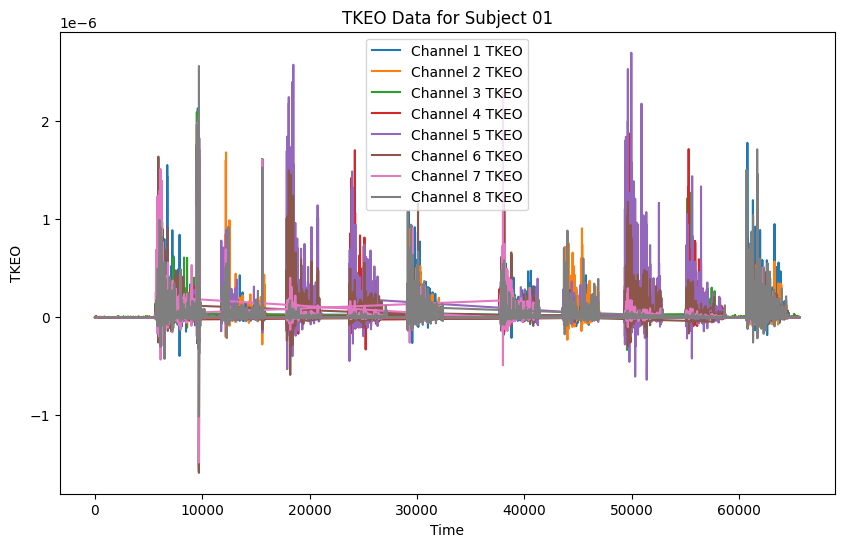

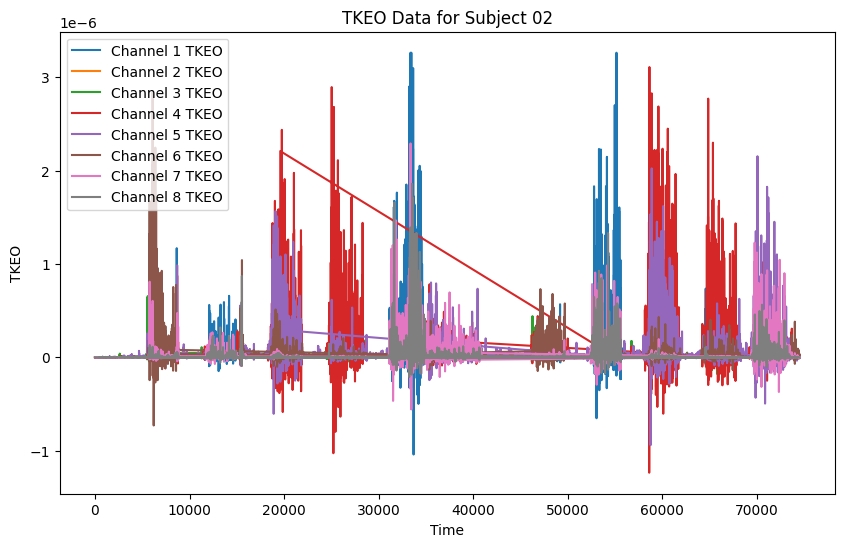

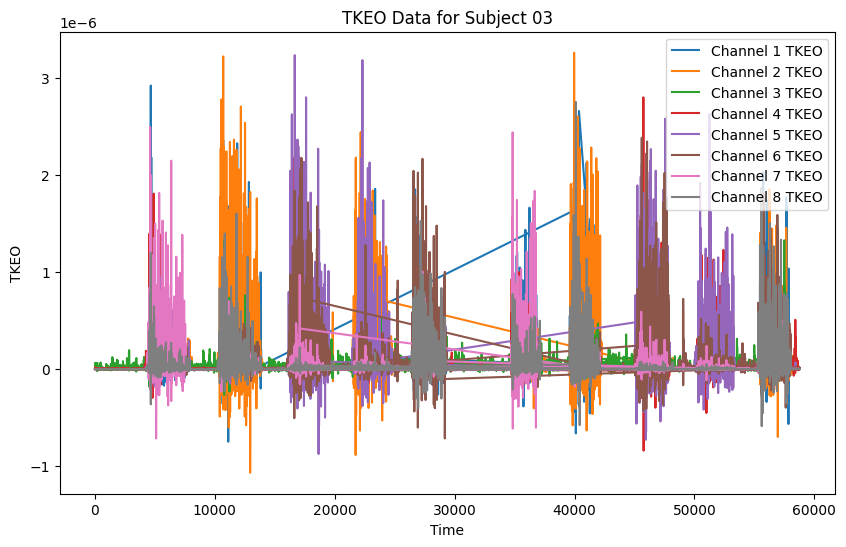

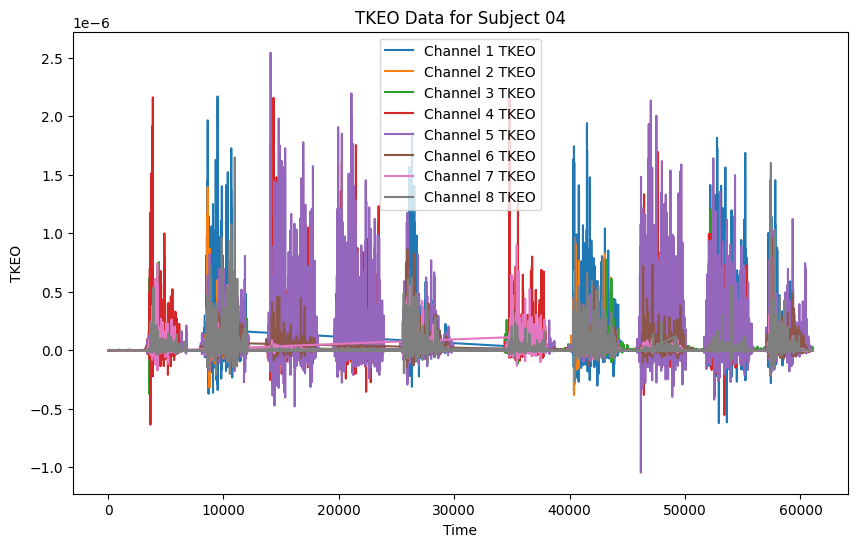

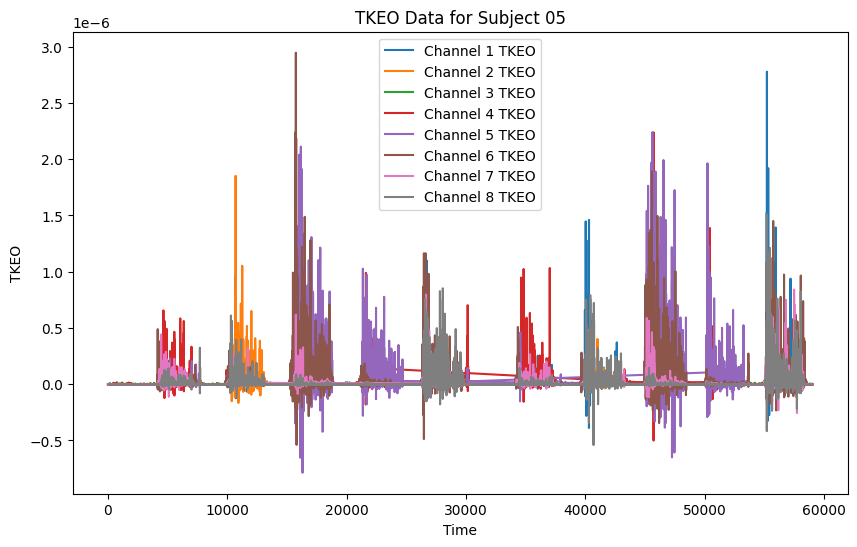

...

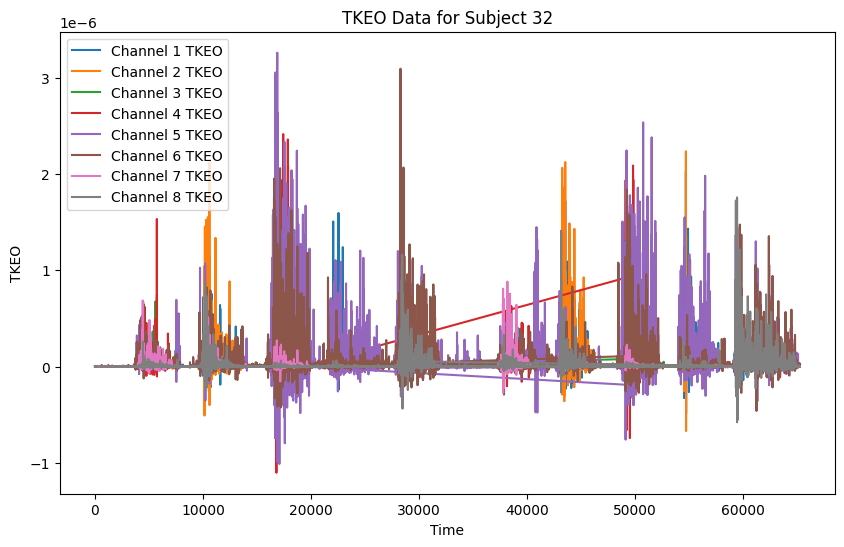

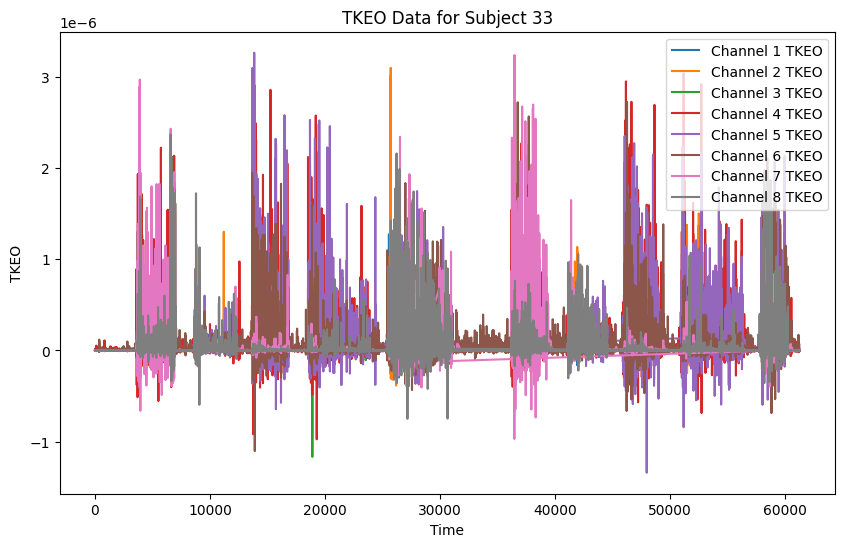

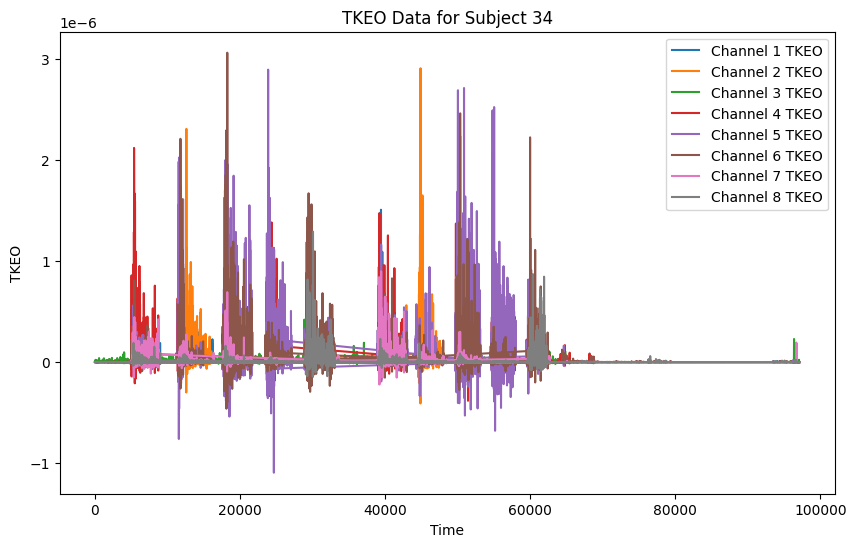

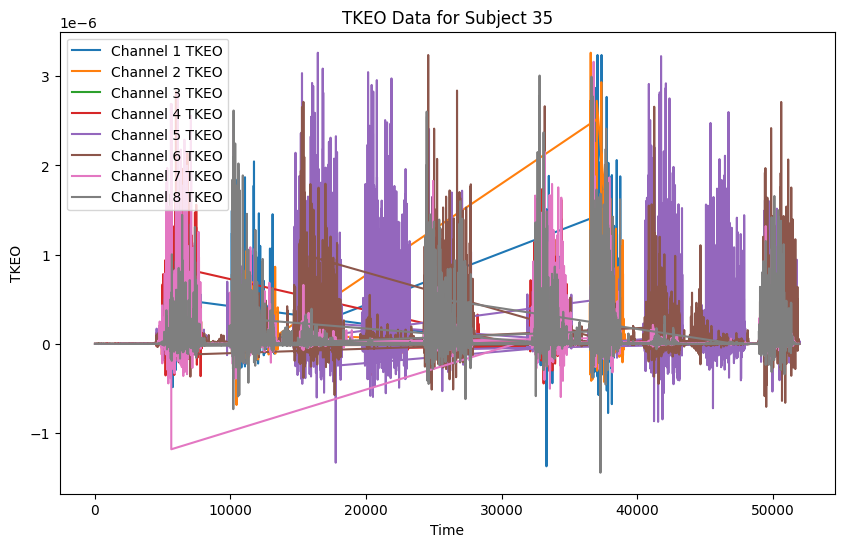

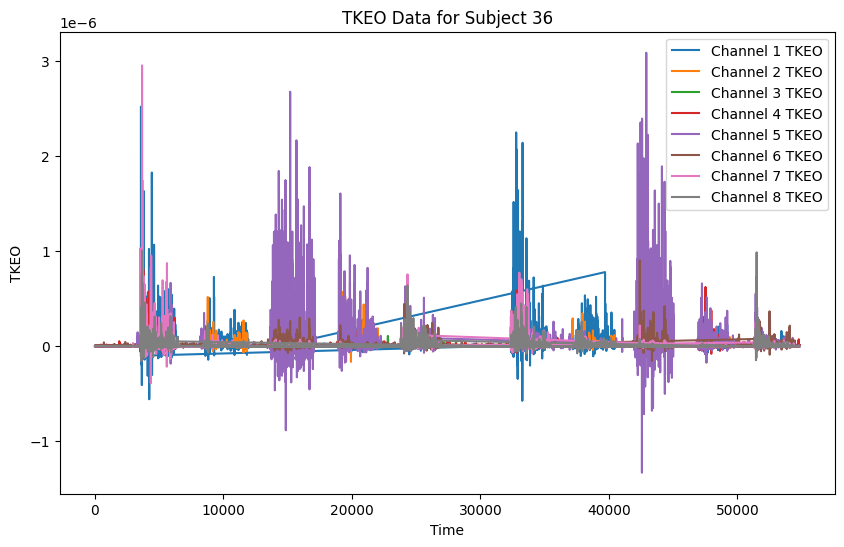

In [ ]:
# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Buscar archivos txt que empiezan con "1_raw_data"
        archivos = [f for f in os.listdir(sujeto_path) if f.startswith("1_raw_data") and f.endswith(".txt")]

        # Crear un dataframe vacío para el sujeto actual
        df_sujeto = pd.DataFrame()

        # Procesar cada archivo encontrado y concatenar los datos en el dataframe del sujeto
        for archivo in archivos:
            archivo_path = os.path.join(sujeto_path, archivo)
            gestos = procesar_archivo(archivo_path)
            for gesto, df_gesto in gestos.items():
                df_sujeto = pd.concat([df_sujeto, df_gesto], ignore_index=True)

        # Graficar los datos TKEO del sujeto
        plt.figure(figsize=(10, 6))
        plt.plot(df_sujeto['time'], df_sujeto['channel1_tkeo'], label='Channel 1 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel2_tkeo'], label='Channel 2 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel3_tkeo'], label='Channel 3 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel4_tkeo'], label='Channel 4 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel5_tkeo'], label='Channel 5 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel6_tkeo'], label='Channel 6 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel7_tkeo'], label='Channel 7 TKEO')
        plt.plot(df_sujeto['time'], df_sujeto['channel8_tkeo'], label='Channel 8 TKEO')
        plt.xlabel('Time')
        plt.ylabel('TKEO')
        plt.title(f'TKEO Data for Subject {sujeto}')
        plt.legend()
        plt.show()

Se crea una función que calcula cada una de las características pedidas a la señla
1. RMS(Root Mean Square): es el cuadrado de los valores que tiene la señal, representa la potencia promedio de la señal
su formula es:
RMS=sqrt( (1/N) * sum(x(n)^2) )
2. Varianza: Mide la dispersión de los valores de la señal al rededor de la media, y en python se puede calcular usando la función de numpy 'var'
3. Mean Absolute Value(MAV): es la medida de la amplitud promedio de la señal.
su formula es:
MAV = (1/N) * sum( |x(n)| )
4. Mean Absolute Value Slope (MAVSlope):Es la medida de la pendiente de la señal en cada punto, básicamente mide la variación de la señal en el tiempo.
su formula es:
MAV Slope = (1 / (N-1)) * sum( |pendiente(n)| )
5. Slope Sing Changes (SSC): Mide la complejidad de la onda de la señal, es decir, saca el número de veces que la pendiente de una señal cambia de forma.
su formula es:

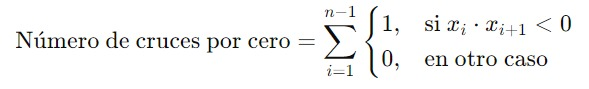
6. Waveform lenght (WL): Mide la duración de la señal.
su formula es:
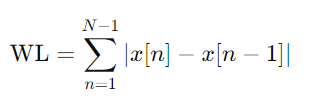
7. Zero Crossing(ZC): Mide la frecuencia de la señal.
Su formula es:
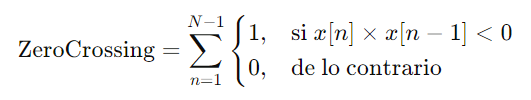

In [ ]:
# Funciones de cálculo de características
def rms(signal):
    return np.sqrt(np.mean(np.square(signal)))

def variance(signal):
    return np.var(signal)

def mav(signal):
    return np.mean(np.abs(signal))

def mavs(signal):
    return np.mean(np.abs(np.diff(signal)))

def ssc(signal):
    return np.sum(np.abs(np.diff(np.sign(np.diff(signal)))))

def wl(signal):
    return np.sum(np.abs(np.diff(signal)))

def zc(signal):
    return np.sum(np.abs(np.diff(np.sign(signal)))) / 2

# Función para aplicar las funciones de cálculo de características a un gesto y crear un DataFrame
def calcular_caracteristicas(gesto, tkeo=False):
    caracteristicas = {}
    for canal in range(1, 9):
        if tkeo:
            canal_nombre = f'channel{canal}_tkeo'
        else:
            canal_nombre = f'channel{canal}'

        canal_data = gesto[canal_nombre]
        caracteristicas[f'RMS_channel{canal}'] = rms(canal_data)
        caracteristicas[f'Variance_channel{canal}'] = variance(canal_data)
        caracteristicas[f'MAV_channel{canal}'] = mav(canal_data)
        caracteristicas[f'MAVS_channel{canal}'] = mavs(canal_data)
        caracteristicas[f'SSC_channel{canal}'] = ssc(canal_data)
        caracteristicas[f'WL_channel{canal}'] = wl(canal_data)
        caracteristicas[f'ZC_channel{canal}'] = zc(canal_data)

    return caracteristicas

# Iterar sobre los gestos y calcular características
def calcular_caracteristicas_gestos(gestos, tkeo=False):
    caracteristicas_gestos = []
    for gesto, datos in gestos.items():
        caracteristicas_gesto = calcular_caracteristicas(datos, tkeo)
        caracteristicas_gestos.append(caracteristicas_gesto)
    return pd.DataFrame(caracteristicas_gestos)

# Iterar sobre las carpetas numeradas
caracteristicas_sin_tkeo = []
caracteristicas_con_tkeo = []

for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Buscar archivos txt que empiezan con "1_raw_data"
        archivos = [f for f in os.listdir(sujeto_path) if f.startswith("1_raw_data") and f.endswith(".txt")]

        # Procesar cada archivo encontrado
        for archivo in archivos:
            archivo_path = os.path.join(sujeto_path, archivo)
            gestos = procesar_archivo(archivo_path)

            # Calcular características sin TKEO
            caracteristicas_sin_tkeo.append(calcular_caracteristicas_gestos(gestos))

            # Calcular características con TKEO
            caracteristicas_con_tkeo.append(calcular_caracteristicas_gestos(gestos, tkeo=True))

# Crear DataFrames para características sin TKEO y con TKEO
df_sin_tkeo = pd.concat(caracteristicas_sin_tkeo, ignore_index=True)
df_con_tkeo = pd.concat(caracteristicas_con_tkeo, ignore_index=True)

# Mostrar los DataFrames resultantes
print("DataFrame Sin TKEO:")
display(df_sin_tkeo)

print("\nDataFrame Con TKEO:")
display(df_con_tkeo)

DataFrame Sin TKEO:


,RMS_channel1,Variance_channel1,MAV_channel1,MAVS_channel1,SSC_channel1,WL_channel1,ZC_channel1,RMS_channel2,Variance_channel2,MAV_channel2,...,SSC_channel7,WL_channel7,ZC_channel7,RMS_channel8,Variance_channel8,MAV_channel8,MAVS_channel8,SSC_channel8,WL_channel8,ZC_channel8
0,0.000138,1.892634e-08,0.000062,0.000010,7234.0,0.40010,1984.0,0.000129,1.663159e-08,0.000065,...,7088.0,0.40477,1848.5,0.000145,2.101997e-08,0.000067,0.000010,7136.0,0.42453,1853.0
1,0.000017,2.018286e-10,0.000013,0.000002,570.0,0.00577,132.0,0.000028,6.987299e-10,0.000022,...,557.0,0.00501,136.5,0.000014,1.289331e-10,0.000011,0.000001,563.0,0.00499,130.5
2,0.000223,4.963748e-08,0.000172,0.000027,657.0,0.09512,183.0,0.000115,1.302498e-08,0.000088,...,633.0,0.08707,172.0,0.000159,2.516906e-08,0.000121,0.000018,639.0,0.06487,195.0
3,0.000185,3.382781e-08,0.000141,0.000019,668.0,0.07369,185.0,0.000227,5.053719e-08,0.000172,...,646.0,0.03085,189.0,0.000160,2.533018e-08,0.000125,0.000017,656.0,0.06454,193.0
4,0.000052,2.604975e-09,0.000040,0.000006,612.0,0.01949,166.0,0.000084,6.970764e-09,0.000063,...,626.0,0.04268,185.0,0.000073,5.244896e-09,0.000056,0.000008,616.0,0.02720,166.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,0.000066,4.275055e-09,0.000050,...,618.0,0.09728,197.0,0.000173,2.999297e-08,0.000140,0.000022,626.0,0.07083,195.0
250,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,0.000106,1.105918e-08,0.000079,...,597.0,0.03133,186.0,0.000081,6.433464e-09,0.000061,0.000011,593.0,0.03268,183.0
251,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,0.000052,2.673553e-09,0.000042,...,624.0,0.03044,178.5,0.000044,1.899229e-09,0.000035,0.000006,618.0,0.01959,184.5
252,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.05410,168.0,0.000143,2.030163e-08,0.000105,...,552.0,0.01349,166.0,0.000035,1.157464e-09,0.000026,0.000004,554.0,0.01246,156.0



DataFrame Con TKEO:


,RMS_channel1,Variance_channel1,MAV_channel1,MAVS_channel1,SSC_channel1,WL_channel1,ZC_channel1,RMS_channel2,Variance_channel2,MAV_channel2,...,SSC_channel7,WL_channel7,ZC_channel7,RMS_channel8,Variance_channel8,MAV_channel8,MAVS_channel8,SSC_channel8,WL_channel8,ZC_channel8
0,4.949705e-08,2.436256e-15,4.238779e-09,NaN,NaN,NaN,NaN,4.706477e-08,2.202584e-15,3.994839e-09,...,NaN,NaN,NaN,5.159659e-08,2.646569e-15,4.592961e-09,NaN,NaN,NaN,NaN
1,2.036246e-10,4.021190e-20,4.505291e-11,7.700450e-11,1150.0,2.910000e-07,338.0,6.175412e-10,3.669635e-19,1.462698e-10,...,1123.0,2.062000e-07,324.5,1.452875e-10,2.042391e-20,3.373016e-11,5.856047e-11,1181.0,2.213000e-07,351.5
2,6.102474e-08,3.624883e-15,1.171336e-08,1.747182e-08,1279.0,6.157070e-05,397.5,1.394133e-08,1.878769e-16,2.870582e-09,...,1245.0,5.259270e-05,390.5,2.615771e-08,6.601893e-16,5.615915e-09,8.235953e-09,1201.0,2.902350e-05,364.5
3,2.883578e-08,8.014632e-16,6.422799e-09,9.658087e-09,1298.0,3.684560e-05,414.0,4.346832e-08,1.820336e-15,9.475393e-09,...,1236.0,6.412800e-06,374.0,2.221483e-08,4.761333e-16,4.738208e-09,6.765557e-09,1282.0,2.581060e-05,397.0
4,2.415744e-09,5.625702e-18,5.387678e-10,7.895349e-10,1196.0,2.716000e-06,364.0,7.663082e-09,5.689424e-17,1.583406e-09,...,1204.0,1.223960e-05,368.0,5.051364e-09,2.468358e-17,1.083697e-09,1.603198e-09,1200.0,5.515000e-06,369.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,1.229119e-07,1.455100e-14,2.798372e-08,4.141390e-08,1167.0,1.340568e-04,367.5,4.215574e-09,1.718516e-17,8.740889e-10,...,1151.0,6.292640e-05,354.5,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,3.107880e-05,372.5
250,4.020941e-08,1.563179e-15,8.440877e-09,1.219961e-08,1127.0,3.756260e-05,354.5,1.175082e-08,1.334402e-16,2.442370e-09,...,1107.0,6.995000e-06,348.5,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,6.765400e-06,345.5
251,1.850992e-09,3.288742e-18,4.300410e-10,6.212121e-10,1146.0,1.968000e-06,354.0,2.763945e-09,7.270514e-18,6.855475e-10,...,1164.0,5.445200e-06,364.0,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,2.214800e-06,352.0
252,2.276129e-08,4.958364e-16,5.403088e-09,7.866903e-09,1072.0,2.215320e-05,343.0,2.193065e-08,4.651187e-16,4.649663e-09,...,986.0,1.236200e-06,303.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,1.198000e-06,308.0


In [ ]:
# Función para calcular características sobre un DataFrame de gestos
def calcular_caracteristicas_por_canal(df_gesto):
    canales = ['channel1', 'channel2', 'channel3', 'channel4', 'channel5', 'channel6', 'channel7', 'channel8']
    caracteristicas = {}
    for canal in canales:
        # Características para datos sin TKEO
        caracteristicas[f'{canal}_rms'] = rms(df_gesto[canal])
        caracteristicas[f'{canal}_variance'] = variance(df_gesto[canal])
        caracteristicas[f'{canal}_mav'] = mav(df_gesto[canal])
        caracteristicas[f'{canal}_mavs'] = mavs(df_gesto[canal])
        caracteristicas[f'{canal}_ssc'] = ssc(df_gesto[canal])
        caracteristicas[f'{canal}_wl'] = wl(df_gesto[canal])
        caracteristicas[f'{canal}_zc'] = zc(df_gesto[canal])
        # Características para datos con TKEO
        caracteristicas[f'{canal}_tkeo_rms'] = rms(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_variance'] = variance(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_mav'] = mav(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_mavs'] = mavs(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_ssc'] = ssc(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_wl'] = wl(df_gesto[f'{canal}_tkeo'])
        caracteristicas[f'{canal}_tkeo_zc'] = zc(df_gesto[f'{canal}_tkeo'])
    return pd.DataFrame(caracteristicas, index=[0])

# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Mostrar el sujeto actual
        print(f"\nSujeto {sujeto}:")

        # Procesar cada DataFrame de gestos para el sujeto actual
        for gesto, df_gesto in gestos.items():
            print(f"\nGesto {gesto}:")
            # Calcular características por canal para datos con y sin TKEO
            df_caracteristicas_por_canal = calcular_caracteristicas_por_canal(df_gesto)
            # Imprimir DataFrame con características por canal
            display(df_caracteristicas_por_canal)



Sujeto 01:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 02:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 03:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 04:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 05:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 06:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 07:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 08:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 09:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 10:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 11:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 12:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 13:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 14:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 15:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 16:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 17:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 18:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 19:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 20:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 21:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 22:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 23:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 24:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 25:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 26:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 27:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 28:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 29:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 30:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 31:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 32:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 33:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 34:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 35:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 36:

Gesto 0:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000136,1.855780e-08,0.000065,0.000011,6124.0,0.36324,1746.5,4.451924e-08,1.968703e-15,4.145405e-09,...,5950.0,0.2342,1603.0,1.754055e-08,3.057039e-16,1.640077e-09,NaN,NaN,NaN,NaN



Gesto 1:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000018,2.675403e-10,0.000014,0.000002,570.0,0.00678,154.0,2.643857e-10,6.706268e-20,6.468266e-11,...,514.0,0.00448,130.0,1.220833e-10,1.436325e-20,2.969936e-11,5.048603e-11,938.0,1.662000e-07,280.0



Gesto 2:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000349,1.220805e-07,0.000268,0.000044,630.0,0.14352,190.0,1.229119e-07,1.455100e-14,2.798372e-08,...,626.0,0.07083,195.0,2.793545e-08,7.469193e-16,6.623749e-09,9.601112e-09,1177.0,0.000031,372.5



Gesto 3:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000192,3.701768e-08,0.000144,0.000024,613.0,0.07505,176.0,4.020941e-08,1.563179e-15,8.440877e-09,...,593.0,0.03268,183.0,6.531037e-09,4.082018e-17,1.539675e-09,2.197272e-09,1111.0,0.000007,345.5



Gesto 4:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000041,1.646240e-09,0.000032,0.000006,618.0,0.01813,186.0,1.850992e-09,3.288742e-18,4.300410e-10,...,618.0,0.01959,184.5,1.902917e-09,3.445692e-18,4.757337e-10,6.991162e-10,1154.0,0.000002,352.0



Gesto 5:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000158,2.485789e-08,0.000121,0.000019,578.0,0.0541,168.0,2.276129e-08,4.958364e-16,5.403088e-09,...,554.0,0.01246,156.0,1.248609e-09,1.501930e-18,2.828186e-10,4.254261e-10,992.0,0.000001,308.0



Gesto 6:


,channel1_rms,channel1_variance,channel1_mav,channel1_mavs,channel1_ssc,channel1_wl,channel1_zc,channel1_tkeo_rms,channel1_tkeo_variance,channel1_tkeo_mav,...,channel8_ssc,channel8_wl,channel8_zc,channel8_tkeo_rms,channel8_tkeo_variance,channel8_tkeo_mav,channel8_tkeo_mavs,channel8_tkeo_ssc,channel8_tkeo_wl,channel8_tkeo_zc
0,0.000107,1.139319e-08,0.000078,0.000014,593.0,0.03866,182.0,1.184596e-08,1.353901e-16,2.510870e-09,...,597.0,0.04628,169.0,1.849131e-08,3.289931e-16,4.012513e-09,5.814580e-09,1117.0,0.000017,350.5



Sujeto 01:

Gesto 0:


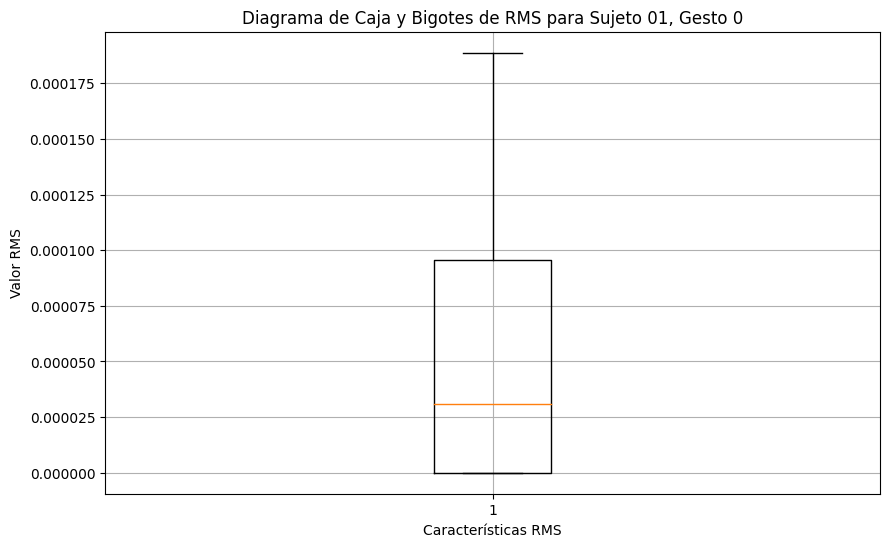


Gesto 1:


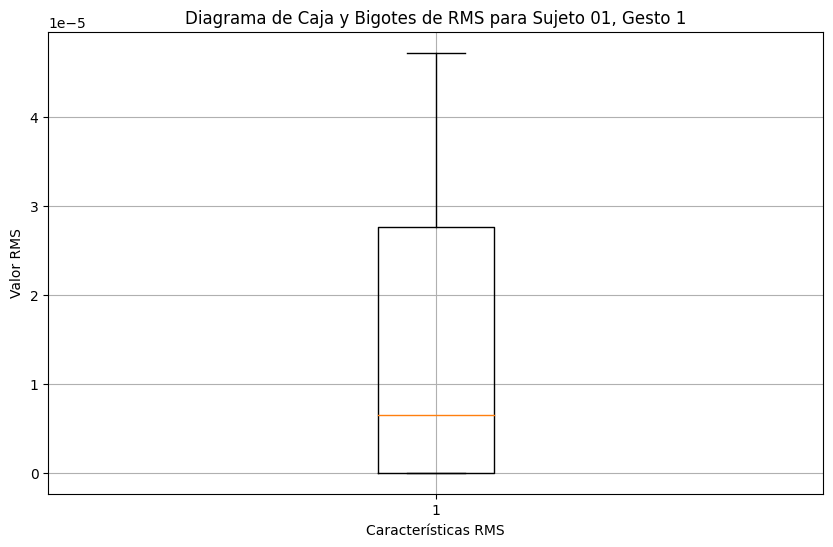


Gesto 2:


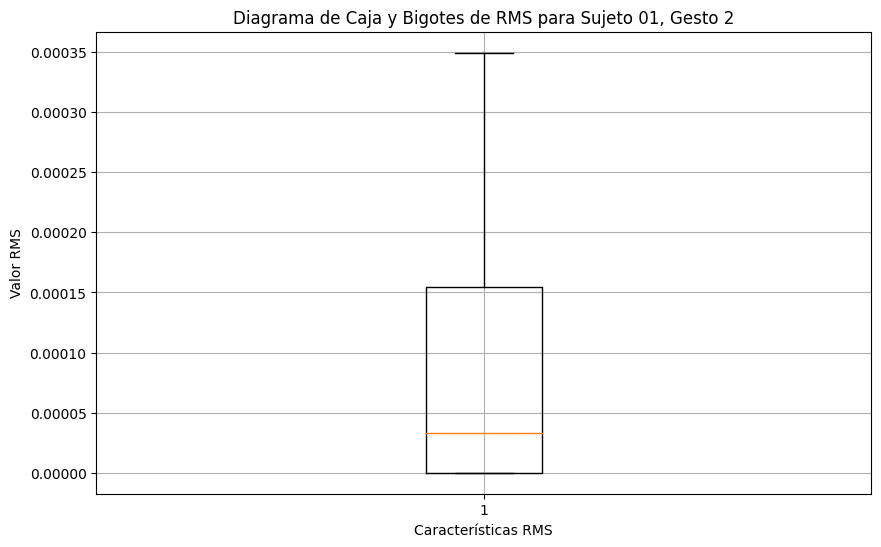


Gesto 3:


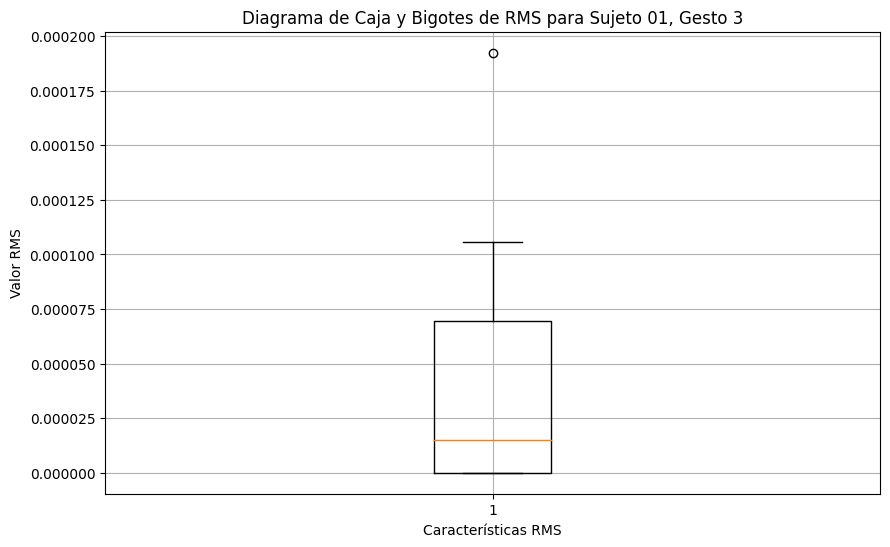


Gesto 4:


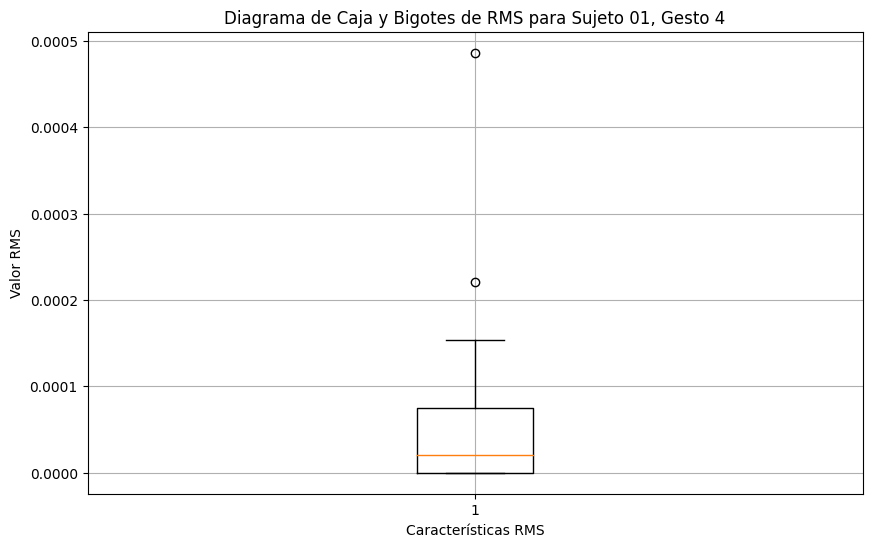


Gesto 5:


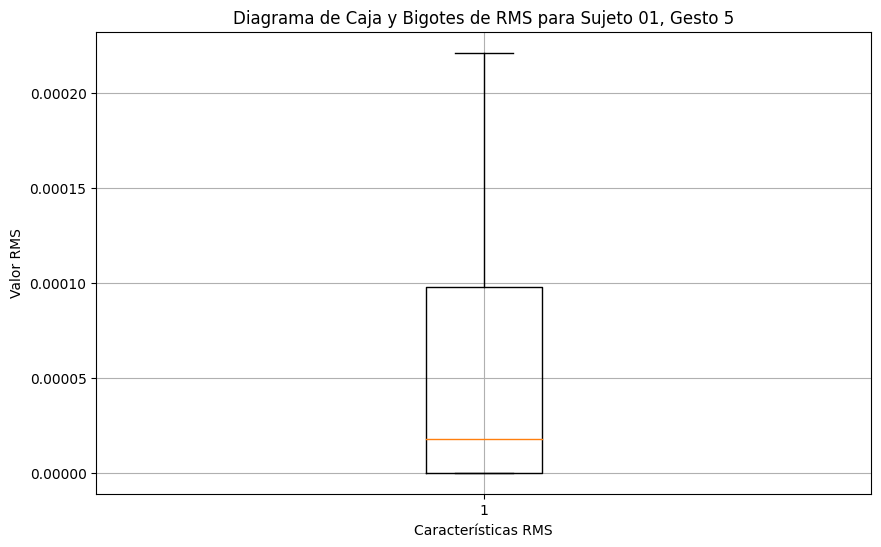


Gesto 6:


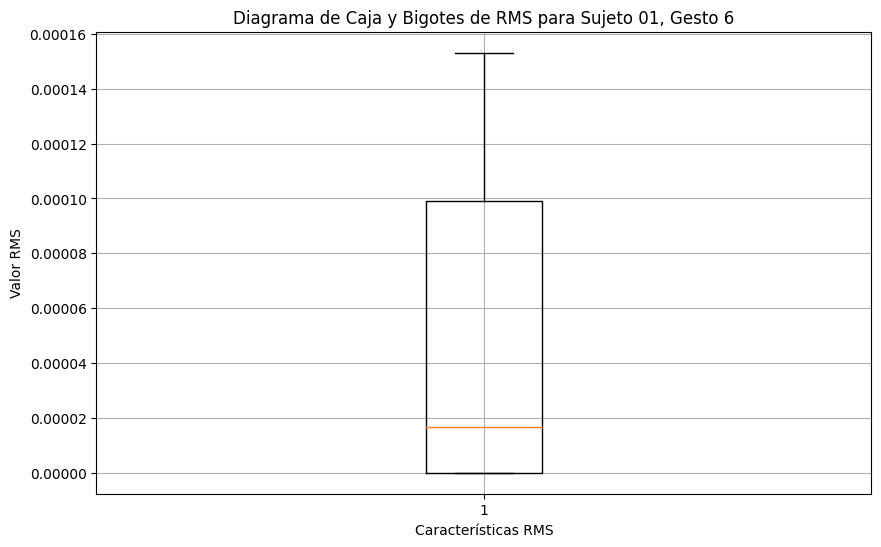


Sujeto 02:

Gesto 0:


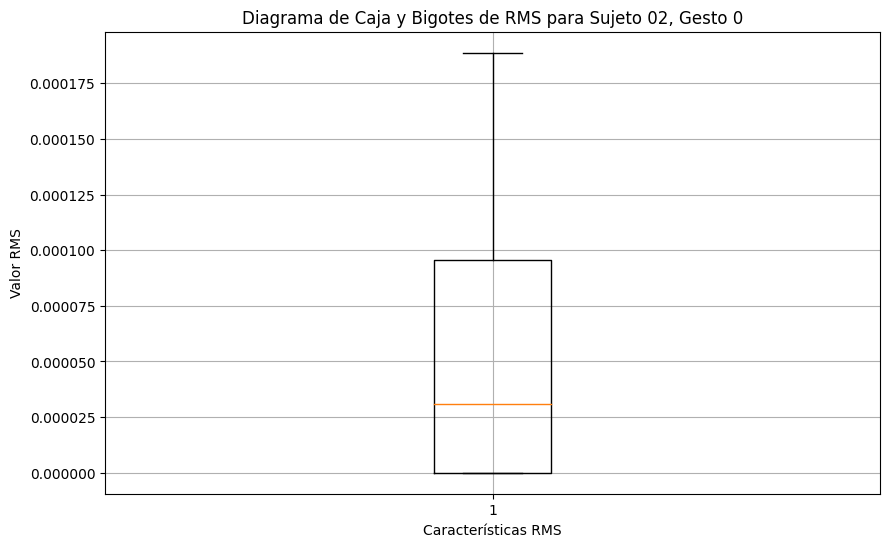


Gesto 1:


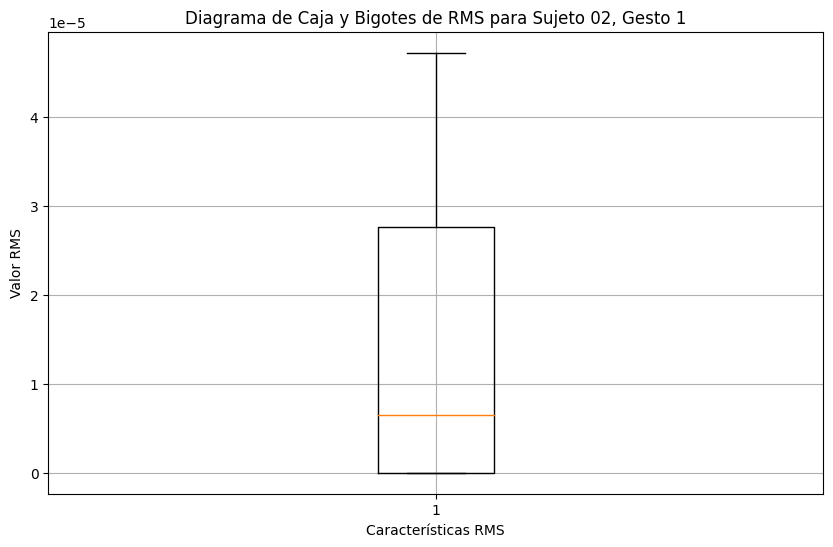


Gesto 2:


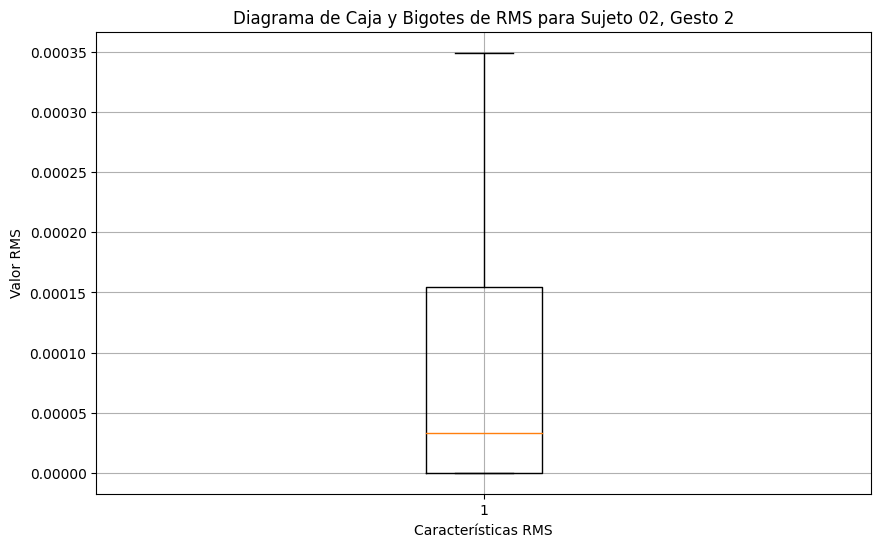


Gesto 3:


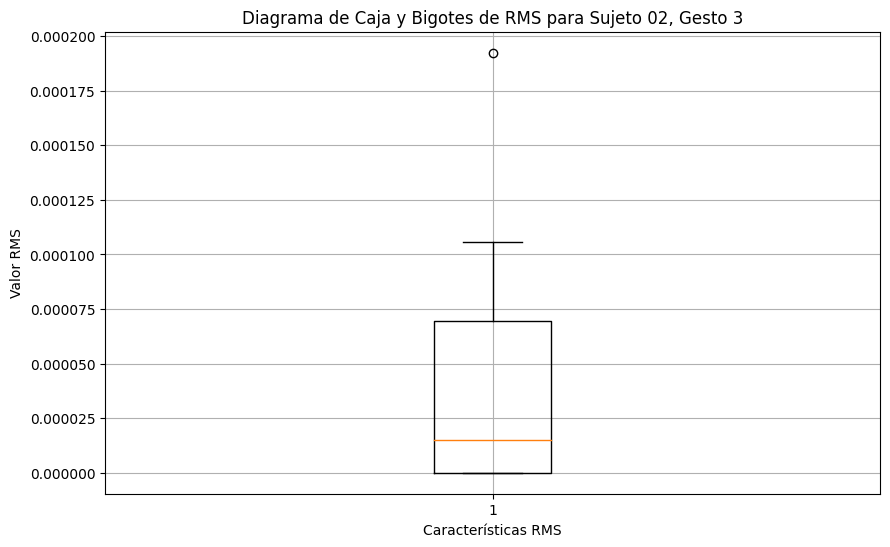


Gesto 4:


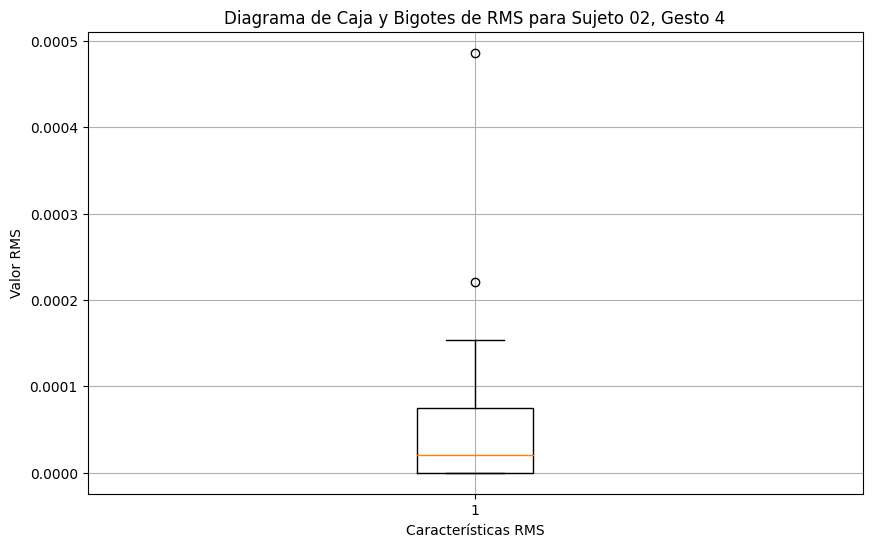


Gesto 5:


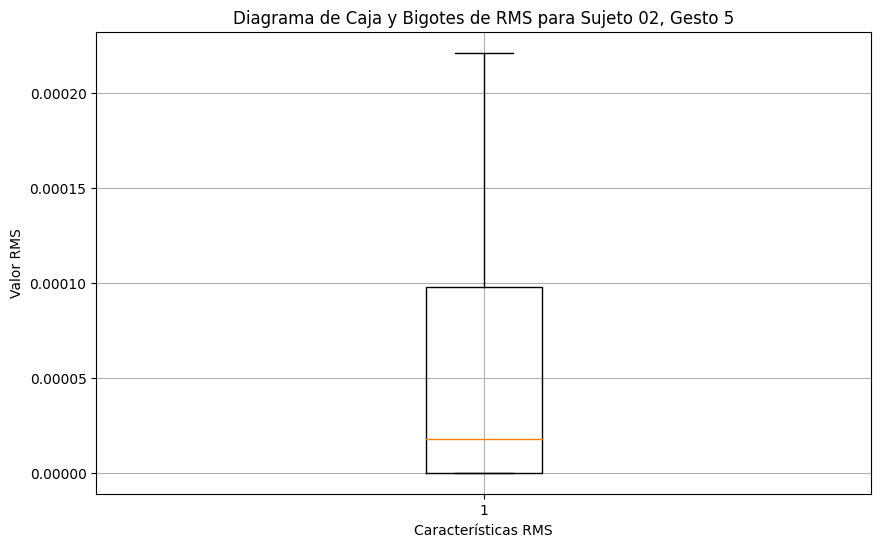


Gesto 6:


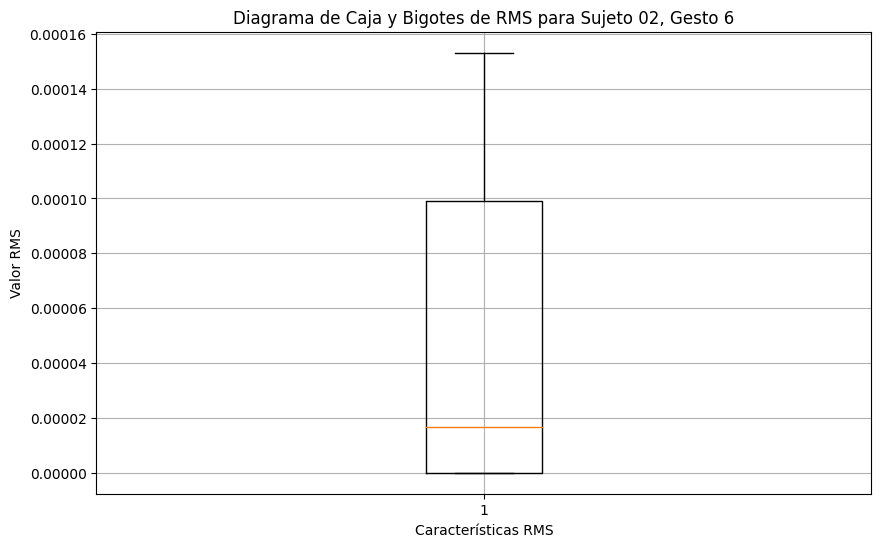

In [ ]:
# Contador de sujetos diferentes encontrados
sujetos_encontrados = 0

# Iterar sobre los subdirectorios en la carpeta principal
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es un subdirectorio
    if os.path.isdir(sujeto_path):
        # Incrementar el contador de sujetos encontrados
        sujetos_encontrados += 1

        # Mostrar el sujeto actual
        print(f"\nSujeto {sujeto}:")

        # Procesar cada DataFrame de gestos para el sujeto actual
        for gesto, df_gesto in gestos.items():
            print(f"\nGesto {gesto}:")
            # Calcular características por canal para datos con y sin TKEO
            df_caracteristicas_por_canal = calcular_caracteristicas_por_canal(df_gesto)

            # Filtrar los datos para el gesto actual terminados en "_rms"
            columnas_rms = [columna for columna in df_caracteristicas_por_canal.columns if columna.endswith('_rms')]
            datos_rms = df_caracteristicas_por_canal[columnas_rms]

            # Graficar los datos del sujeto actual usando un diagrama de caja y bigotes
            plt.figure(figsize=(10, 6))
            plt.boxplot(datos_rms.values.flatten())
            plt.title(f'Diagrama de Caja y Bigotes de RMS para Sujeto {sujeto}, Gesto {gesto}')
            plt.xlabel('Características RMS')
            plt.ylabel('Valor RMS')
            plt.grid(True)
            plt.show()

        # Verificar si se han encontrado suficientes sujetos
        if sujetos_encontrados >= 2:
            break

En el caso del RMS, se mide la amplitud de la señal, un valor de RMS más alto indica que hay mayor amplitud en la señal, por lo tanto se observa como se comporta la amplitud en el caso del gesto 0 del sujeto 1 en comparación con el gesto 0 del sujeto 2, la caja en el diagrama de caja y bigotes representa la dispersión de los datos, es decir la variabilidad de la amplitud en el gesto de estudio. Se puede observar que la mediana de la señal con RMS  del gesto 0 es aproximadamente de 0.000027, tanto para el sujeto 1 como el sujeto dos, en ambos casos también la linea media se encuentra hacía lo izquierda lo que indica una distribución sesgada hacía la derecha .

Como se puede observar, todas las gráficas de cajas y bigotes se comportan igual para ambos sujetos en cada gesto, el hecho de que la mediana de la amplitud RMS sea similar para ambos sujetos sugiere que, en promedio, la amplitud de las contracciones musculares en el gesto 0 es comparable entre los dos sujetos. Además se presenta una distribución sesgada hacia la derecha en todos los sujetos indicando una distribución que no es normal, pero que se comporta de forma similar.


**Análisis caja y bigotes:**

In [ ]:
# Función para aplicar la prueba de Shapiro a cada columna
def shapiro_test(data):
    results = {}
    for column in data.columns:
        stat, p = shapiro(data[column])
        normal = p > 0.05
        results[column] = {'Statistic': stat, 'p-value': p, 'Normal': normal}
    return pd.DataFrame(results).T

# Iterar sobre los gestos y aplicar la prueba de Shapiro a los datos sin TKEO
for gesto, df_gesto in gestos.items():
    print(f"\nGesto {gesto}:")
    shapiro_results = shapiro_test(df_gesto)
    display(shapiro_results)


Gesto 0:


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


,Statistic,p-value,Normal
time,0.954177,0.0,False
channel1,0.679129,0.0,False
channel2,0.802071,0.0,False
channel3,0.87397,0.0,False
channel4,0.803349,0.0,False
channel5,0.786343,0.0,False
channel6,0.862629,0.0,False
channel7,0.658459,0.0,False
channel8,0.693985,0.0,False
channel1_tkeo,NaN,1.0,True



Gesto 1:


,Statistic,p-value,Normal
time,0.66567,0.0,False
channel1,0.954513,0.0,False
channel2,0.972528,0.0,False
channel3,0.979721,0.0,False
channel4,0.96442,0.0,False
channel5,0.987845,0.0,False
channel6,0.973596,0.0,False
channel7,0.944495,0.0,False
channel8,0.916984,0.0,False
channel1_tkeo,0.295051,0.0,False



Gesto 2:


,Statistic,p-value,Normal
time,0.665863,0.0,False
channel1,0.987807,0.0,False
channel2,0.982705,0.0,False
channel3,0.982511,0.0,False
channel4,0.980108,0.0,False
channel5,0.994217,0.0,False
channel6,0.961405,0.0,False
channel7,0.949131,0.0,False
channel8,0.99479,0.0,False
channel1_tkeo,0.265461,0.0,False



Gesto 3:


,Statistic,p-value,Normal
time,0.665878,0.0,False
channel1,0.9762,0.0,False
channel2,0.96307,0.0,False
channel3,0.974332,0.0,False
channel4,0.959441,0.0,False
channel5,0.919993,0.0,False
channel6,0.978711,0.0,False
channel7,0.984656,0.0,False
channel8,0.979269,0.0,False
channel1_tkeo,0.231878,0.0,False



Gesto 4:


,Statistic,p-value,Normal
time,0.665967,0.0,False
channel1,0.985169,0.0,False
channel2,0.993191,0.0,False
channel3,0.986272,0.0,False
channel4,0.977971,0.0,False
channel5,0.993791,0.0,False
channel6,0.976336,0.0,False
channel7,0.988602,0.0,False
channel8,0.98913,0.0,False
channel1_tkeo,0.268067,0.0,False



Gesto 5:


,Statistic,p-value,Normal
time,0.663788,0.0,False
channel1,0.983588,0.0,False
channel2,0.96036,0.0,False
channel3,0.992228,0.0,False
channel4,0.987347,0.0,False
channel5,0.973241,0.0,False
channel6,0.987182,0.0,False
channel7,0.986075,0.0,False
channel8,0.959124,0.0,False
channel1_tkeo,0.279573,0.0,False



Gesto 6:


,Statistic,p-value,Normal
time,0.664912,0.0,False
channel1,0.970658,0.0,False
channel2,0.92456,0.0,False
channel3,0.985794,0.0,False
channel4,0.983204,0.0,False
channel5,0.983396,0.0,False
channel6,0.978316,0.0,False
channel7,0.97446,0.0,False
channel8,0.961729,0.0,False
channel1_tkeo,0.233559,0.0,False


**Análisis Shapiro:** Se realizó la prueba de Shapiro para determinar la normalidad de las señales correspondientes a cada gesto y a cada característica medida. En esta prueba, la hipótesis nula (H0) plantea que los datos no siguen una distribución normal, mientras que la hipótesis alternativa (H1) sugiere que los datos no se distribuyen normalmente. Los resultados de las pruebas para cada gesto y característica mostraron un valor de p menor que el nivel de significancia establecido en 0.05, lo que indica que se rechaza la hipótesis nula. Es decir, los datos no exhiben una distribución normal.

Esto se puede dar por la naturaleza de las señales de electromiografía (EMG), donde los potenciales son específicos para cada canal (electrodo), es decir, para cada zona del músculo dependiendo del gesto, y también pueden variar según el sujeto. Factores como la fuerza muscular, la fatiga, la posición del músculo, la edad del sujeto, entre otros, pueden influir en la actividad muscular, generando variaciones en amplitud y frecuencia.

Además, las variaciones en la toma de datos, junto con la presencia de artefactos no considerados, pueden introducir ruido en las señales, afectando su distribución. Por lo tanto, los resultados de la prueba de Shapiro indican que los datos no cumplen con los supuestos de normalidad necesarios para realizar pruebas paramétricas. Por ende, se opta por utilizar pruebas no paramétricas para el análisis de los datos.

In [ ]:
def calcular_caracteristicas_por_canal(df_gesto):
    canales = ['channel1', 'channel2', 'channel3', 'channel4', 'channel5', 'channel6', 'channel7', 'channel8']
    caracteristicas = {}
    for canal in canales:
        # Características para datos sin TKEO
        caracteristicas[f'{canal}_rms'] = rms(df_gesto[canal])
        # Características para datos con TKEO
        caracteristicas[f'{canal}_tkeo_rms'] = rms(df_gesto[f'{canal}_tkeo'])
    return pd.DataFrame(caracteristicas, index=[0])

# Función para realizar la prueba de Levene y Mann-Whitney U
def comparar_caracteristicas(df_caracteristicas_por_canal):
    # Comparar las características de channel1_rms con channel1_tkeo_rms
    estadisticos_levene = levene(df_caracteristicas_por_canal['channel1_rms'], df_caracteristicas_por_canal['channel1_tkeo_rms'])
    estadisticos_mannwhitneyu = mannwhitneyu(df_caracteristicas_por_canal['channel1_rms'], df_caracteristicas_por_canal['channel1_tkeo_rms'])

    # Mostrar los resultados
    print("Prueba de Levene:")
    if estadisticos_levene.pvalue > 0.05:
        print("No hay diferencias significativas entre las varianzas.")
    else:
        print("Hay diferencias significativas entre las varianzas.")
    print(f"Estadístico de Levene: {estadisticos_levene.statistic}")
    print(f"P-valor de Levene: {estadisticos_levene.pvalue}")

    print("\nPrueba de Mann-Whitney U:")
    if estadisticos_mannwhitneyu.pvalue > 0.05:
        print("No hay diferencias significativas entre las distribuciones de los datos.")
    else:
        print("Hay diferencias significativas entre las distribuciones de los datos.")
    print(f"Estadístico de Mann-Whitney U: {estadisticos_mannwhitneyu.statistic}")
    print(f"P-valor de Mann-Whitney U: {estadisticos_mannwhitneyu.pvalue}")

# Iterar sobre las carpetas numeradas
for sujeto in sorted(os.listdir(main_folder)):
    sujeto_path = os.path.join(main_folder, sujeto)

    # Verificar si es una carpeta numerada
    if os.path.isdir(sujeto_path) and sujeto.isdigit():
        # Mostrar el sujeto actual
        print(f"\nSujeto {sujeto}:")

        # Procesar cada DataFrame de gestos para el sujeto actual
        for gesto, df_gesto in gestos.items():
            print(f"\nGesto {gesto}:")
            # Calcular características por canal para datos con y sin TKEO
            df_caracteristicas_por_canal = calcular_caracteristicas_por_canal(df_gesto)
            # Realizar comparación de características
            comparar_caracteristicas(df_caracteristicas_por_canal)


Sujeto 01:

Gesto 0:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Gesto 1:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Gesto 2:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Gesto 3:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Leven

/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:3189: RuntimeWarning: invalid value encountered in scalar divide
  W = numer / denom




Gesto 5:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Gesto 6:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Sujeto 02:

Gesto 0:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Levene: nan
P-valor de Levene: nan

Prueba de Mann-Whitney U:
No hay diferencias significativas entre las distribuciones de los datos.
Estadístico de Mann-Whitney U: 1.0
P-valor de Mann-Whitney U: 1.0

Gesto 1:
Prueba de Levene:
Hay diferencias significativas entre las varianzas.
Estadístico de Leve

**Análisis Levenne y Mann-Withney:** Se procedió a analizar la prueba de Levene, la cual se emplea para evaluar si las varianzas de dos o más grupos de datos son iguales. Se utilizó el mismo nivel de significancia (0.05) previamente establecido, realizando una comparación entre los gestos con y sin la aplicación del Teager-Kaiser Energy Operator (TKEO). En caso de que el valor p obtenido sea mayor que el nivel de significancia, se concluye que no existe evidencia suficiente para rechazar la hipótesis nula, la cual sostiene la igualdad de varianzas entre los grupos. Las hipótesis para esta prueba incluyen una hipótesis nula (H0), donde se afirma que las varianzas de los grupos son iguales (homogeneidad de varianzas), y una hipótesis alternativa (Ha), que sugiere que al menos una de las varianzas de los grupos es diferente (heterogeneidad de varianzas). Para nuestros datos, se observó una inconsistencia en los resultados, ya que en ocasiones se detectó una diferencia significativa entre las varianzas, mientras que en otras no.

Asimismo, se aplicó la prueba de Mann-Whitney, utilizada para comparar muestras independientes que no siguen una distribución normal, con el fin de determinar si una muestra tiene valores significativamente diferentes. El valor de p se calculó mediante la función mannwhitneyu y se comparó con el nivel de significancia establecido (0.05). En caso de que el valor p sea menor que el nivel de significancia, se rechaza la hipótesis nula, lo que sugiere una diferencia significativa entre las muestras. En el análisis realizado sobre los gestos en las señales de EMG, el valor de p resultó ser mayor que la significancia establecida, lo que nos lleva a aceptar la hipótesis nula y concluir que no hay una diferencia significativa entre los gestos.


**Conclusiones:** Los datos de la señal EMG no distribuyen de forma normal, lo que requiere una prueba de normalidad, como la prueba de min-max, para ordenar y visualizar los datos de manera más efectiva.
El operador TKEO es esencial para el análisis de señales como la EMG, ya que amplifica la sensibilidad a los cambios bruscos de energía, facilitando la detección de contracciones musculares, y resalta componentes de alta frecuencia para identificar la fatiga muscular.
La gráfica de cajas y bigotes es útil para visualizar la dispersión y detectar valores atípicos, proporcionando una rápida identificación de la variabilidad y simetría de la distribución de los datos.
El histograma ofrece una representación detallada de la distribución de frecuencias de los datos, revelando patrones de agrupación y densidad en diferentes rangos de valores.
Al comparar la precisión de los valores aproximados de la media y la mediana calculados por Python, se observa que la gráfica de cajas y bigotes es más precisa para representar la mediana que el histograma, lo que la hace más confiable en este contexto.
Los datos sin normalizar presentan problemas de dispersión, lo que dificulta su visualización y análisis. Por lo tanto, se concluye que la normalización de los datos es necesaria para un estudio adecuado.

**Bibliografía:**
[1] E. Altamira, M. Mayorga y G. Paredes. “Electromiograma (EMG)”. https://www.researchgate.net/. Disponible: https://www.researchgate.net/profile/Eladio-Altamira-Colado/publication/319902318_Electromiograma_EMG/links/59c0cf0ca6fdcca8e572badd/Electromiograma-EMG.pdf

[2] “The effect of weight-bearing exercise and non-weight-bearing exercise on gaitin rats with sciatic nerve crush injury”. PubMed Central (PMC). Disponible: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4434004/

[3]M. Wrobel. “Normalización de la base de datos: Qué es, por qué es importante y cómo se hace”. The Service Desk and IT Service Management blog.Disponible: https://blog.invgate.com/es/normalizacion-de-base-de-datos#:~:text=¿Cómo%20normalizar%20un%20conjunto%20de,o%20la%20normalización%20Z-score.

[4]“R para principiantes”. Home | Bookdown.Disponible: https://bookdown.org/jboscomendoza/r-principiantes4/data-frames.html